# This script is organized as the following:
## 1) Data cleaning
## 2) Data exploration
## 3) Statistical testing
### 3.1) Stationary test
### 3.2) ACF/PACF plots
## 4) Model building
## 5) Forecasting

#### NOTE: If you want to quickly see the overview, just go to the end and read the summary

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd

import datetime

import matplotlib.pyplot as plt
import pylab
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6

import statsmodels.api as sm  
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller, acf, pacf, q_stat
from statsmodels.graphics.gofplots import qqplot

from sklearn.metrics import mean_squared_error
from math import sqrt

# Step 1) Data cleaning
### - Date column is not in date format
### - Some dates are missing, i.e. category L only has half of the dates
### - Note: we are going to forecast 90 days ahead, so our basic unit is day not hours. So we will group the data into daily sales

In [2]:
np.random.seed(42)
data = pd.read_csv('../data/siteA.csv')

In [3]:
data['Date_Name'] = data['Date_Name'].apply(lambda x: datetime.datetime.strptime(x,'%Y-%m-%d'))

In [4]:
print data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66160 entries, 0 to 66159
Data columns (total 4 columns):
Date_Name        66160 non-null datetime64[ns]
subCategory      66160 non-null object
Purchase_Hour    66160 non-null int64
sales            66160 non-null float64
dtypes: datetime64[ns](1), float64(1), int64(1), object(1)
memory usage: 2.0+ MB
None


In [5]:
# Make a dataframe for each category, and put it into a list...len(list) = 16
# Essentially becomes a list of dataframe

def make_dataframe(df, lis):
    f = lambda x: df[df['subCategory'] == x]
    return map(f, lis)

temp_list = data['subCategory'].unique()
splitted_data = make_dataframe(data, temp_list)
print len(splitted_data)
print splitted_data[2][0:5]

16
      Date_Name subCategory  Purchase_Hour   sales
9259 2016-03-01           C              7  460.34
9260 2016-03-04           C              7  414.03
9261 2016-03-07           C              7  370.37
9262 2016-03-08           C              7  368.68
9263 2016-03-11           C              7  439.15


In [6]:
# Looks like some have missing dates, like category L has only half of the dates.

idx = pd.date_range('09-26-2015', '09-30-2016')

for i, item in enumerate(temp_list):
    splitted_data[i] = splitted_data[i].groupby(by=['Date_Name'])['sales'].sum()
    print item, ':', splitted_data[i].shape
    
    # We fill in the missing dates with value 0. Because this may be holiday and the shop made 0 sales.
    splitted_data[i].index = pd.DatetimeIndex(splitted_data[i].index)
    splitted_data[i] = splitted_data[i].reindex(idx, method='pad')
    # splitted_data[i] = splitted_data[i].interpolate(method='spline', order=2)
    # splitted_data[i] = splitted_data[i].ffill()
    print item, ':', splitted_data[i].shape, '-', splitted_data[i].index

print '\n', splitted_data[0].head()

A : (345,)
A : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
B : (345,)
B : (371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')
C : (345,)
C : (371,) - DatetimeIndex(['2015-09-26',

In [8]:
splitted_data[10] = splitted_data[10].bfill()

In [9]:
# Check for both zero values and NA values.

print map(lambda df: df[df==0].shape, splitted_data)
print map(lambda df: df.isnull().values.sum(), splitted_data)

[(0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,), (0,)]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]


# Step 2) Data exploratory
### - We observe shop has no sales during Xmas season, Dec end~Jan beginning
### - Low sales volume during summer, May~Sep
### - Weekly seasonal effect: weekend usually lower sales volume than weekday
### - Category M has some anomalies in the summer
### - Category L are only sold half of the time in the whole year
### - Maybe it's a shop in a college cafeteria? Low student volume during the weekend, Xmas, & summer.

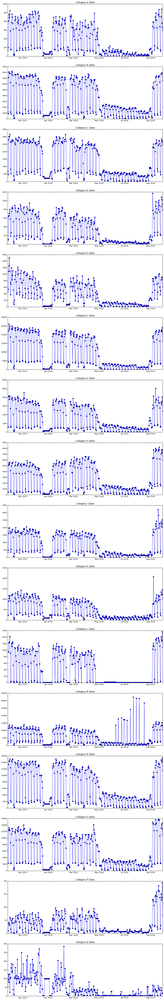

In [10]:
# Time series in connected point plot format for each category.
# We can see the missing dates(or date with 0 sales) in the time series this way

fig, axs = plt.subplots(16,1, figsize=(15, 96))
axs = axs.ravel()

for i, item in enumerate(data['subCategory'].unique()):
    axs[i].plot(splitted_data[i].index, splitted_data[i], '-o')
    axs[i].set_title('Category {} Sales'.format(item))
#     axs[i].set_ylim(0, 10)

In [ ]:
# Seasonal decomposition plots. Let's confirm the weekly seasonality.

def decomposition(timeseries, item):
    decomposition = seasonal_decompose(timeseries, freq=7)
    fig = plt.figure()  
    fig = decomposition.plot()  
    fig.set_size_inches(15, 8)
    fig.suptitle('Category {} - Seasonal Decomposition Plot'.format(item))

_ = map(decomposition, splitted_data, temp_list)

### - We can definitely see the weekly effect in the above graphs.
# Step 3) Statistical Testing
### - We will test the time series for stationarity
### - Transform them so they become stationary
### - Detrend them
### - Take care of the weekly seasonality observed previously

# Step 3.1) Stationarity Test

In [11]:
# We will use Dickey-Fuller Test to check the stationarity of our time series data.

def test_stationarity(timeseries, item):
    
    # Determing rolling statistics
    rol_mean = pd.rolling_mean(timeseries, window=12)
    rol_std = pd.rolling_std(timeseries, window=12)

    # Plot rolling statistics:
    original = plt.plot(timeseries, color='blue',label='Original')
    mean_ = plt.plot(rol_mean, color='red', label='Rolling Mean')
    std_ = plt.plot(rol_std, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Category {} - Rolling Mean & Standard Deviation'.format(item))
    plt.show(block=False)
    
    # Perform Dickey-Fuller test:
    print 'Results of Dickey-Fuller Test:'
    adf_test = adfuller(timeseries, autolag='AIC')
    adf_output = pd.Series(adf_test[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    
    for key,value in adf_test[4].items():
        adf_output['Critical Value (%s)'%key] = value
    print adf_output

In [29]:
def test_statistic(timeseries):
    adf_test = adfuller(timeseries, autolag='AIC')
    return adf_test[0]

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


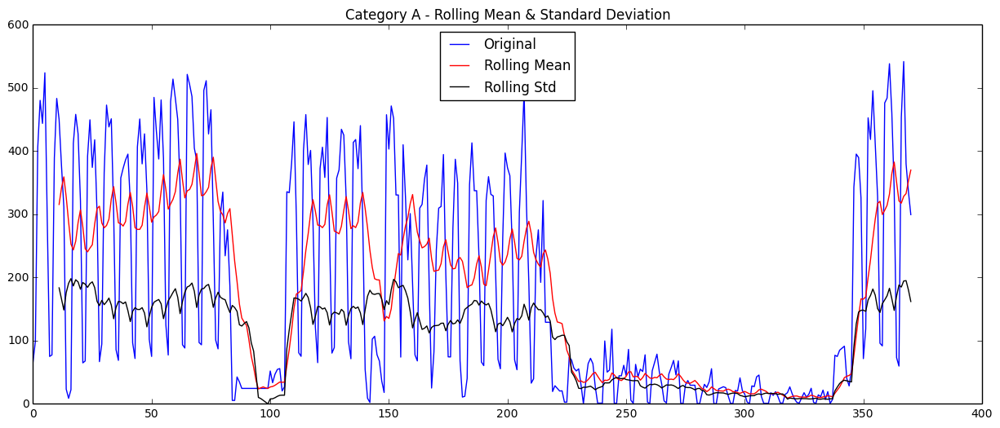

Results of Dickey-Fuller Test:
Test Statistic                  -2.197516
p-value                          0.207148
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


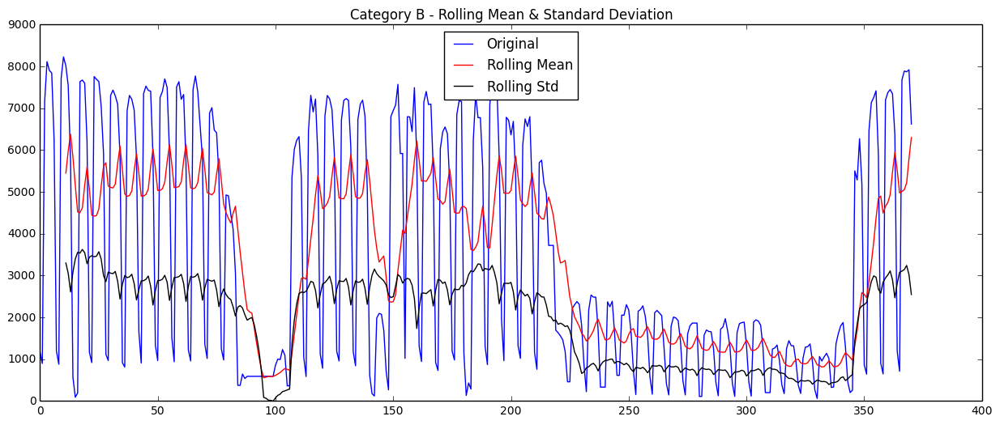

Results of Dickey-Fuller Test:
Test Statistic                  -2.303458
p-value                          0.170855
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


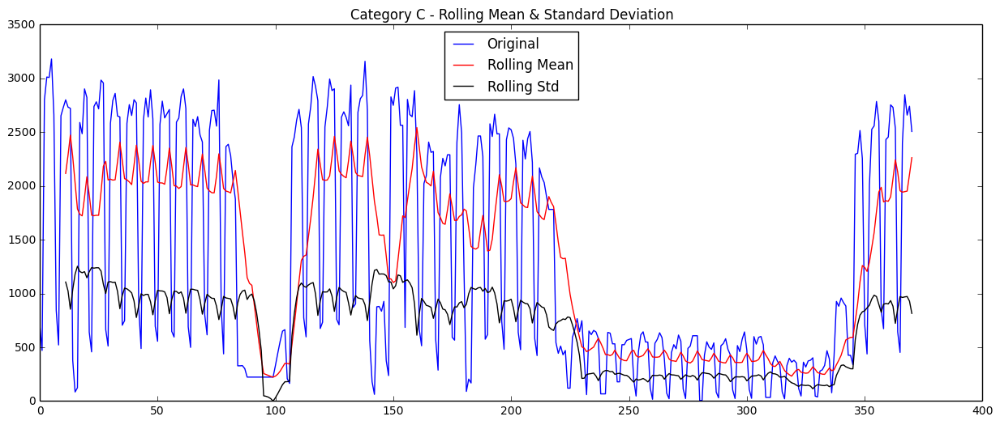

Results of Dickey-Fuller Test:
Test Statistic                  -2.202920
p-value                          0.205187
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


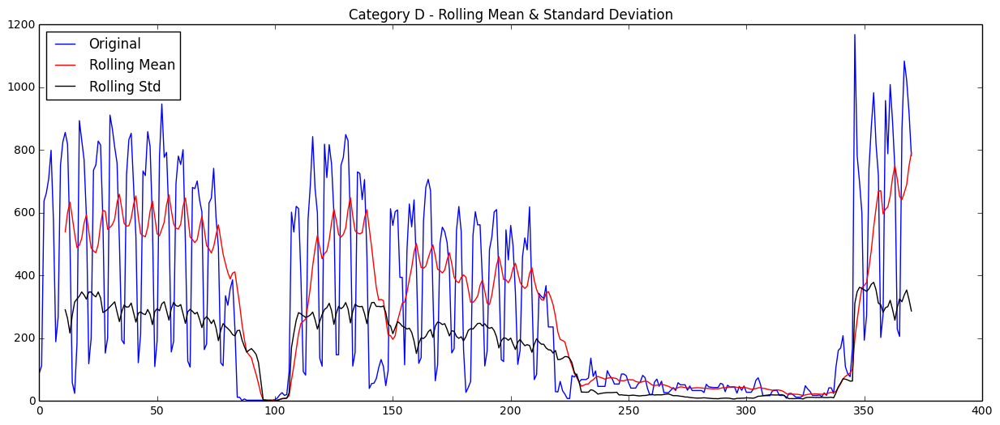

Results of Dickey-Fuller Test:
Test Statistic                  -2.163959
p-value                          0.219585
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


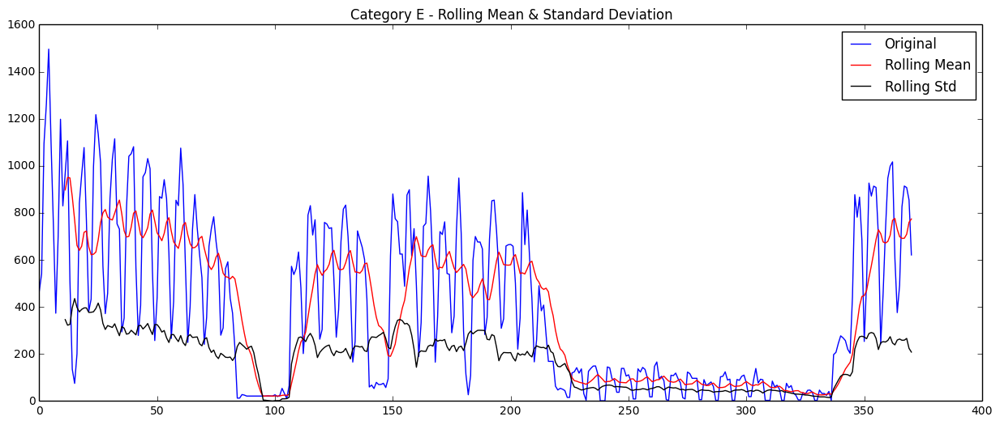

Results of Dickey-Fuller Test:
Test Statistic                  -2.014768
p-value                          0.280136
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


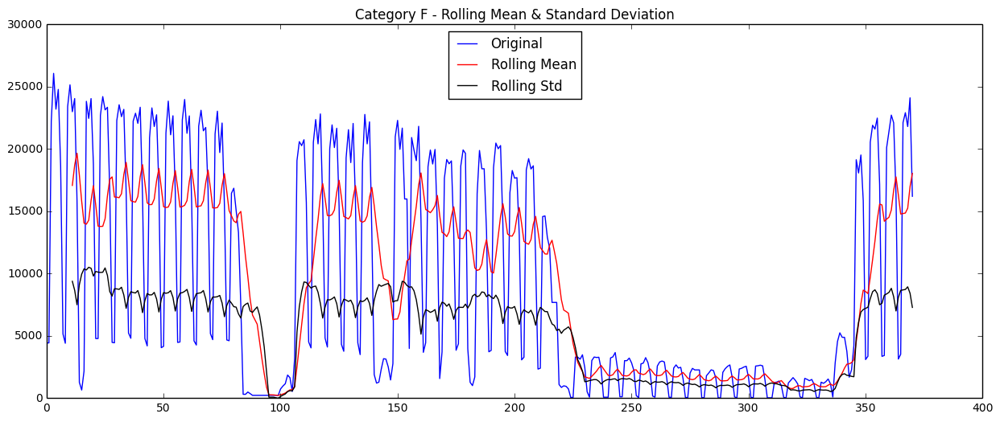

Results of Dickey-Fuller Test:
Test Statistic                  -2.223854
p-value                          0.197702
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


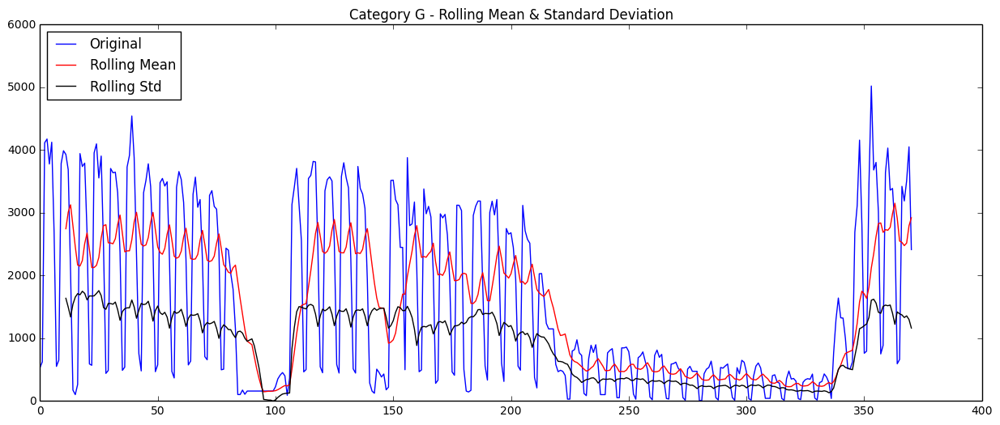

Results of Dickey-Fuller Test:
Test Statistic                  -2.290468
p-value                          0.175061
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


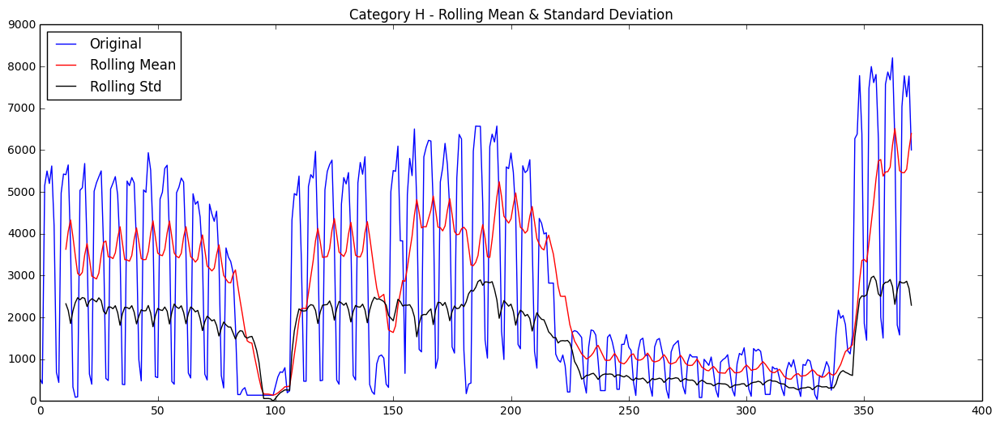

Results of Dickey-Fuller Test:
Test Statistic                  -2.165851
p-value                          0.218872
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


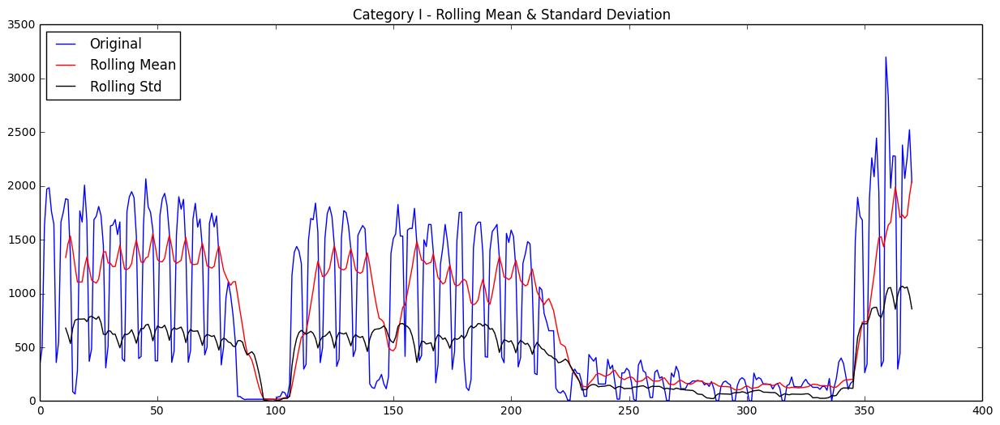

Results of Dickey-Fuller Test:
Test Statistic                  -2.315436
p-value                          0.167038
#Lags Used                       7.000000
Number of Observations Used    363.000000
Critical Value (5%)             -2.869535
Critical Value (1%)             -3.448494
Critical Value (10%)            -2.571029
dtype: float64


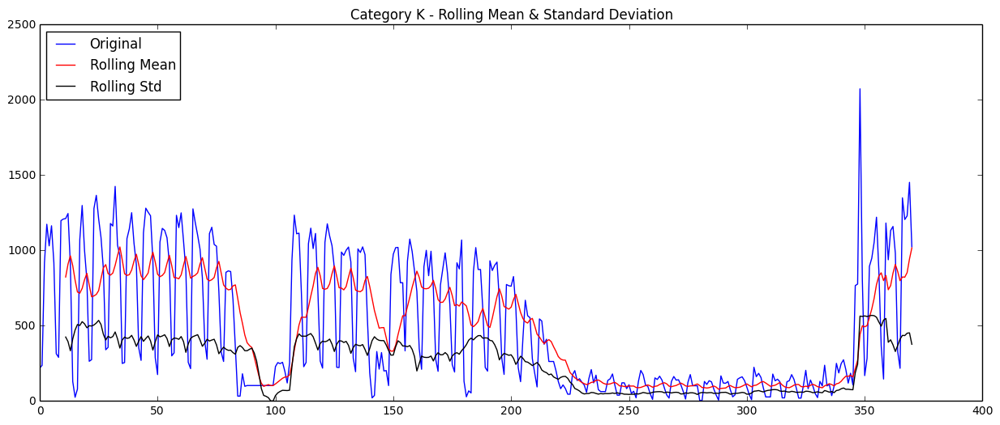

Results of Dickey-Fuller Test:
Test Statistic                  -1.947413
p-value                          0.310095
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


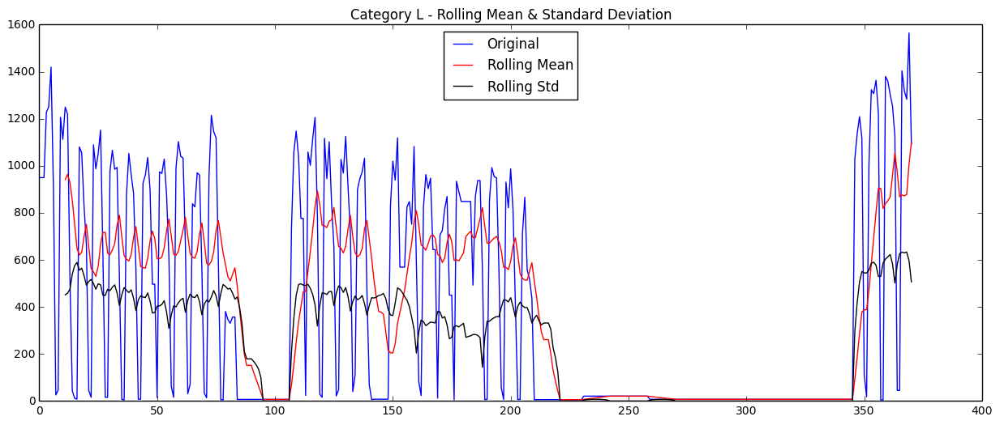

Results of Dickey-Fuller Test:
Test Statistic                  -2.195766
p-value                          0.207786
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


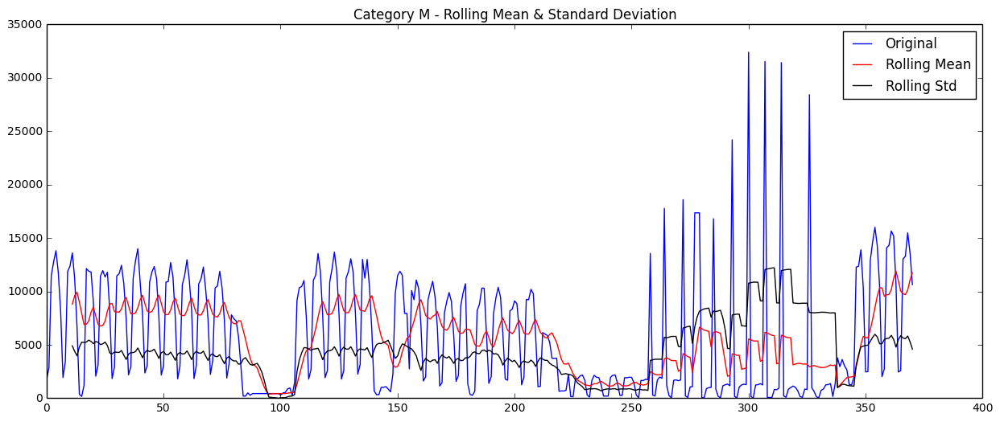

Results of Dickey-Fuller Test:
Test Statistic                  -2.616995
p-value                          0.089535
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


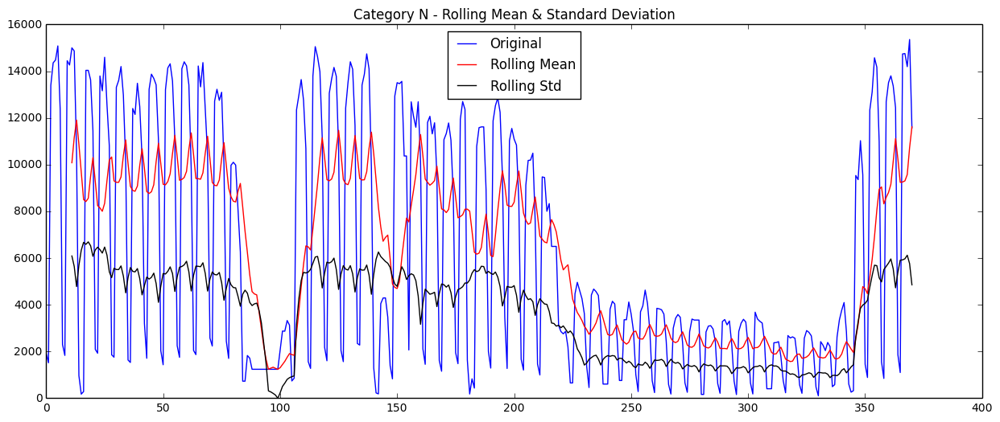

Results of Dickey-Fuller Test:
Test Statistic                  -2.286901
p-value                          0.176228
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


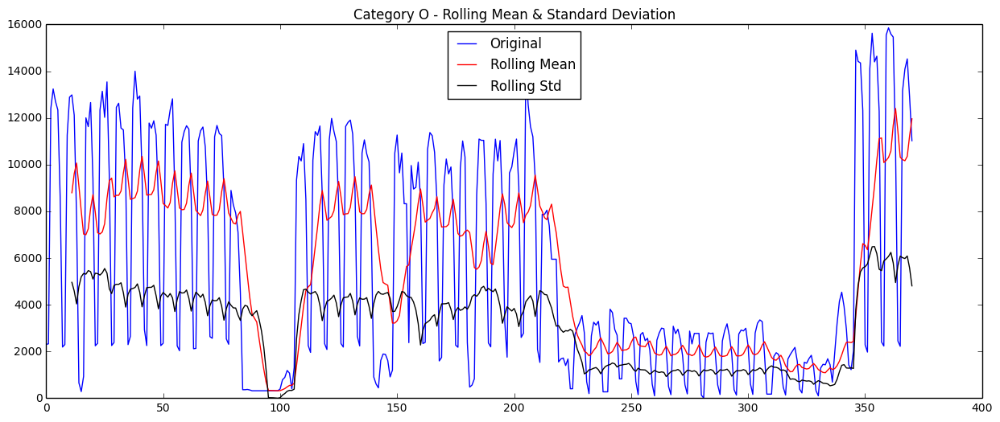

Results of Dickey-Fuller Test:
Test Statistic                  -2.628179
p-value                          0.087312
#Lags Used                       7.000000
Number of Observations Used    363.000000
Critical Value (5%)             -2.869535
Critical Value (1%)             -3.448494
Critical Value (10%)            -2.571029
dtype: float64


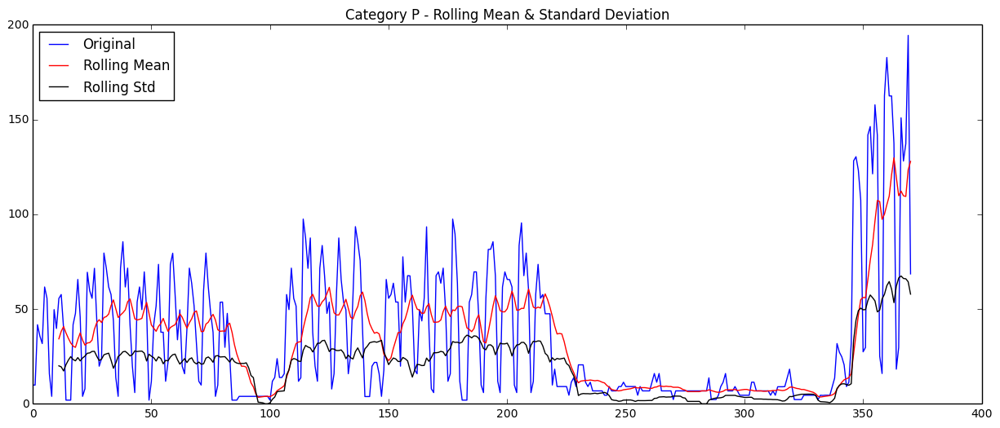

Results of Dickey-Fuller Test:
Test Statistic                  -2.585604
p-value                          0.096009
#Lags Used                      10.000000
Number of Observations Used    360.000000
Critical Value (5%)             -2.869602
Critical Value (1%)             -3.448646
Critical Value (10%)            -2.571065
dtype: float64


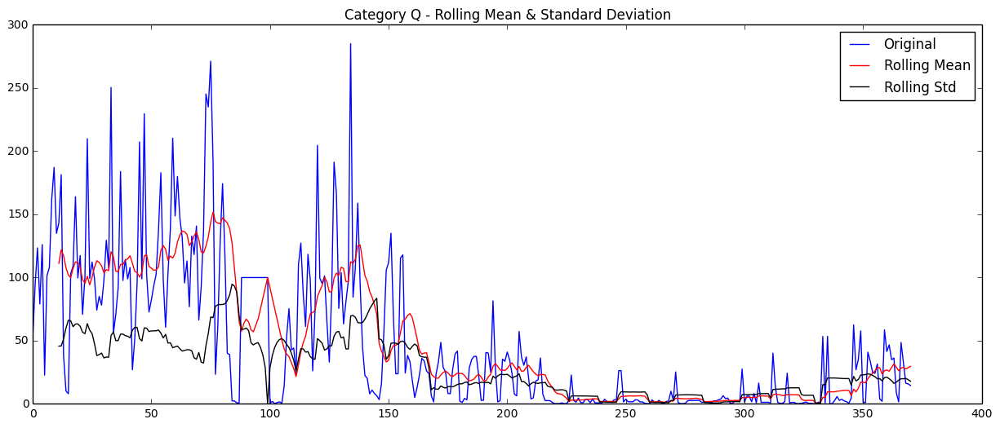

Results of Dickey-Fuller Test:
Test Statistic                  -1.478431
p-value                          0.544153
#Lags Used                      17.000000
Number of Observations Used    353.000000
Critical Value (5%)             -2.869763
Critical Value (1%)             -3.449011
Critical Value (10%)            -2.571151
dtype: float64


In [12]:
_ = map(test_stationarity, splitted_data, temp_list)

### We can see most categories have test statistics are larger than critical value (10%)
### So most categories are not stationary...let's make it stationary!
#### 1) Log it
#### 2) Inverse hyperbolic sine
#### 3) Season_diff(Log)
#### 4) Season_diff(Inverse)

In [13]:
# We will use this function repeatedly to make plots for -> Transformed Data vs. Original Data

def plot_data(original, trans_2, item, title, label_1, label_2):
#     original.plot(label='{}'.format(label_1))
    trans_2.plot(label='{}'.format(label_2))
    plt.legend(loc='best')
    plt.title('Category {} - {}'.format(item, title))
    plt.show(block=False)

# 1) Log it

In [14]:
def log_data(timeseries, item):
    return np.log(timeseries)

splitted_data_log = map(log_data, splitted_data, temp_list)
print splitted_data[0].head(), '\n', splitted_data_log[0].head()

2015-09-26     66.52
2015-09-27     98.92
2015-09-28    405.99
2015-09-29    480.46
2015-09-30    443.97
Freq: D, Name: sales, dtype: float64 
2015-09-26    4.197503
2015-09-27    4.594311
2015-09-28    6.006329
2015-09-29    6.174744
2015-09-30    6.095757
Freq: D, Name: sales, dtype: float64


In [16]:
# Check for both zero values and NA values.

# print map(lambda df: df[df==0].shape, splitted_data_log)
# print map(lambda df: df.isnull().values.sum(), splitted_data_log)
for i, category in enumerate(temp_list):
    print category, 'zero:', splitted_data_log[i][splitted_data_log[i]==0].shape, \
    'NA:', splitted_data_log[i].isnull().values.sum()

 A zero: (8,) NA: 0
B zero: (0,) NA: 0
C zero: (0,) NA: 0
D zero: (0,) NA: 0
E zero: (0,) NA: 0
F zero: (0,) NA: 0
G zero: (0,) NA: 0
H zero: (0,) NA: 0
I zero: (0,) NA: 0
K zero: (0,) NA: 0
L zero: (0,) NA: 0
M zero: (0,) NA: 0
N zero: (0,) NA: 0
O zero: (0,) NA: 0
P zero: (0,) NA: 0
Q zero: (3,) NA: 0


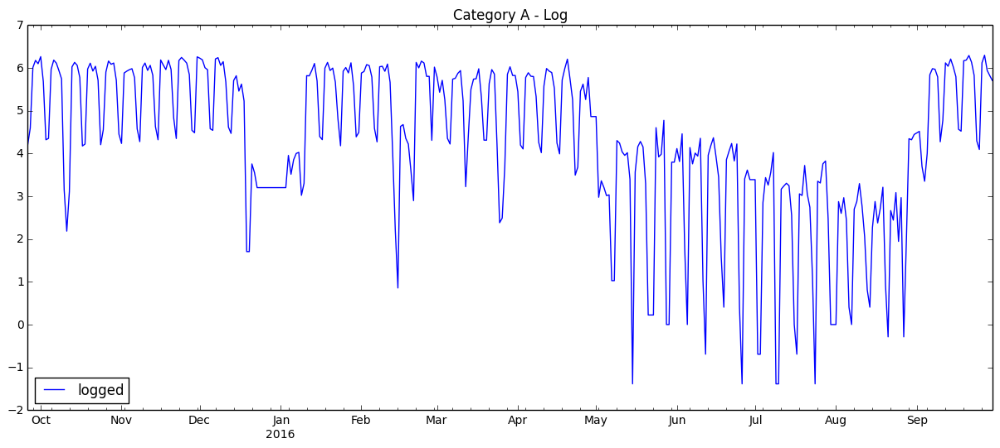

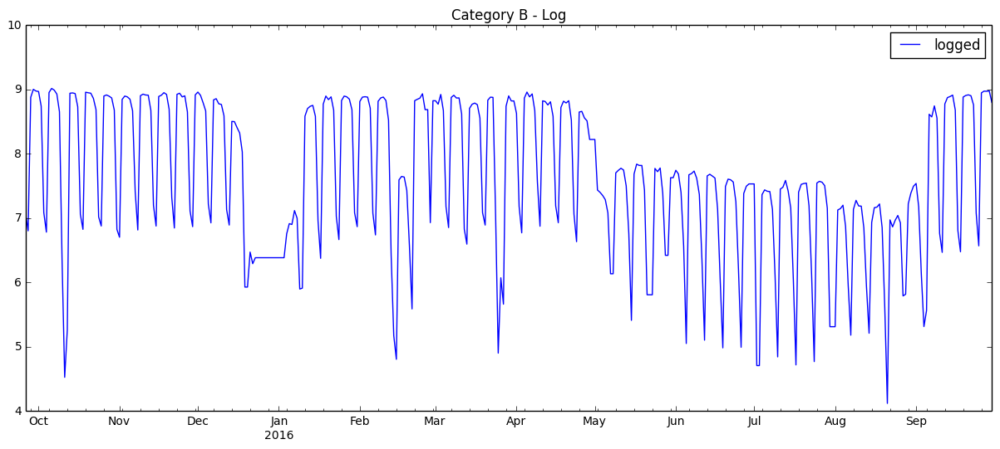

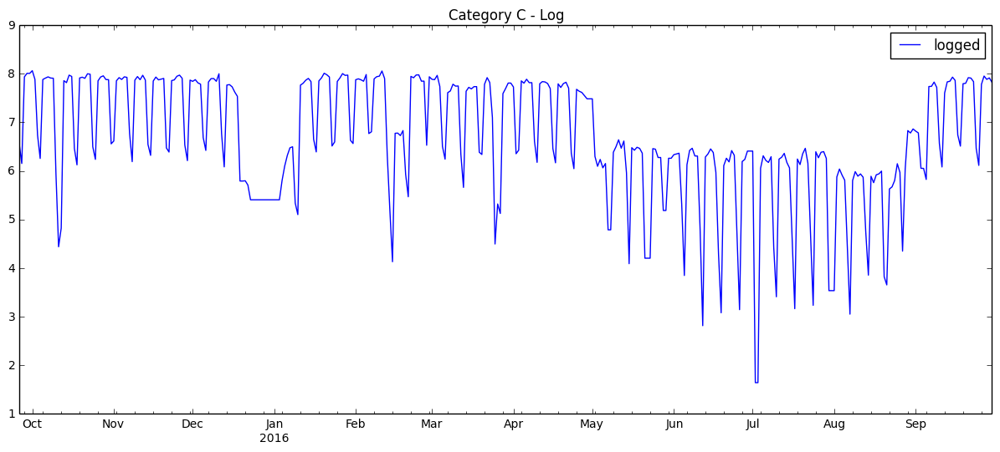

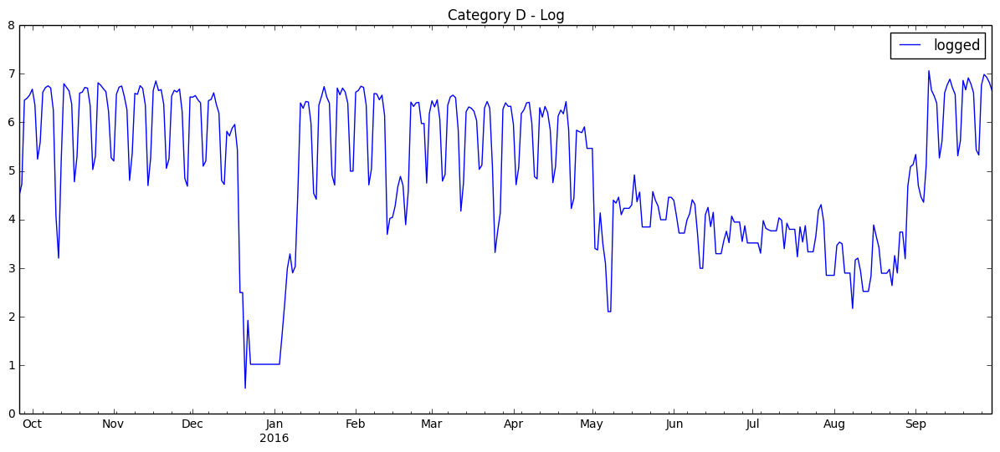

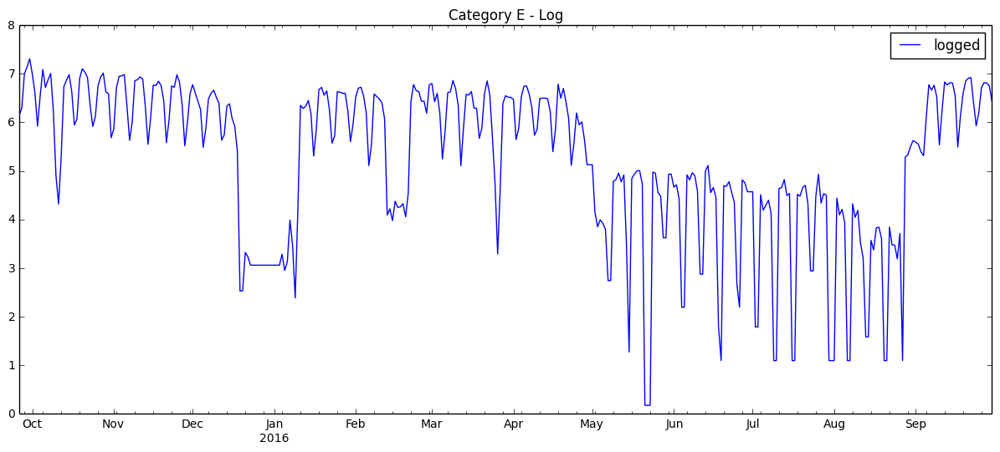

...

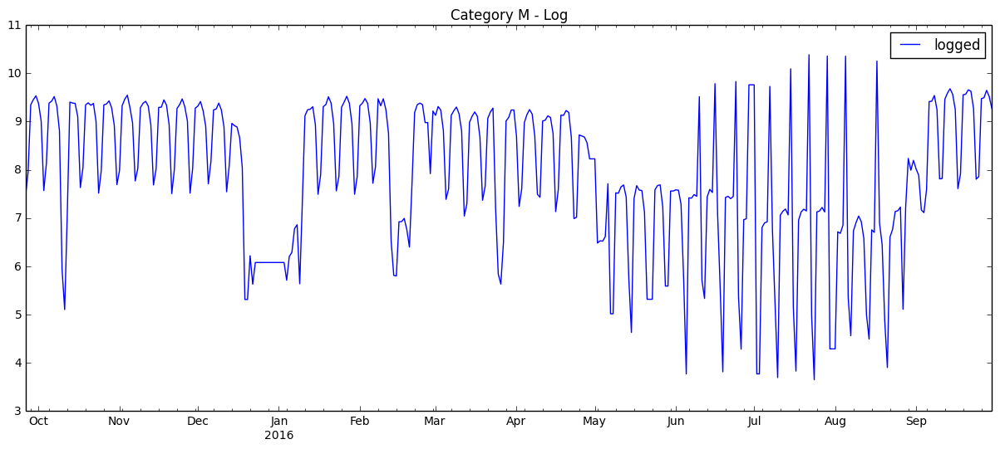

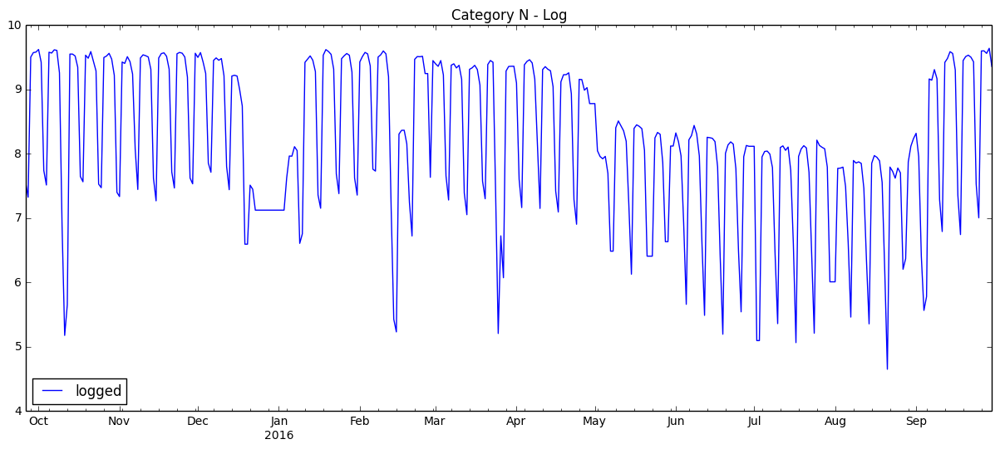

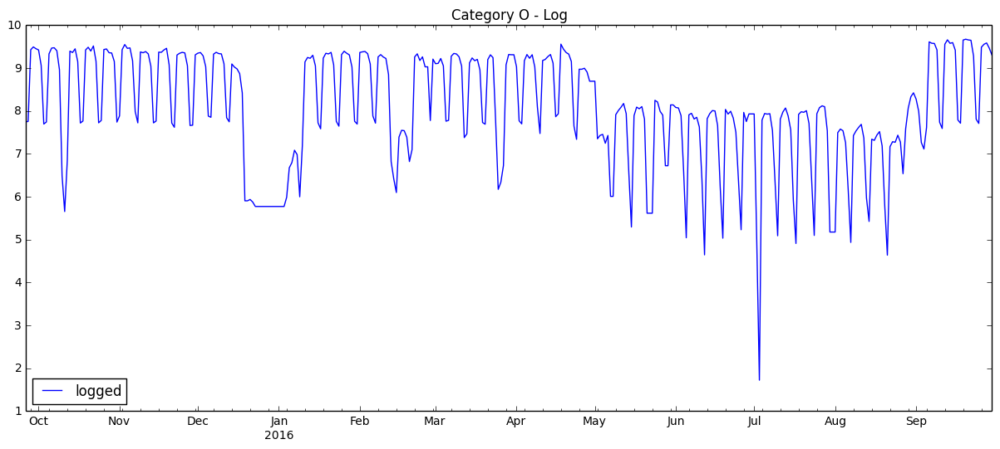

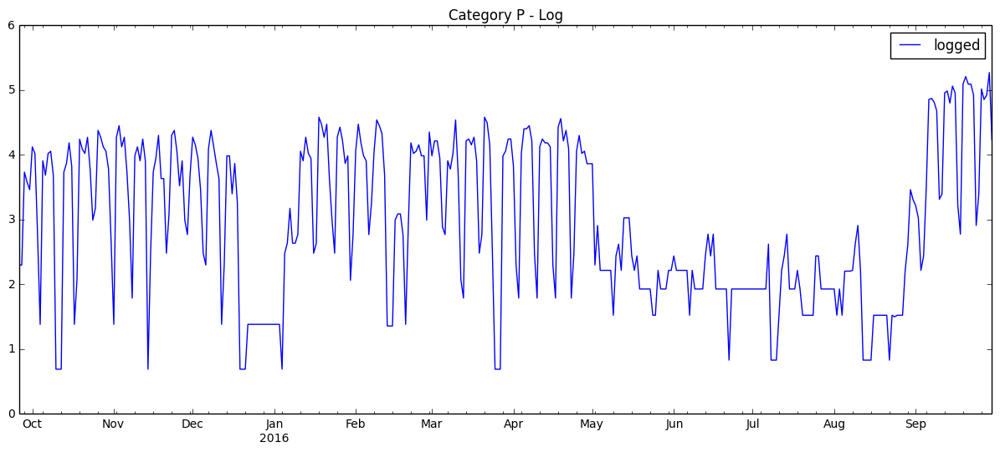

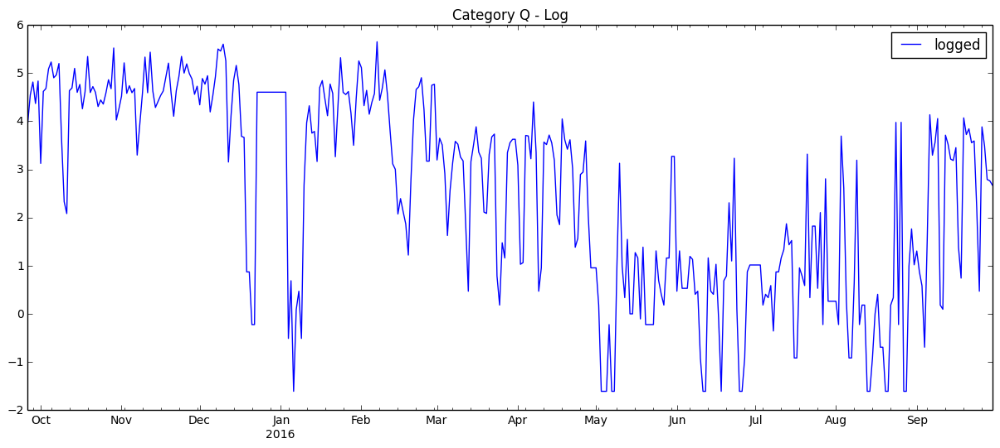

In [17]:
# Let's see the log plot.

_ = map(plot_data, splitted_data, splitted_data_log, temp_list, \
        ['Log']*len(temp_list), ['original']*len(temp_list), ['logged']*len(temp_list))

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


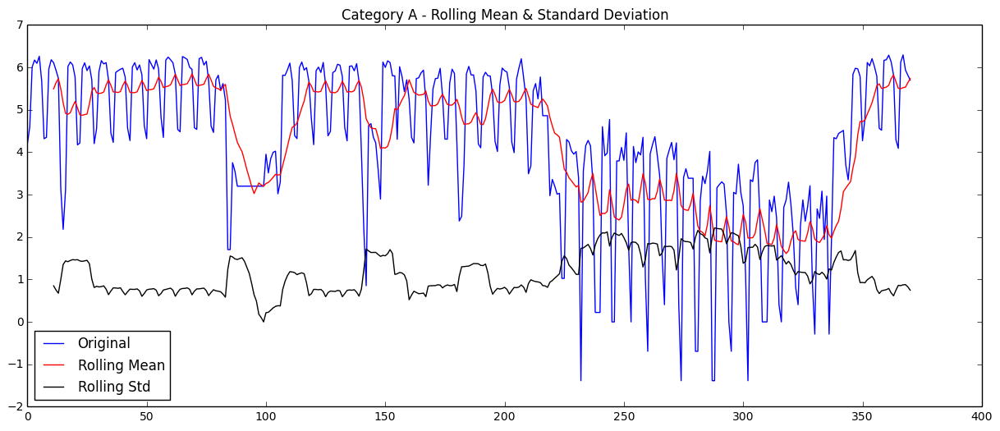

Results of Dickey-Fuller Test:
Test Statistic                  -1.892781
p-value                          0.335465
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


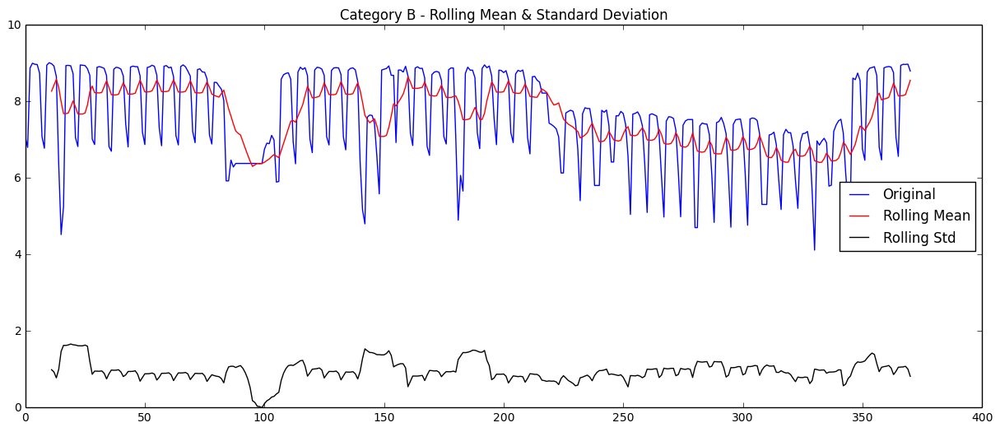

Results of Dickey-Fuller Test:
Test Statistic                  -2.580236
p-value                          0.097151
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


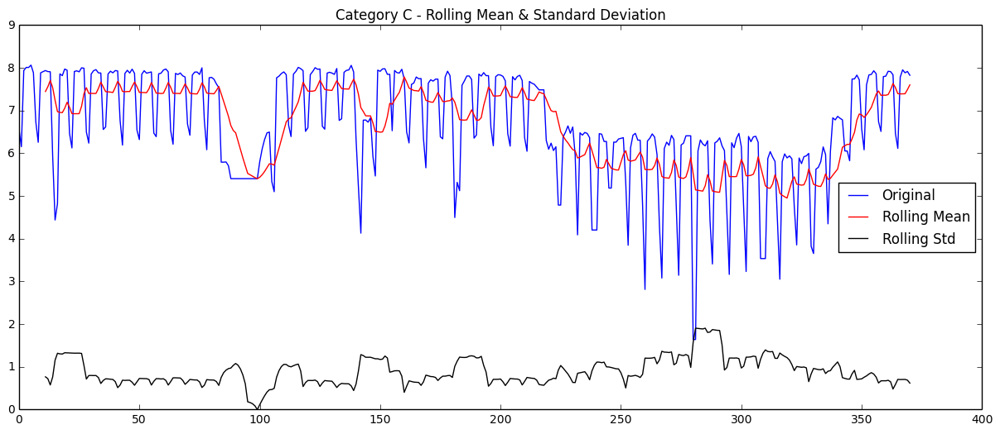

Results of Dickey-Fuller Test:
Test Statistic                  -2.090594
p-value                          0.248314
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


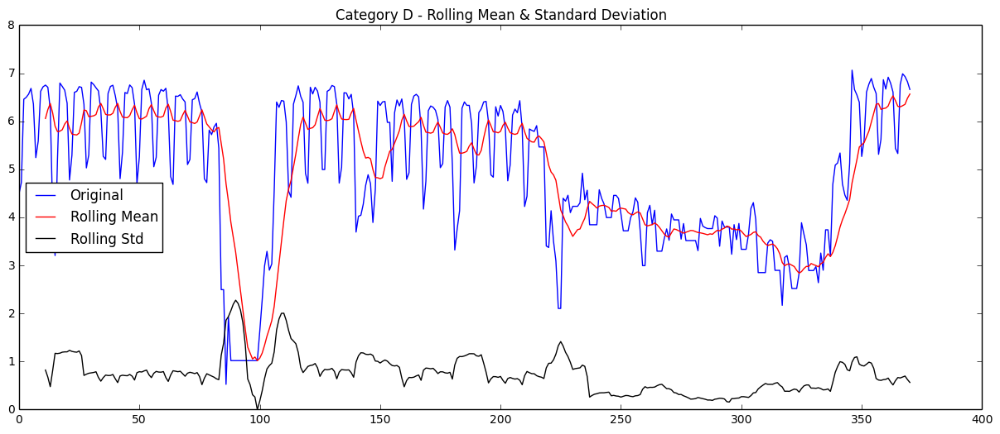

Results of Dickey-Fuller Test:
Test Statistic                  -3.349672
p-value                          0.012799
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


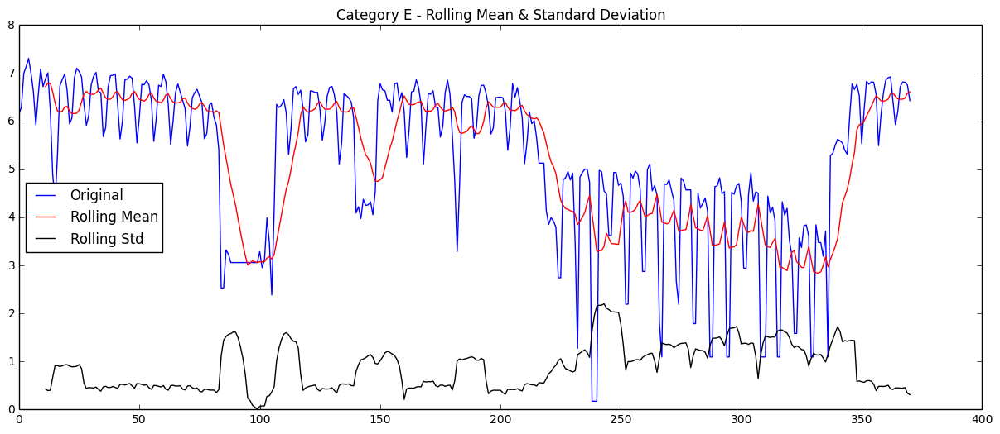

Results of Dickey-Fuller Test:
Test Statistic                  -2.420356
p-value                          0.136073
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


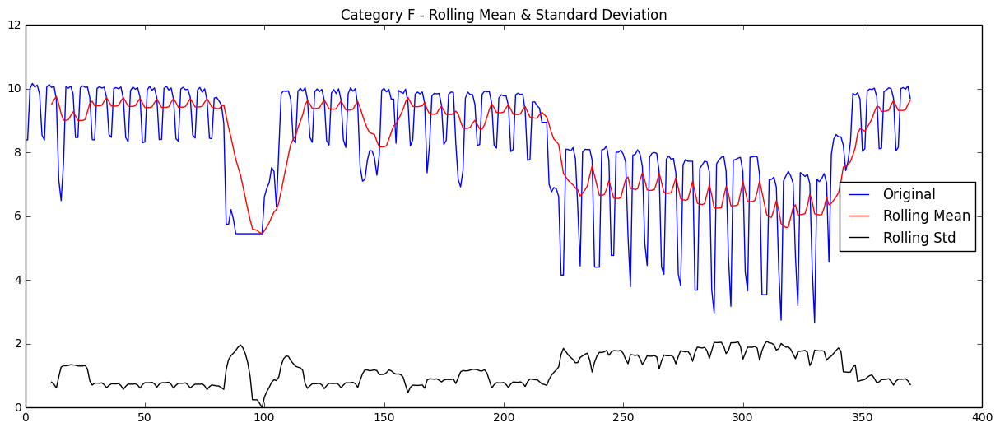

Results of Dickey-Fuller Test:
Test Statistic                  -2.650738
p-value                          0.082958
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


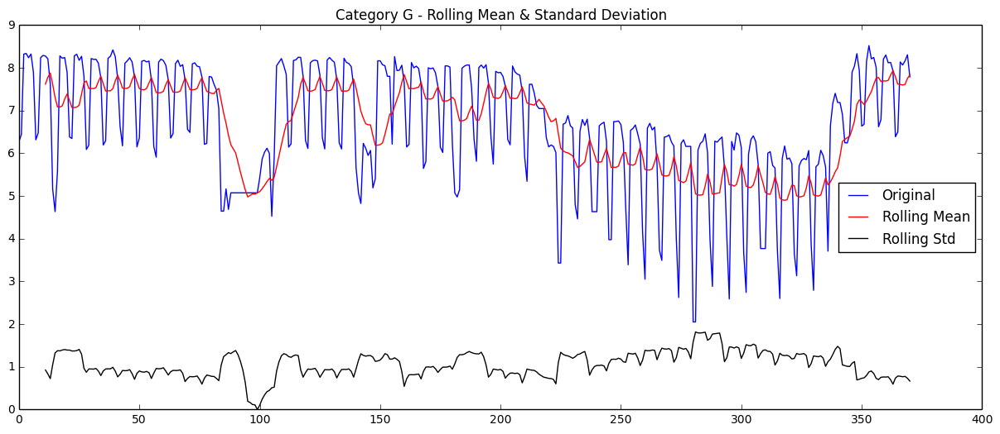

Results of Dickey-Fuller Test:
Test Statistic                  -2.496783
p-value                          0.116259
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


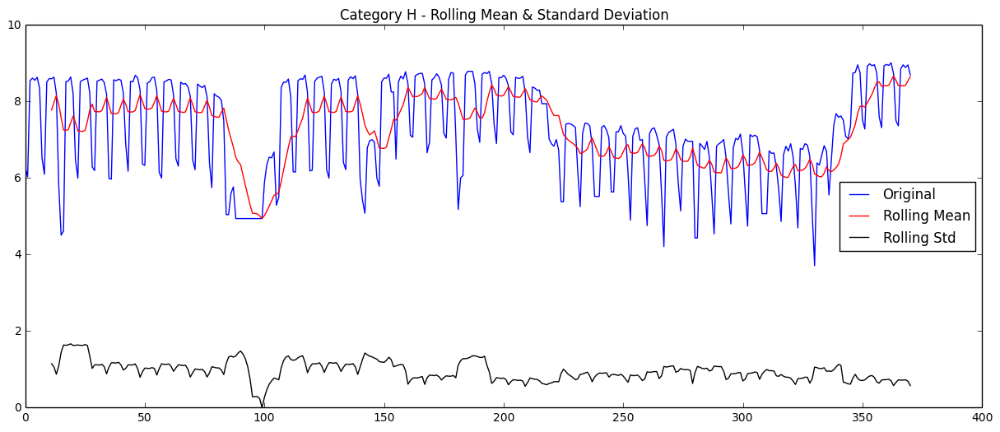

Results of Dickey-Fuller Test:
Test Statistic                  -2.968135
p-value                          0.037979
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


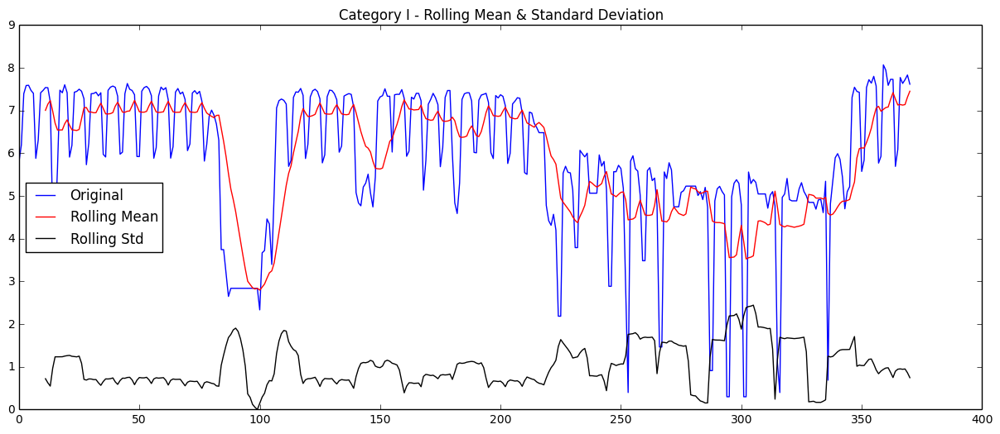

Results of Dickey-Fuller Test:
Test Statistic                  -2.682580
p-value                          0.077101
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


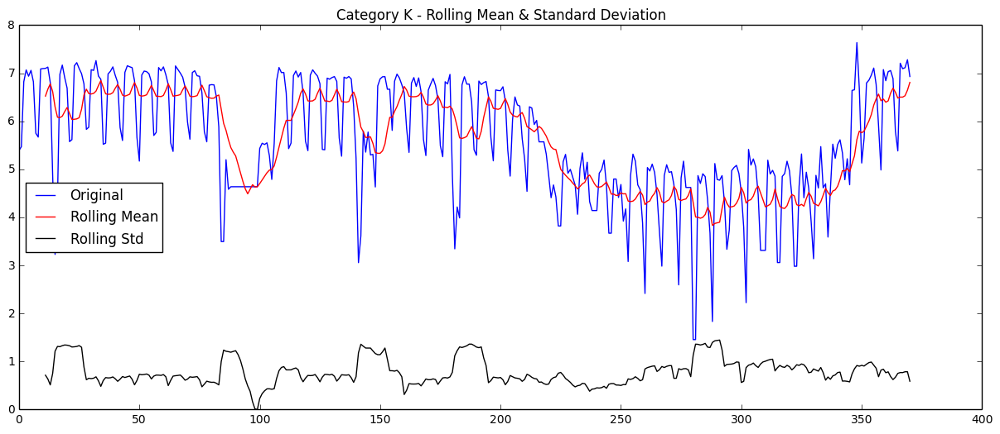

Results of Dickey-Fuller Test:
Test Statistic                  -2.002315
p-value                          0.285559
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


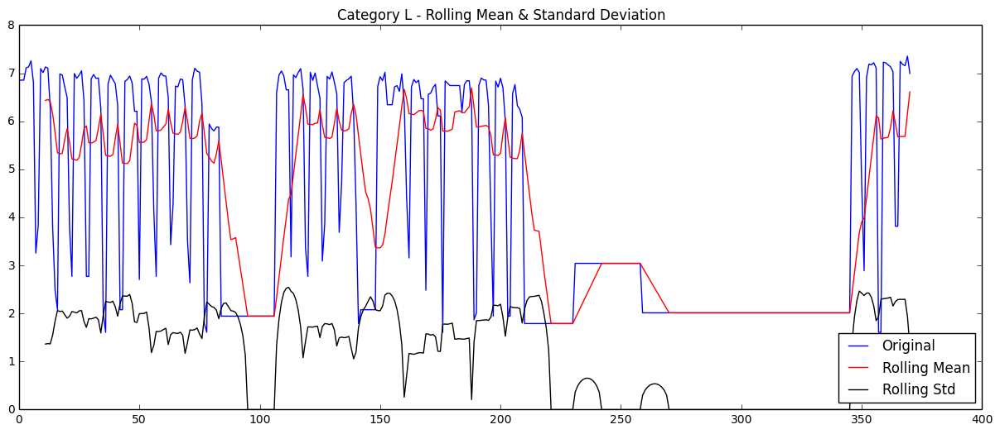

Results of Dickey-Fuller Test:
Test Statistic                  -2.310910
p-value                          0.168473
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


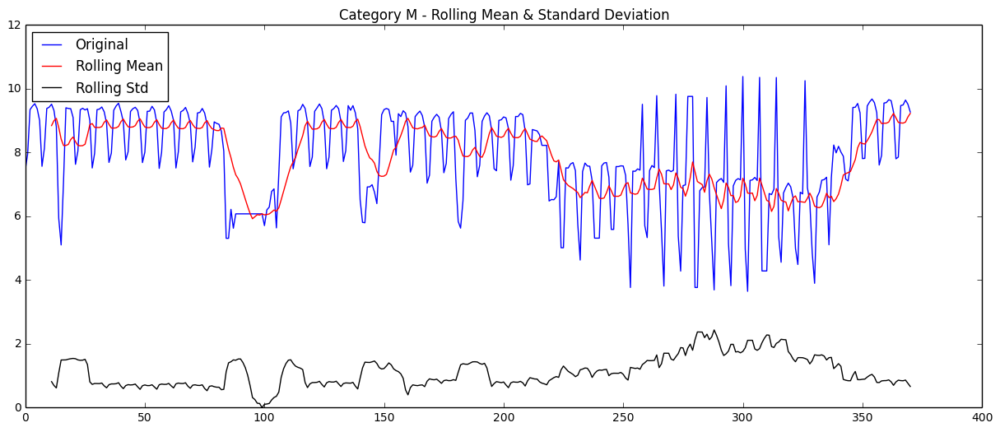

Results of Dickey-Fuller Test:
Test Statistic                  -2.604218
p-value                          0.092129
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


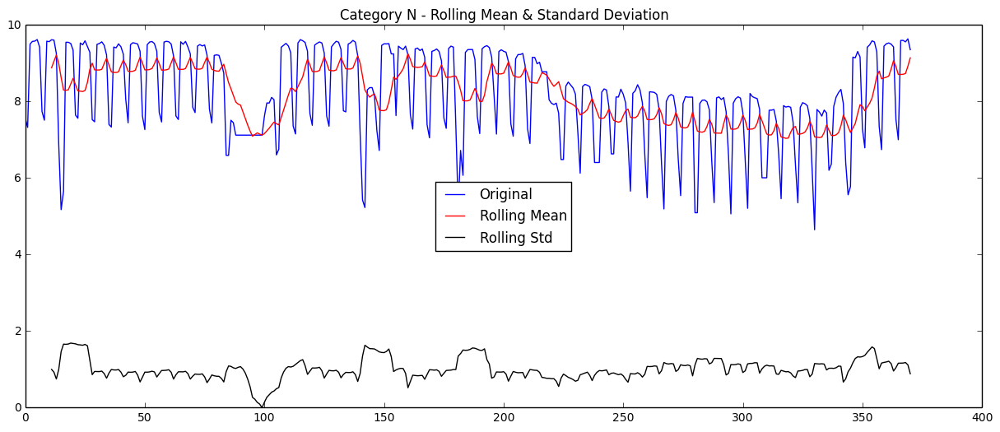

Results of Dickey-Fuller Test:
Test Statistic                  -2.402554
p-value                          0.141017
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


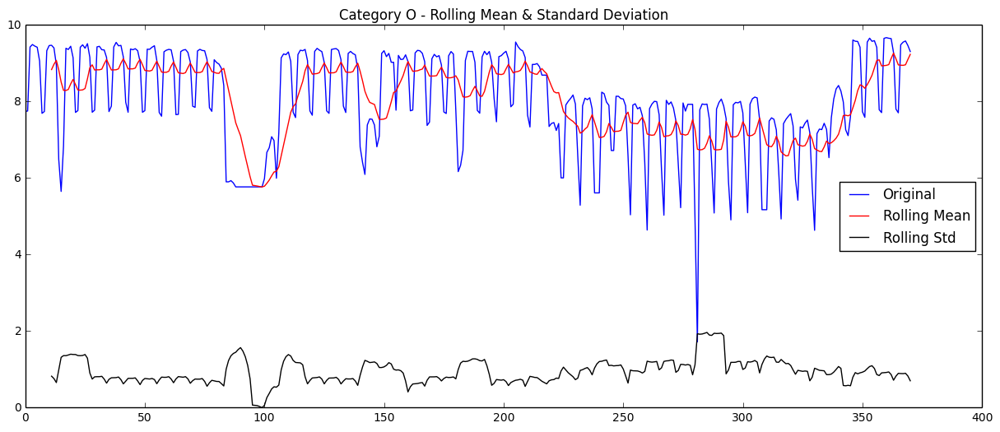

Results of Dickey-Fuller Test:
Test Statistic                  -3.034723
p-value                          0.031777
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


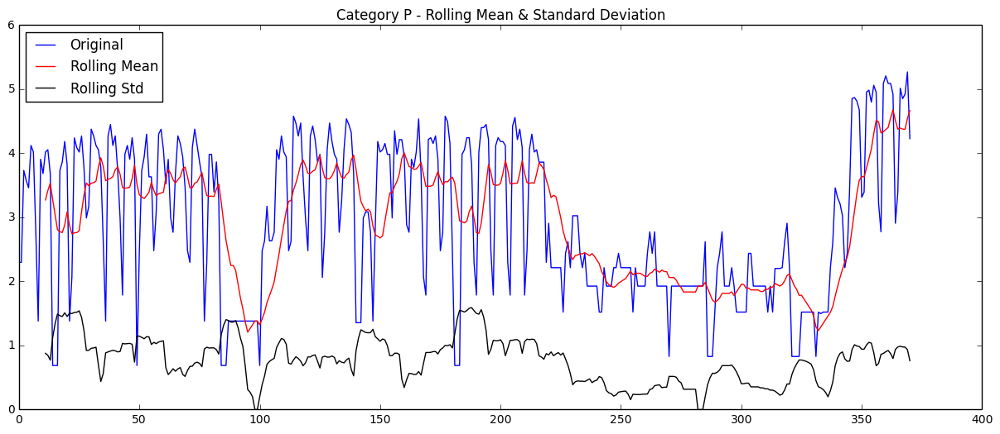

Results of Dickey-Fuller Test:
Test Statistic                  -2.877054
p-value                          0.048082
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


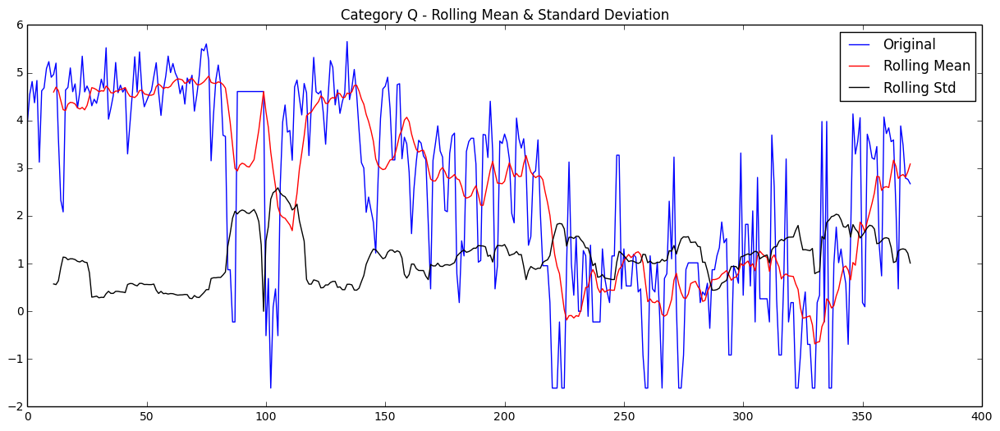

Results of Dickey-Fuller Test:
Test Statistic                  -1.649404
p-value                          0.457351
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


In [18]:
_ = map(test_stationarity, splitted_data_log, temp_list)

In [30]:
# See if log improved test statistics, or made it worse.

observed_stat = map(test_statistic, splitted_data)
logged_stat = map(test_statistic, splitted_data_log)
stat_diff = map(lambda x, y: x - y, observed_stat, logged_stat)
for i, cat in enumerate(temp_list):
    print cat, ':', stat_diff[i]

A : -0.304734675533
B : 0.276777289337
C : -0.112326068335
D : 1.18571312541
E : 0.40558814716
F : 0.426883749167
G : 0.206315089542
H : 0.802283723432
I : 0.367143651904
K : 0.0549018888771
L : 0.115144101283
M : -0.0127776676829
N : 0.115653346088
O : 0.406543532634
P : 0.291449250899
Q : 0.170973267426


# 2) Try Inverse Hyperbolic Sine

In [31]:
splitted_data_inversed = map(lambda df: np.arcsinh(df), splitted_data)
print splitted_data[0].head()
print splitted_data_inversed[0].head()

2015-09-26     66.52
2015-09-27     98.92
2015-09-28    405.99
2015-09-29    480.46
2015-09-30    443.97
Freq: D, Name: sales, dtype: float64
2015-09-26    4.890706
2015-09-27    5.287484
2015-09-28    6.699477
2015-09-29    6.867892
2015-09-30    6.788905
Freq: D, Name: sales, dtype: float64


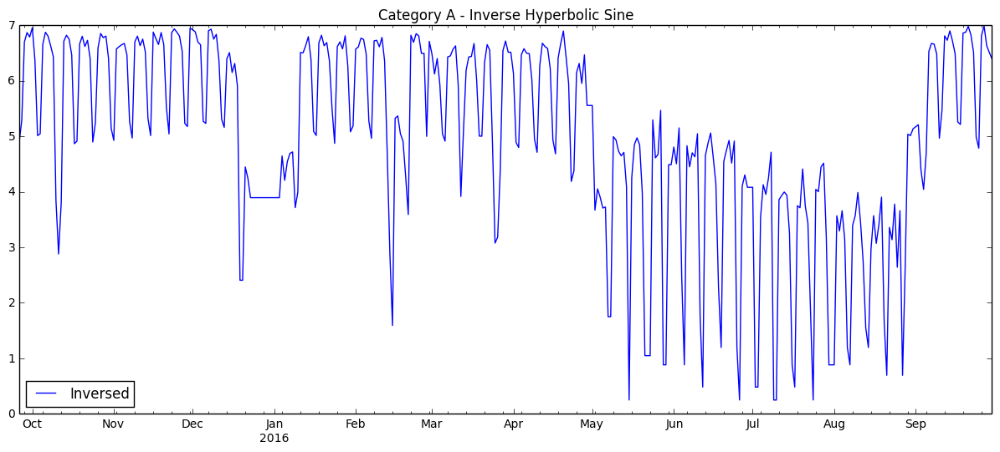

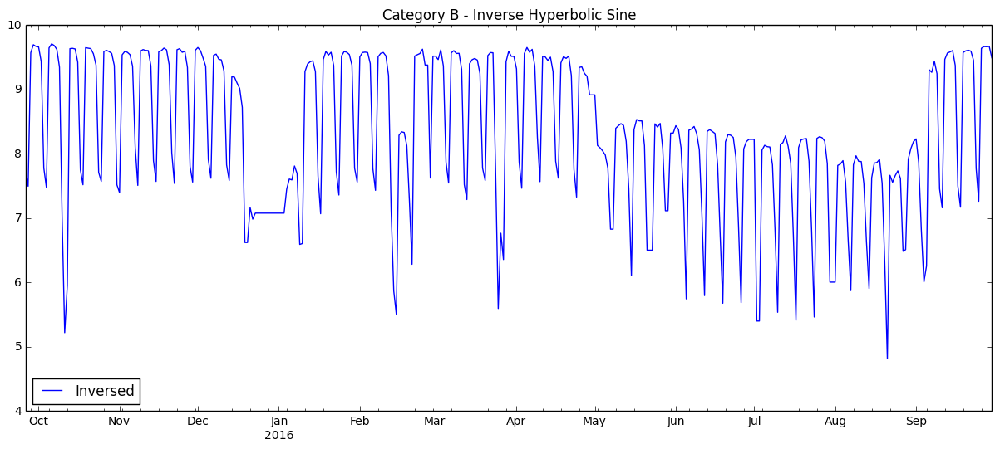

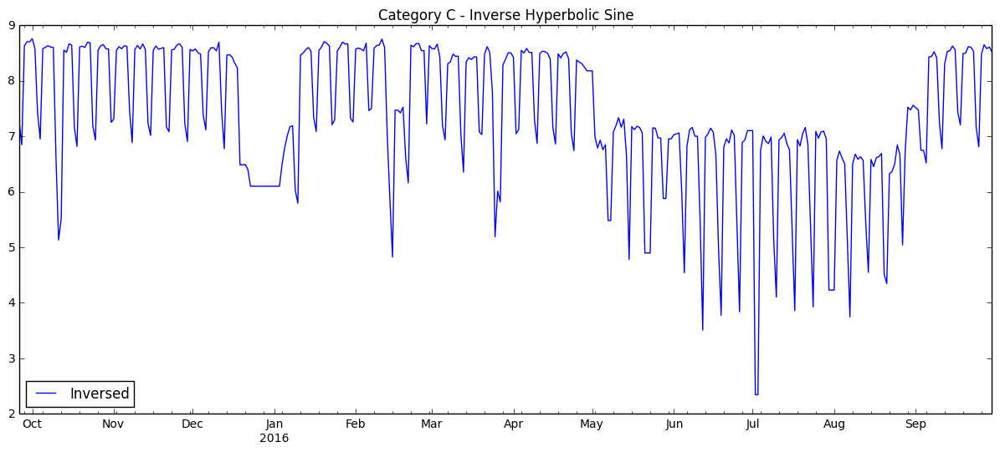

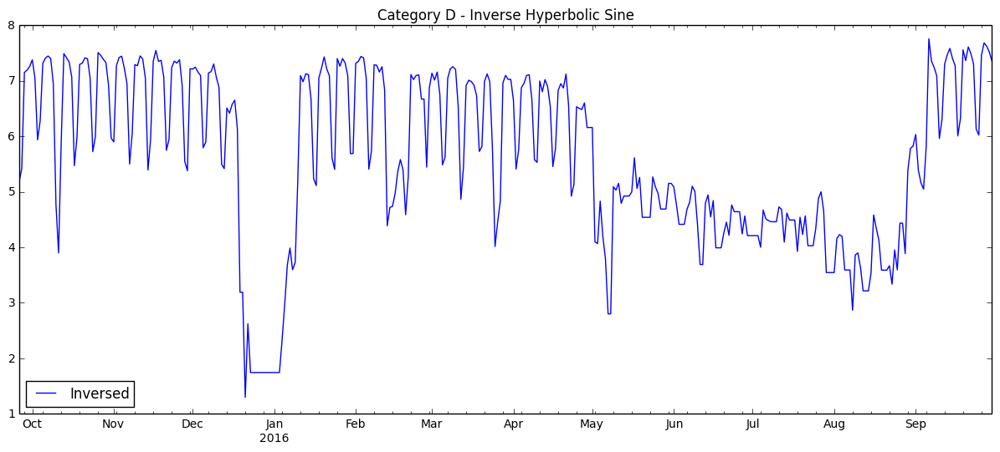

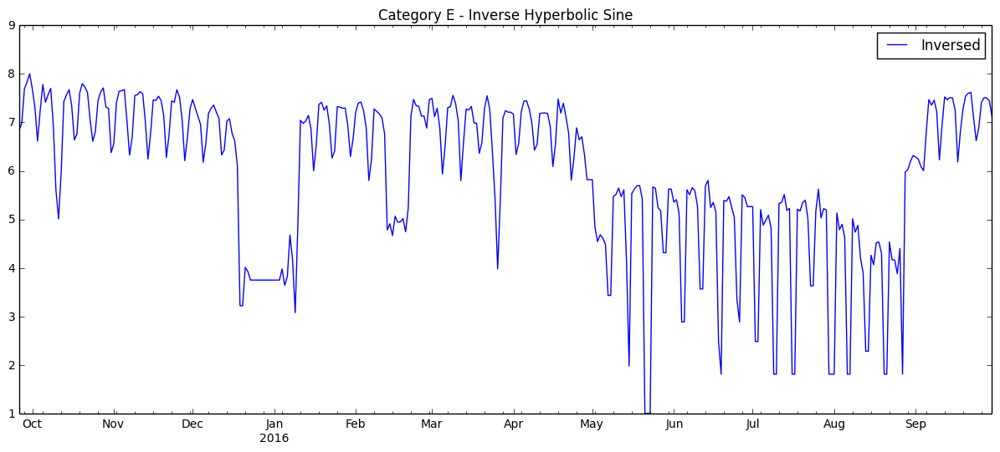

...

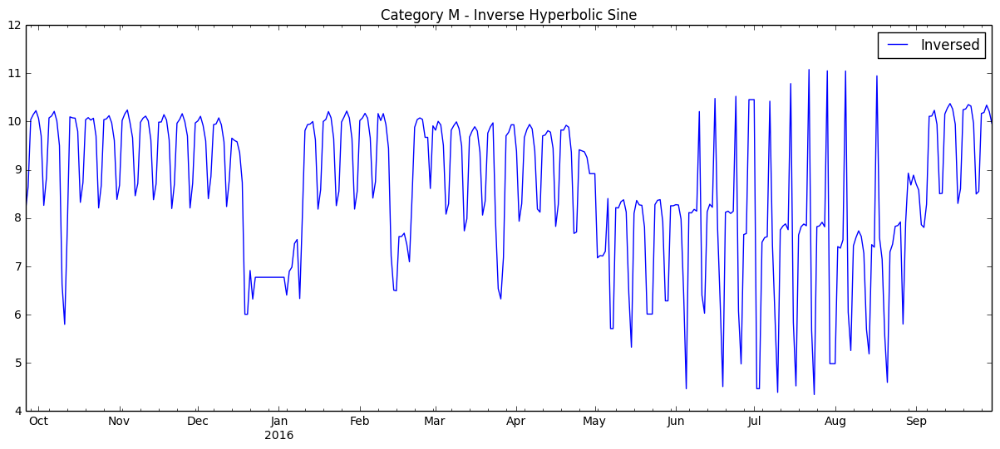

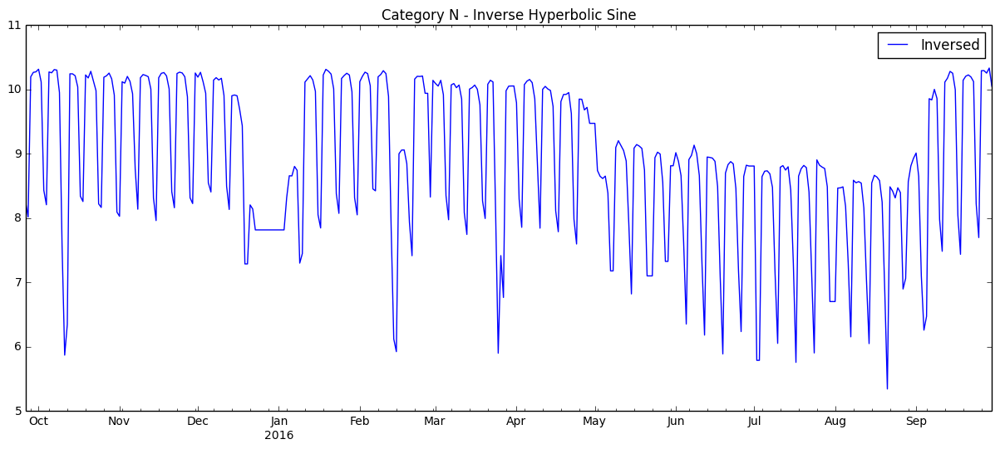

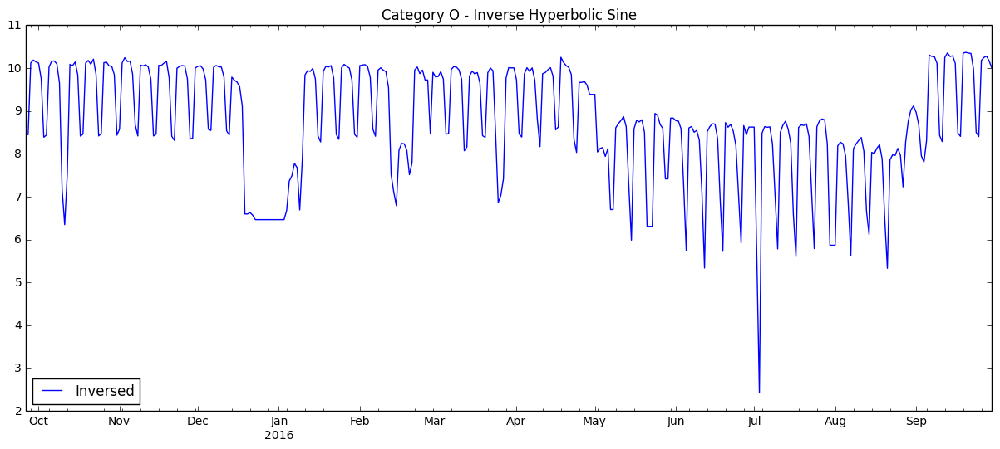

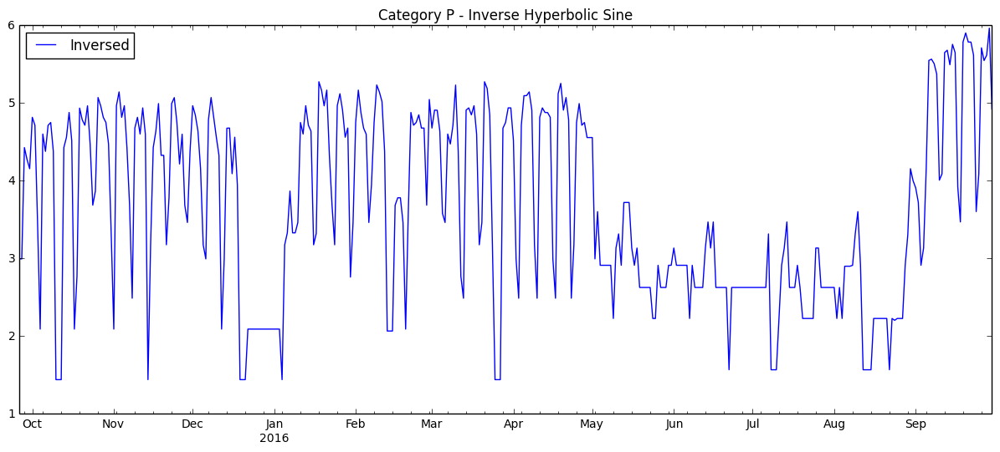

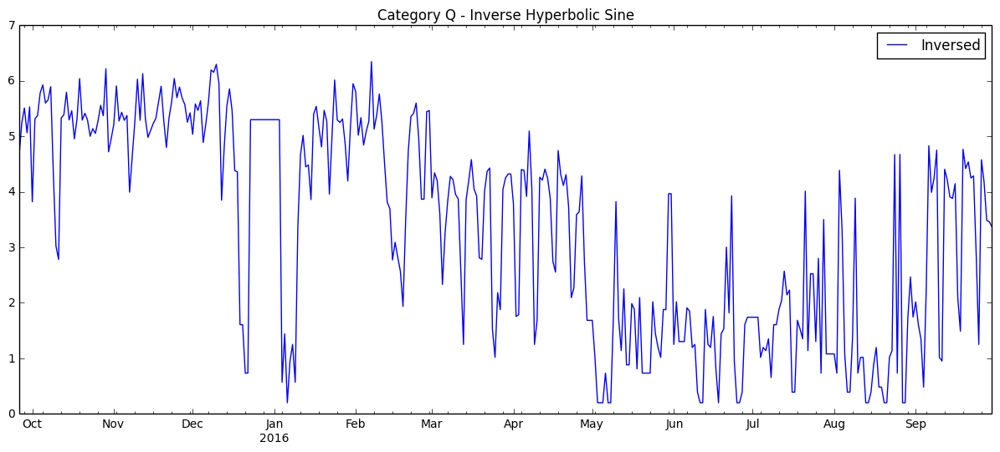

In [32]:
_ = map(plot_data, splitted_data, splitted_data_inversed, temp_list, \
        ['Inverse Hyperbolic Sine']*len(temp_list), ['original']*len(temp_list), ['Inversed']*len(temp_list))

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


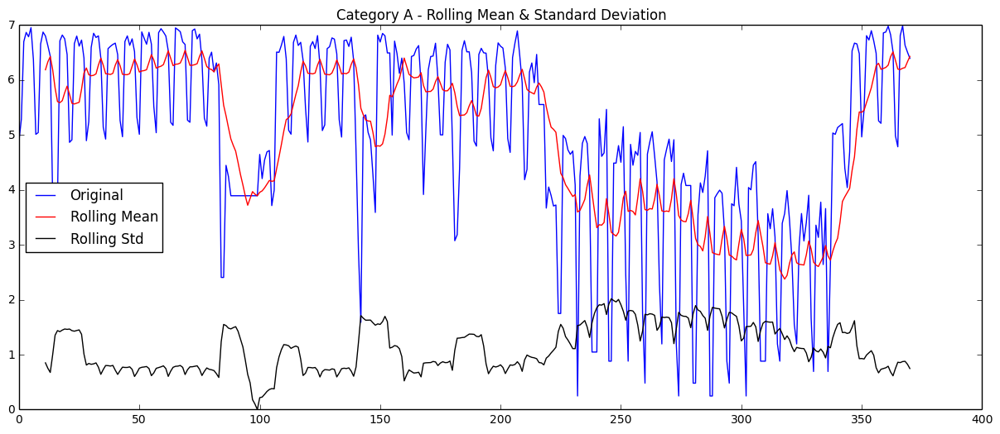

Results of Dickey-Fuller Test:
Test Statistic                  -1.911609
p-value                          0.326620
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


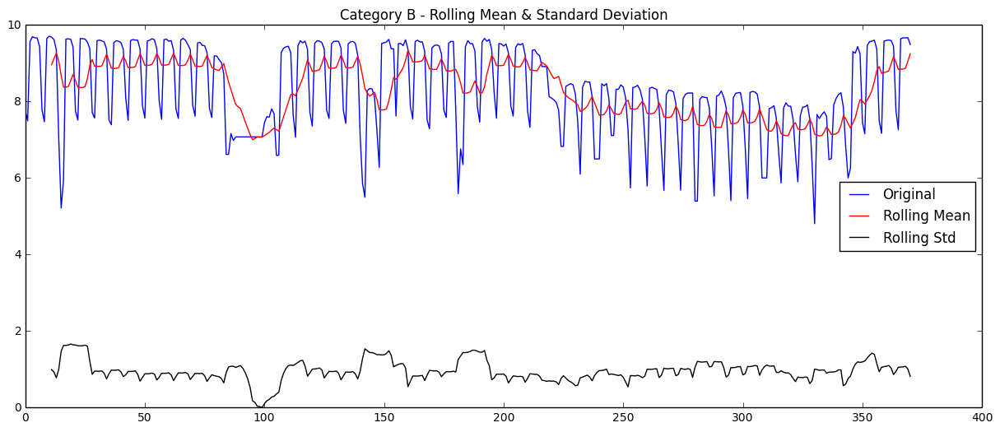

Results of Dickey-Fuller Test:
Test Statistic                  -2.580237
p-value                          0.097151
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


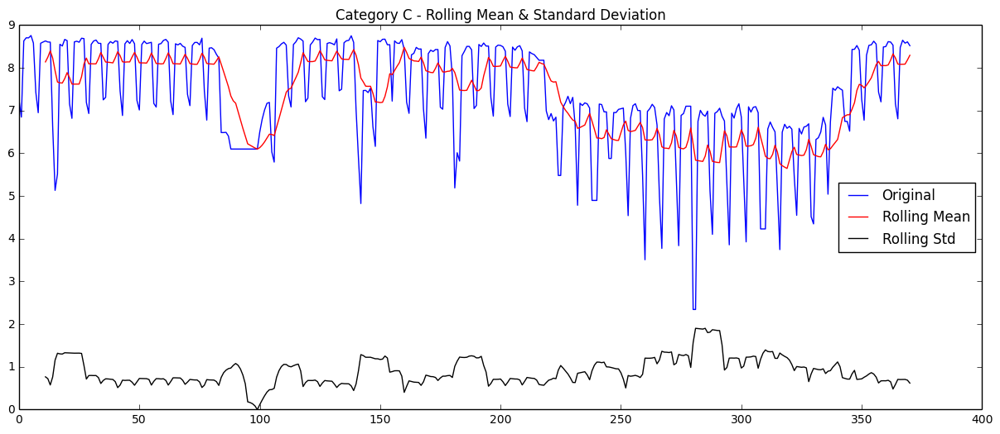

Results of Dickey-Fuller Test:
Test Statistic                  -2.090865
p-value                          0.248204
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


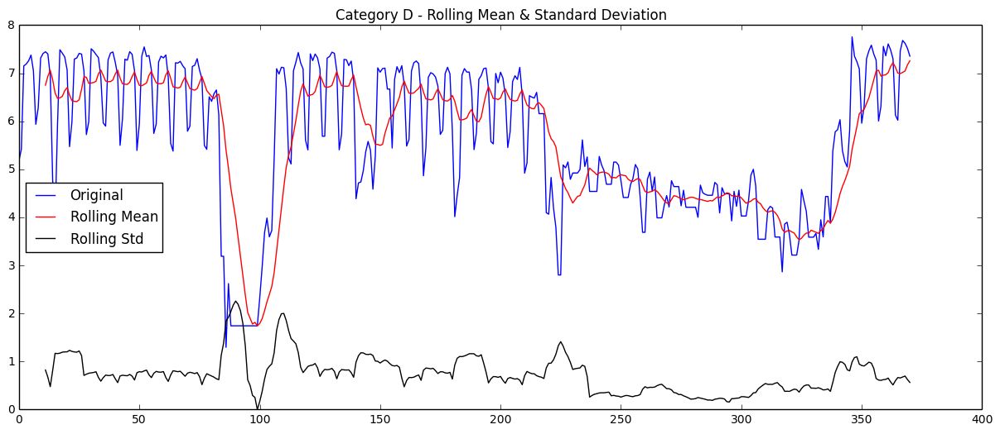

Results of Dickey-Fuller Test:
Test Statistic                  -3.340007
p-value                          0.013182
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


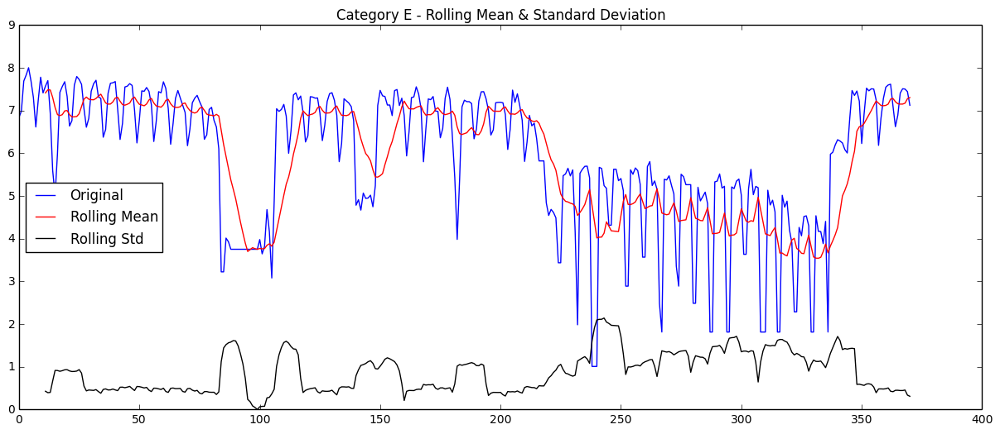

Results of Dickey-Fuller Test:
Test Statistic                  -2.426818
p-value                          0.134310
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


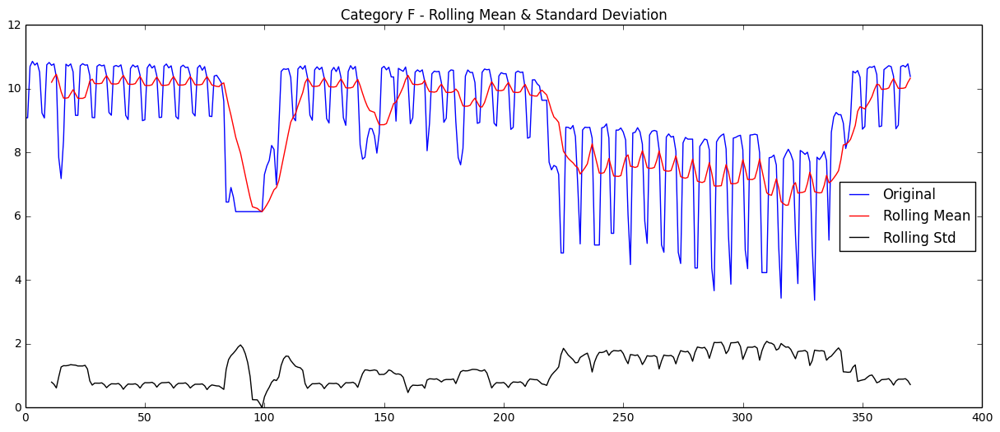

Results of Dickey-Fuller Test:
Test Statistic                  -2.650780
p-value                          0.082949
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


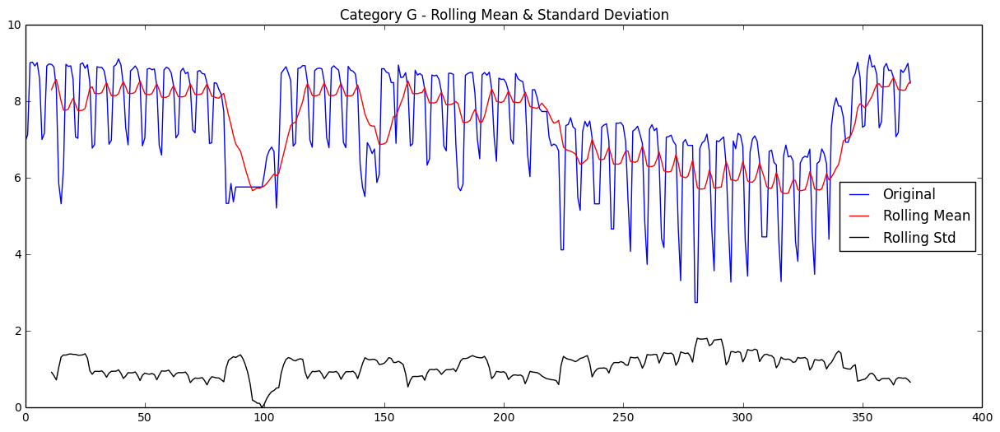

Results of Dickey-Fuller Test:
Test Statistic                  -2.497005
p-value                          0.116205
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


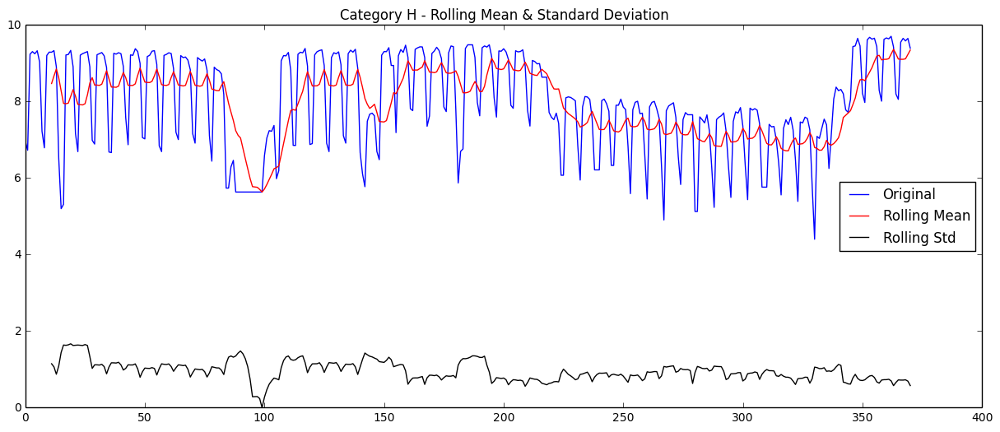

Results of Dickey-Fuller Test:
Test Statistic                  -2.968133
p-value                          0.037979
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


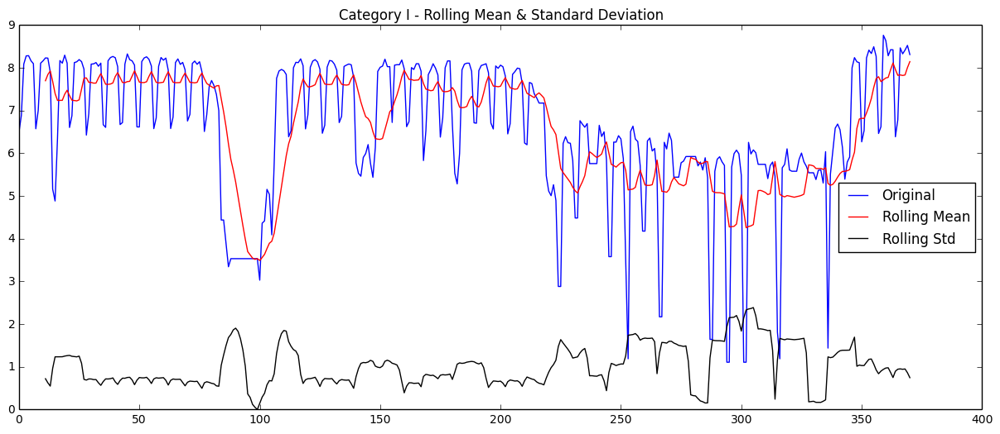

Results of Dickey-Fuller Test:
Test Statistic                  -2.689271
p-value                          0.075913
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


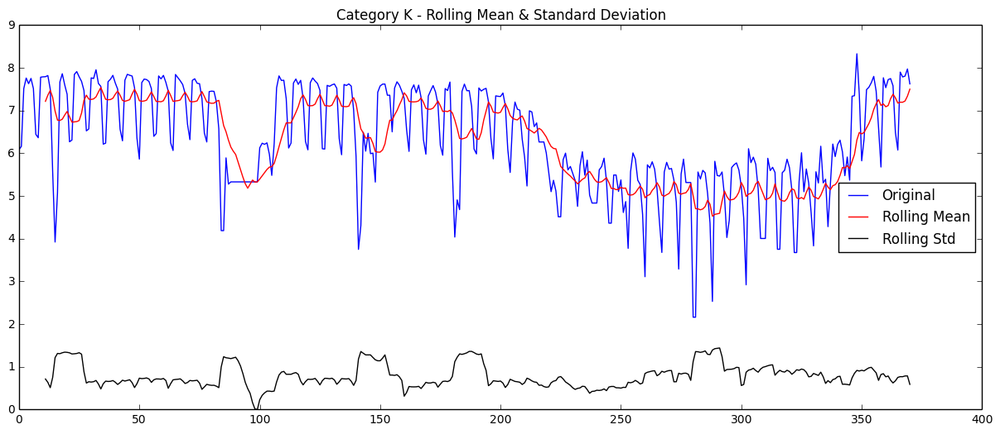

Results of Dickey-Fuller Test:
Test Statistic                  -2.002240
p-value                          0.285592
#Lags Used                      14.000000
Number of Observations Used    356.000000
Critical Value (5%)             -2.869693
Critical Value (1%)             -3.448853
Critical Value (10%)            -2.571114
dtype: float64


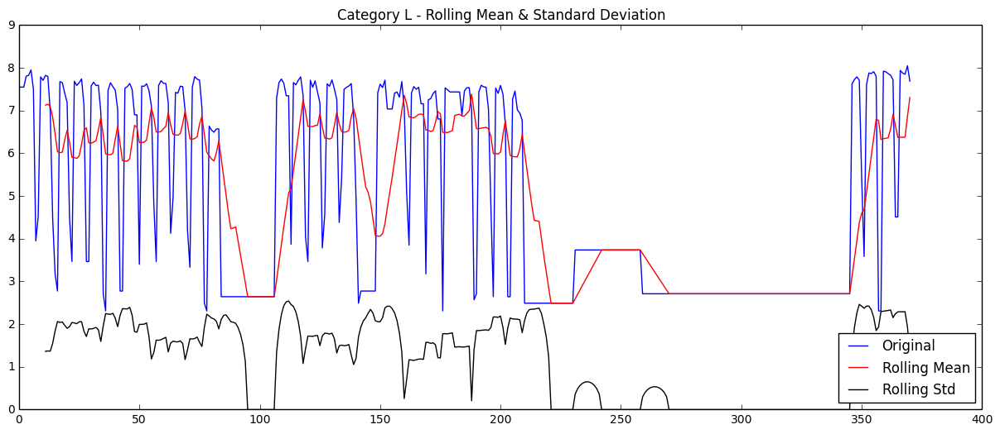

Results of Dickey-Fuller Test:
Test Statistic                  -2.309915
p-value                          0.168790
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


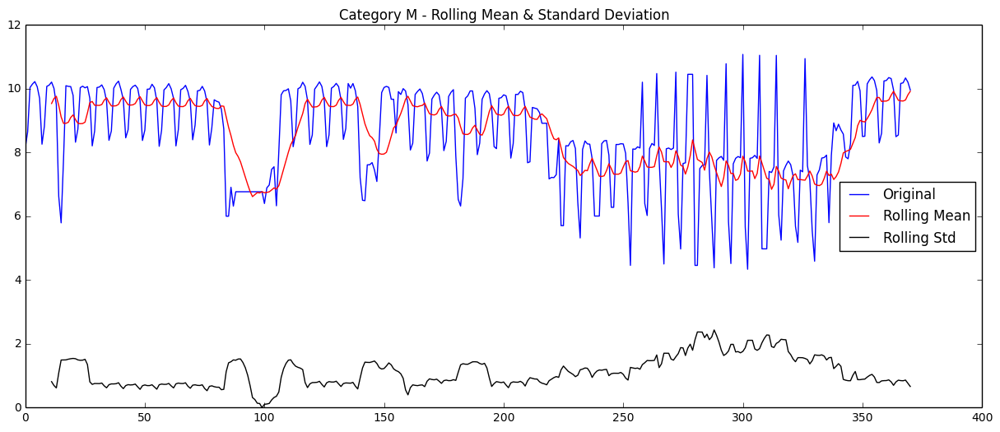

Results of Dickey-Fuller Test:
Test Statistic                  -2.604227
p-value                          0.092127
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


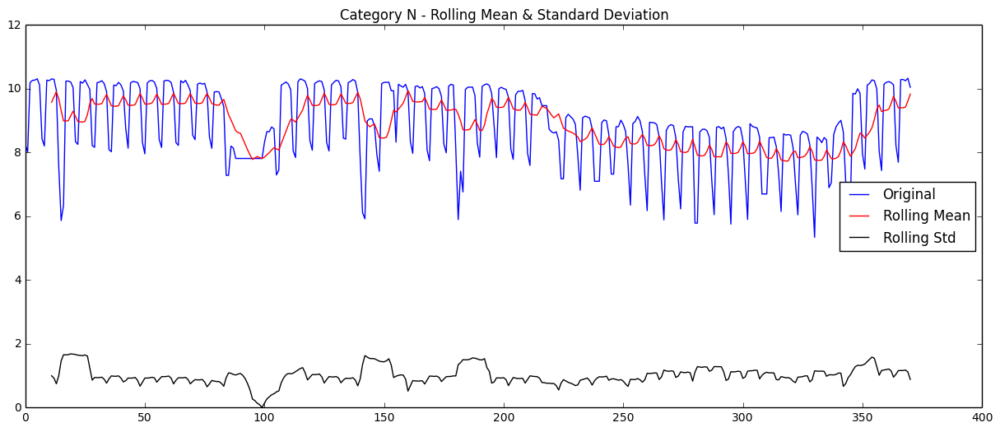

Results of Dickey-Fuller Test:
Test Statistic                  -2.402554
p-value                          0.141017
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


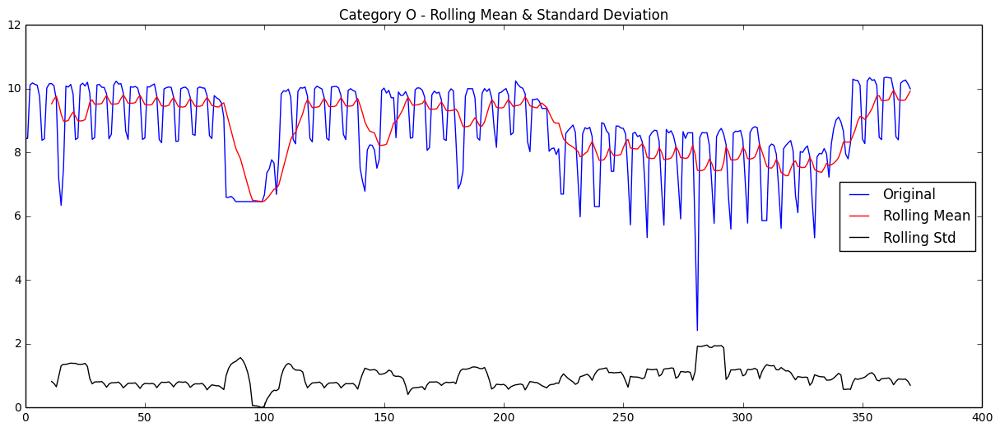

Results of Dickey-Fuller Test:
Test Statistic                  -3.034960
p-value                          0.031756
#Lags Used                      15.000000
Number of Observations Used    355.000000
Critical Value (5%)             -2.869716
Critical Value (1%)             -3.448906
Critical Value (10%)            -2.571126
dtype: float64


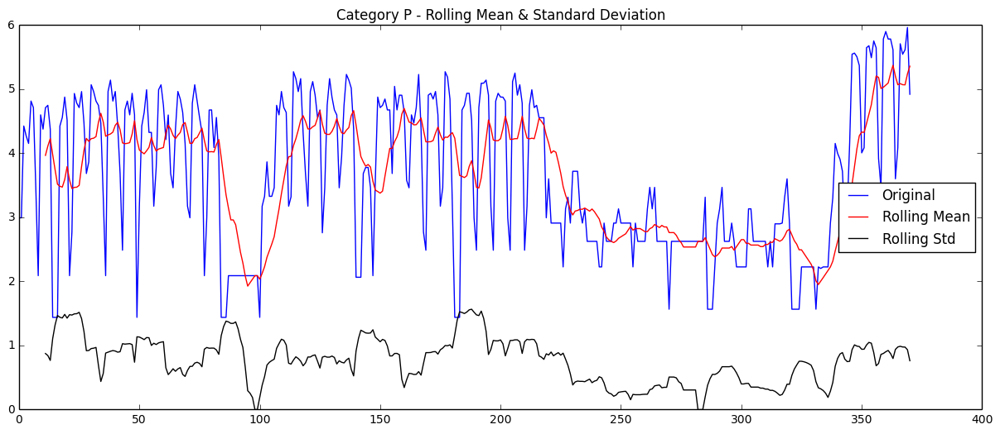

Results of Dickey-Fuller Test:
Test Statistic                  -2.863307
p-value                          0.049784
#Lags Used                      16.000000
Number of Observations Used    354.000000
Critical Value (5%)             -2.869739
Critical Value (1%)             -3.448958
Critical Value (10%)            -2.571138
dtype: float64


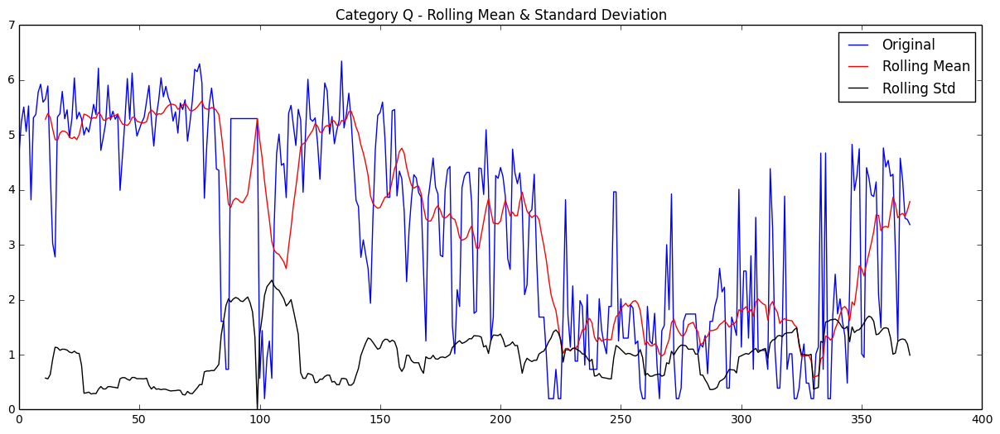

Results of Dickey-Fuller Test:
Test Statistic                  -1.614205
p-value                          0.475768
#Lags Used                      13.000000
Number of Observations Used    357.000000
Critical Value (5%)             -2.869670
Critical Value (1%)             -3.448801
Critical Value (10%)            -2.571101
dtype: float64


In [33]:
_ = map(test_stationarity, splitted_data_inversed, temp_list)

In [45]:
# See if inverse hyperbolic sine improved test statistics, or made it worse.

observed_stat = map(test_statistic, splitted_data)
inversed_stat = map(test_statistic, splitted_data_inversed)
stat_diff_2 = map(lambda x, y: x - y, observed_stat, inversed_stat)
for i, cat in enumerate(temp_list):
    print cat, ':', stat_diff_2[i]
print np.mean(stat_diff_2)

A : -0.285907227778
B : 0.276778379254
C : -0.11205539039
D : 1.17604804247
E : 0.412050207127
F : 0.426926394206
G : 0.20653737676
H : 0.802282249379
I : 0.373834584039
K : 0.0548264654613
L : 0.114149559133
M : -0.0127682938085
N : 0.115653809303
O : 0.40678120313
P : 0.277703115653
Q : 0.135774776922
0.273038453179


# 3.1) Seasonal diff of observed data.

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


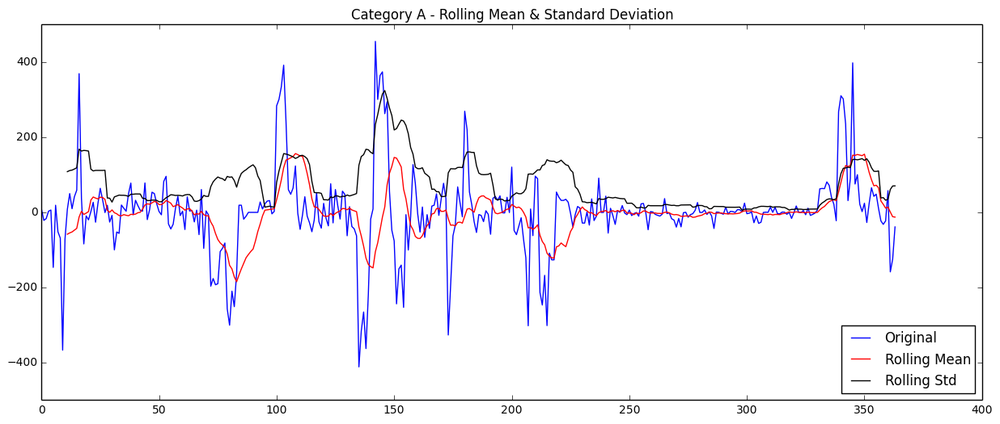

Results of Dickey-Fuller Test:
Test Statistic                  -4.970776
p-value                          0.000025
#Lags Used                      13.000000
Number of Observations Used    350.000000
Critical Value (5%)             -2.869833
Critical Value (1%)             -3.449173
Critical Value (10%)            -2.571188
dtype: float64


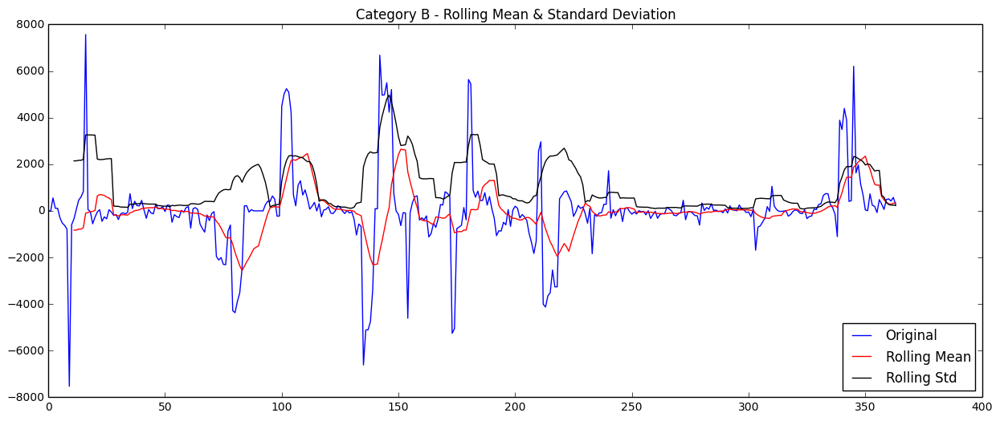

Results of Dickey-Fuller Test:
Test Statistic                  -4.303511
p-value                          0.000438
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


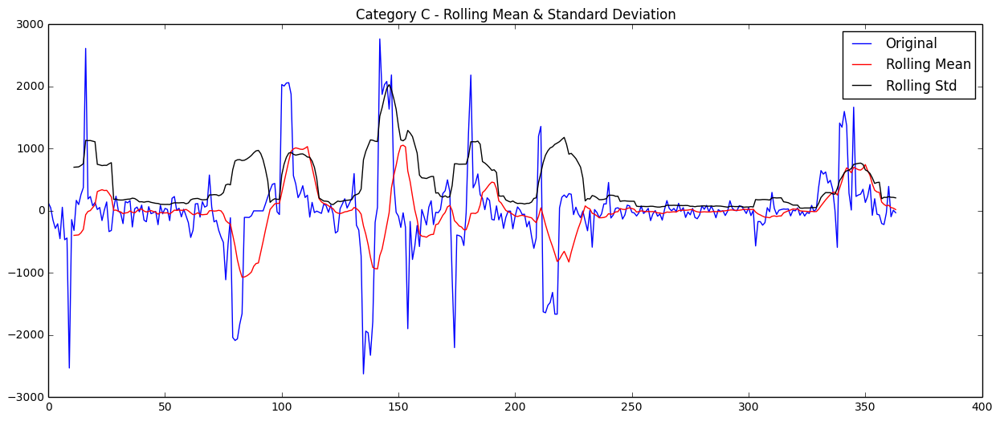

Results of Dickey-Fuller Test:
Test Statistic                  -4.259895
p-value                          0.000521
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


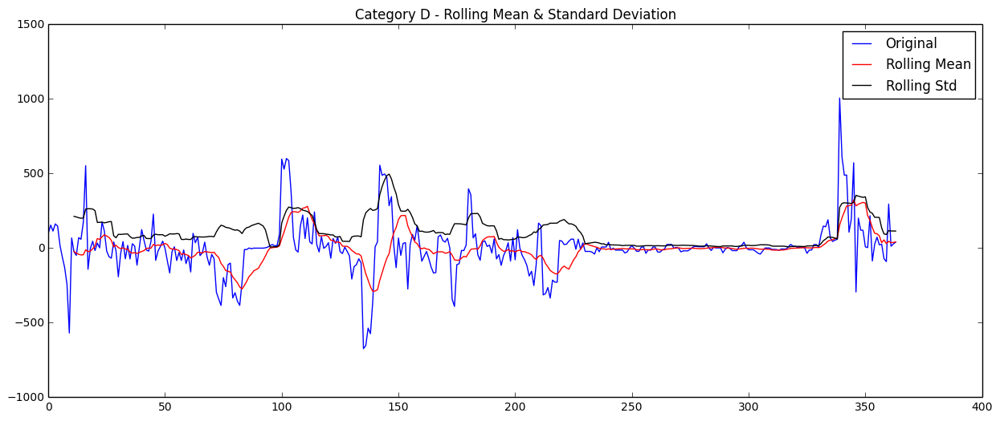

Results of Dickey-Fuller Test:
Test Statistic                  -4.020266
p-value                          0.001308
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


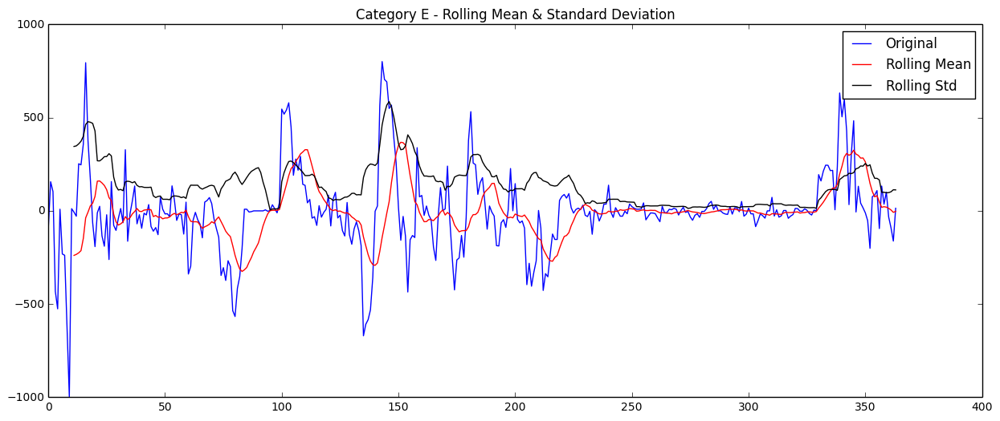

Results of Dickey-Fuller Test:
Test Statistic                  -3.969656
p-value                          0.001578
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


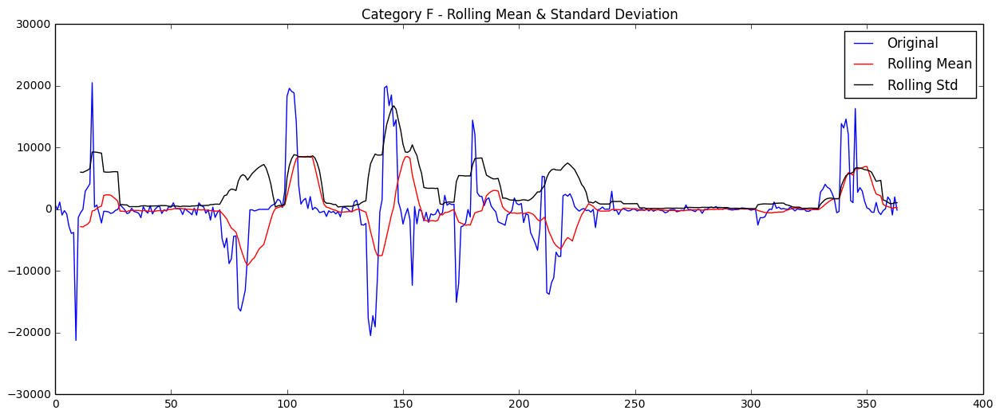

Results of Dickey-Fuller Test:
Test Statistic                  -4.424173
p-value                          0.000269
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


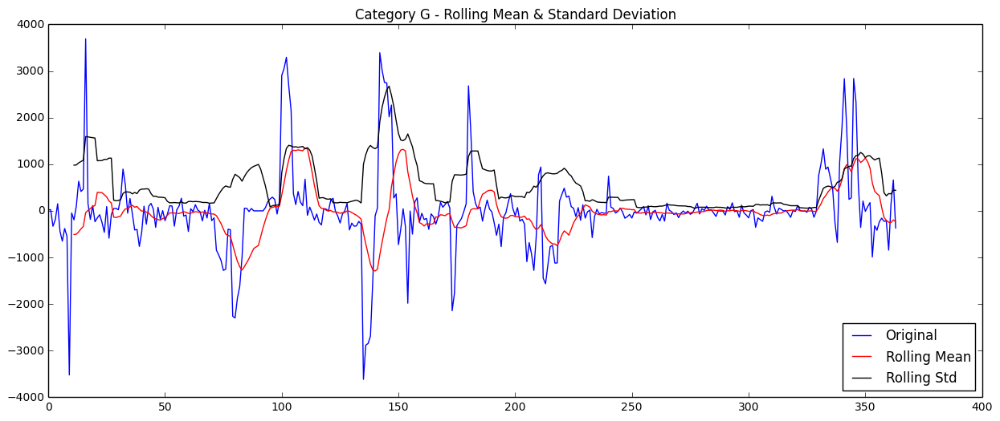

Results of Dickey-Fuller Test:
Test Statistic                  -4.216912
p-value                          0.000617
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


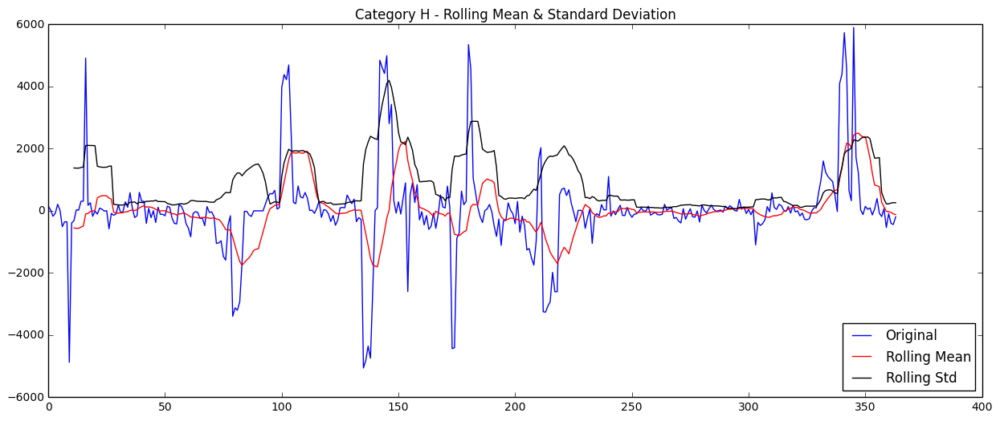

Results of Dickey-Fuller Test:
Test Statistic                  -4.215335
p-value                          0.000621
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


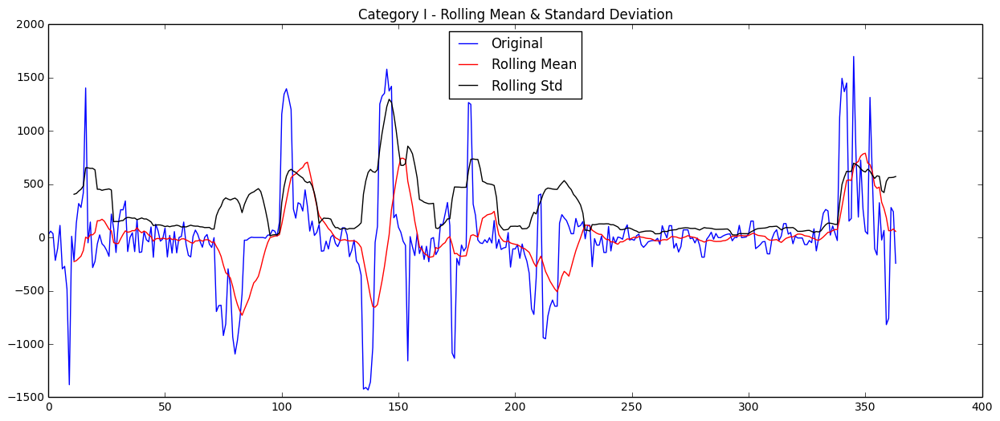

Results of Dickey-Fuller Test:
Test Statistic                  -4.168715
p-value                          0.000744
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


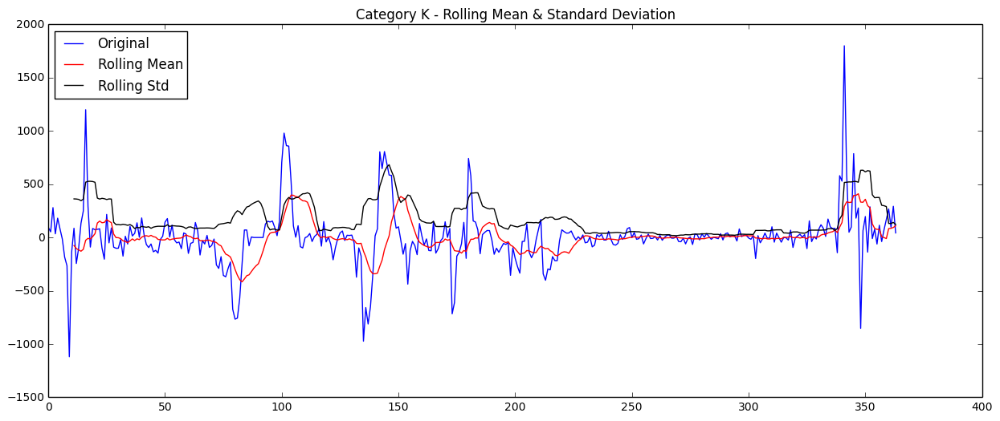

Results of Dickey-Fuller Test:
Test Statistic                  -4.300477
p-value                          0.000443
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


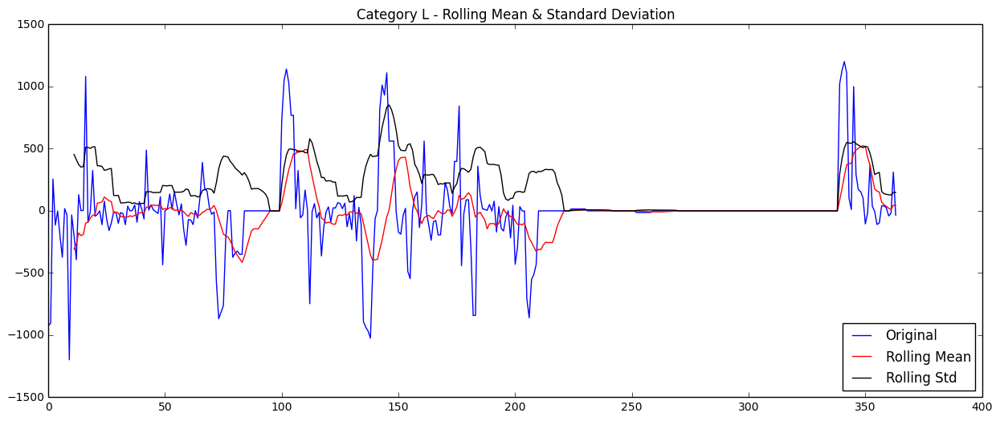

Results of Dickey-Fuller Test:
Test Statistic                -5.942833e+00
p-value                        2.239853e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


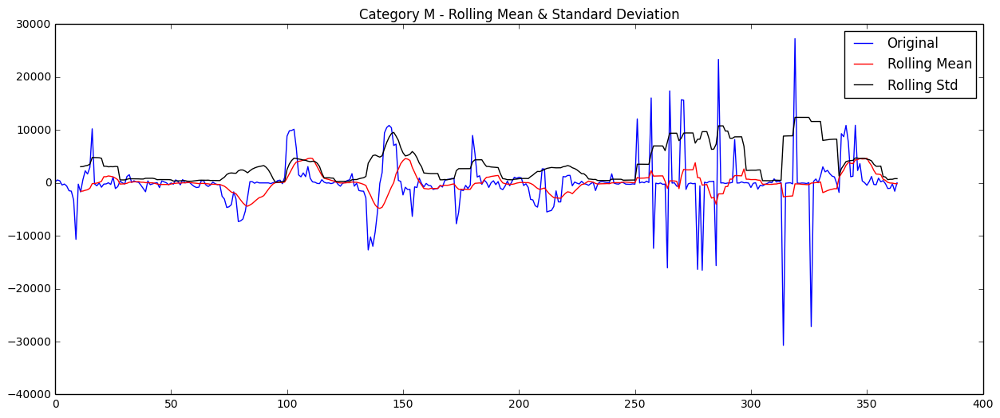

Results of Dickey-Fuller Test:
Test Statistic                  -5.087477
p-value                          0.000015
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


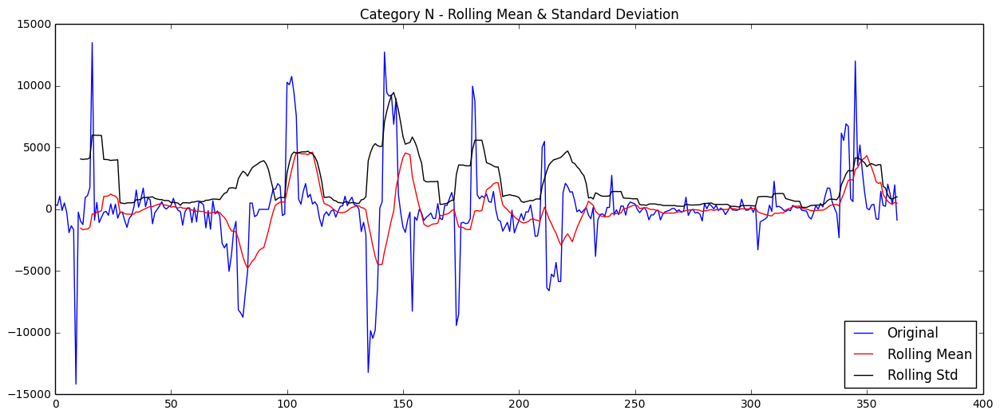

Results of Dickey-Fuller Test:
Test Statistic                -6.085152e+00
p-value                        1.068799e-07
#Lags Used                     7.000000e+00
Number of Observations Used    3.560000e+02
Critical Value (5%)           -2.869693e+00
Critical Value (1%)           -3.448853e+00
Critical Value (10%)          -2.571114e+00
dtype: float64


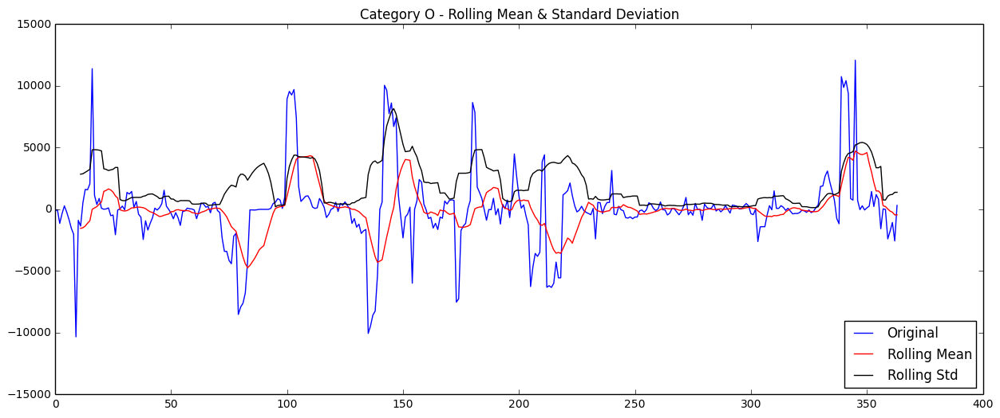

Results of Dickey-Fuller Test:
Test Statistic                  -4.303069
p-value                          0.000439
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


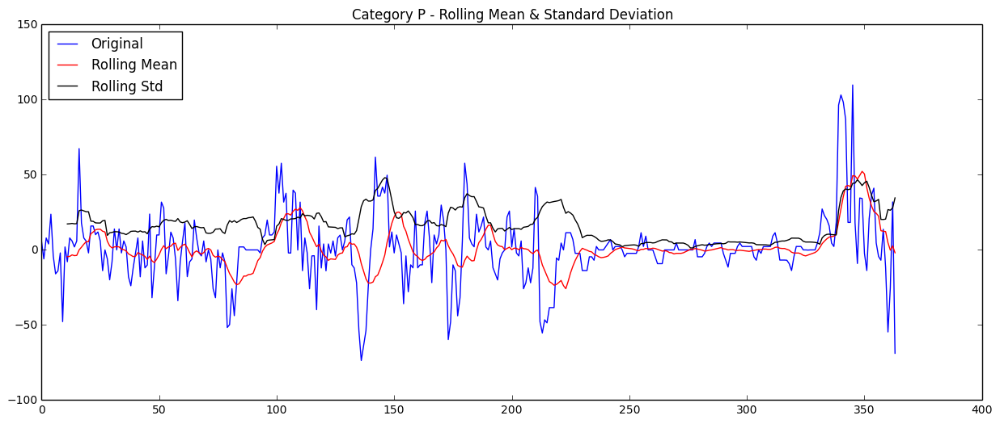

Results of Dickey-Fuller Test:
Test Statistic                  -4.120412
p-value                          0.000896
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


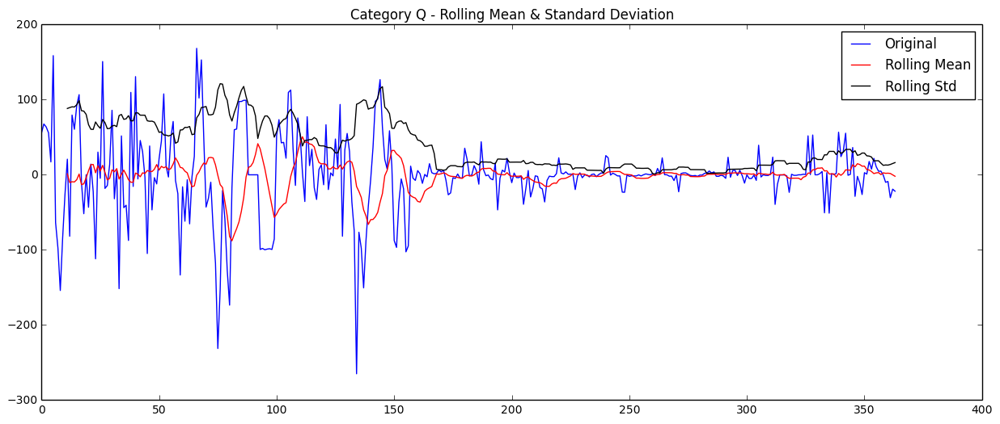

Results of Dickey-Fuller Test:
Test Statistic                -6.548572e+00
p-value                        8.969724e-09
#Lags Used                     1.400000e+01
Number of Observations Used    3.490000e+02
Critical Value (5%)           -2.869857e+00
Critical Value (1%)           -3.449227e+00
Critical Value (10%)          -2.571201e+00
dtype: float64


In [39]:
splitted_data_diff_season = map(lambda x: x - x.shift(7), splitted_data)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_diff_season)
_ = map(test_stationarity, splitted_data_diff_season, temp_list)

In [44]:
# See if inverse hyperbolic sine improved test statistics, or made it worse.

observed_stat = map(test_statistic, splitted_data)
season_stat = map(test_statistic, splitted_data_diff_season)
stat_diff_season = map(lambda x, y: x - y, observed_stat, season_stat)
for i, cat in enumerate(temp_list):
    print cat, ':', stat_diff_season[i]
print np.mean(stat_diff_season)

A : 2.77325989493
B : 2.00005327796
C : 2.05697510307
D : 1.8563072982
E : 1.95488845929
F : 2.20031958957
G : 1.92644437448
H : 2.04948412613
I : 1.85327844723
K : 2.35306400738
L : 3.74706667994
M : 2.47048181419
N : 3.79825151592
O : 1.67489009244
P : 1.53480747931
Q : 5.0701412818
2.45748209011


# 3.2) Now seasonal diff of logged data.

In [37]:
# Differencing to deal with seasonality...
# Log seasonal difference

splitted_data_log_diff_season = map(lambda x: x - x.shift(7), splitted_data_log)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_log_diff_season)

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


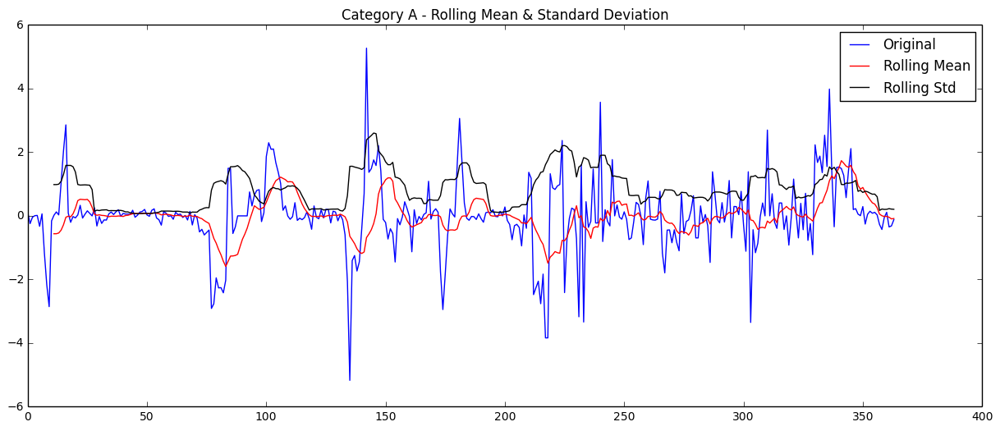

Results of Dickey-Fuller Test:
Test Statistic                  -4.305935
p-value                          0.000434
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


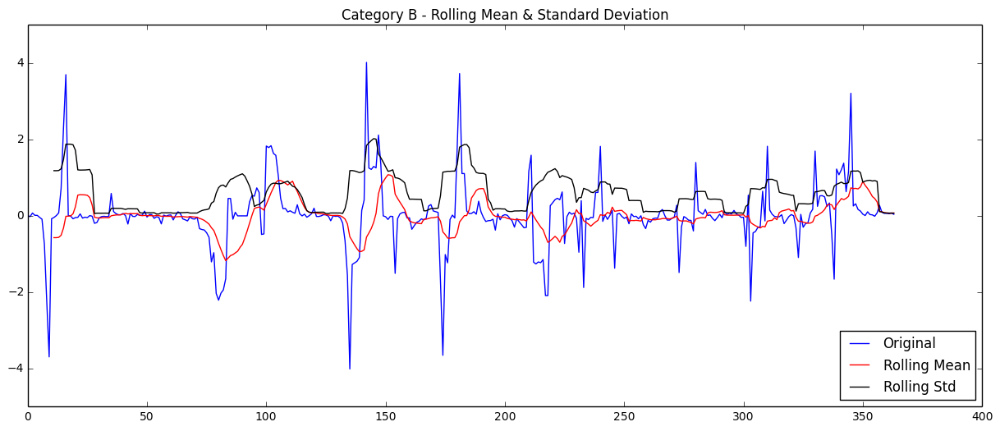

Results of Dickey-Fuller Test:
Test Statistic                  -4.683860
p-value                          0.000090
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


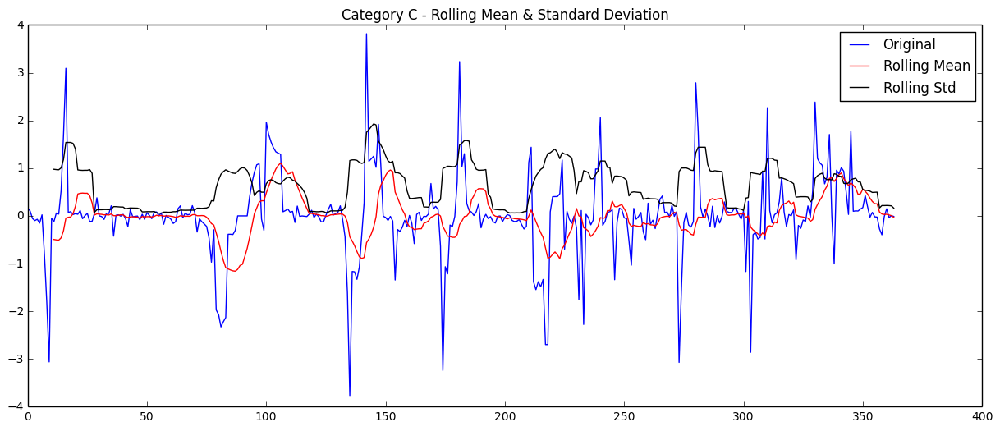

Results of Dickey-Fuller Test:
Test Statistic                  -4.651195
p-value                          0.000104
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


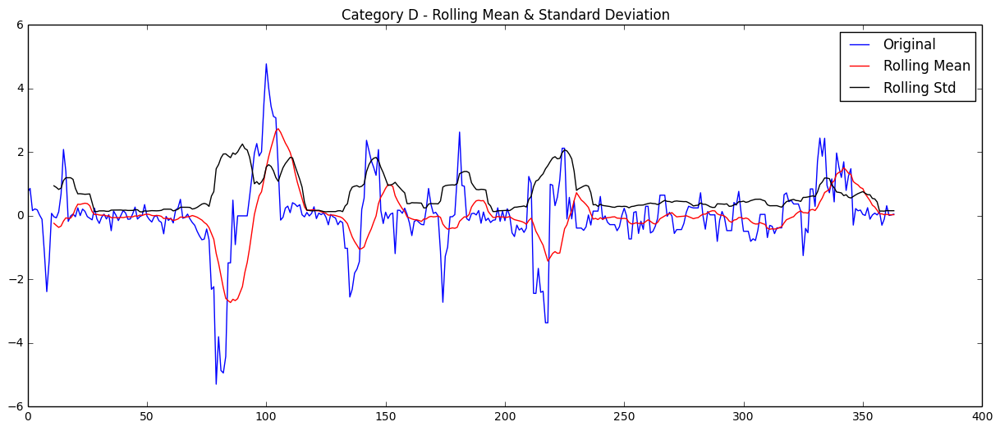

Results of Dickey-Fuller Test:
Test Statistic                  -5.112423
p-value                          0.000013
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


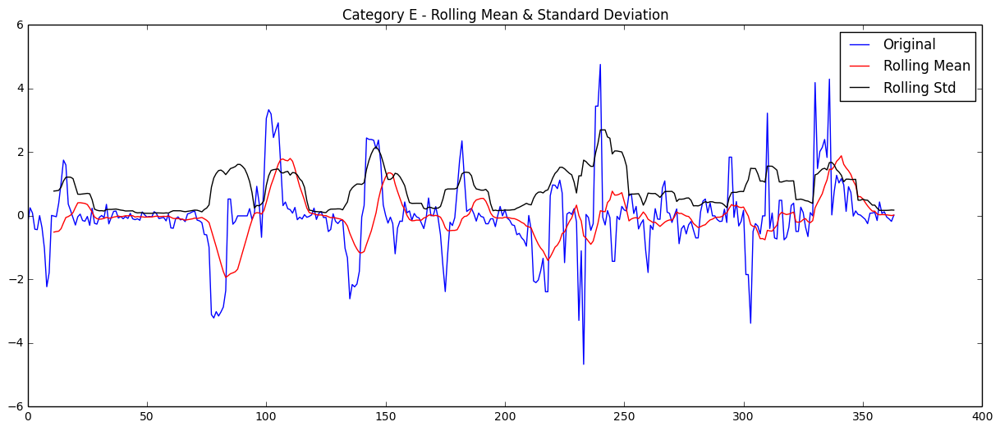

Results of Dickey-Fuller Test:
Test Statistic                  -4.159686
p-value                          0.000770
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


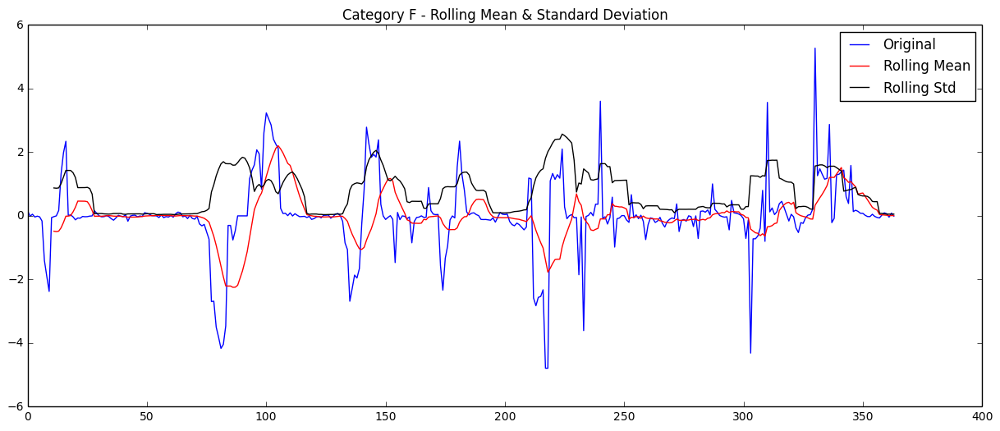

Results of Dickey-Fuller Test:
Test Statistic                  -4.223879
p-value                          0.000600
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


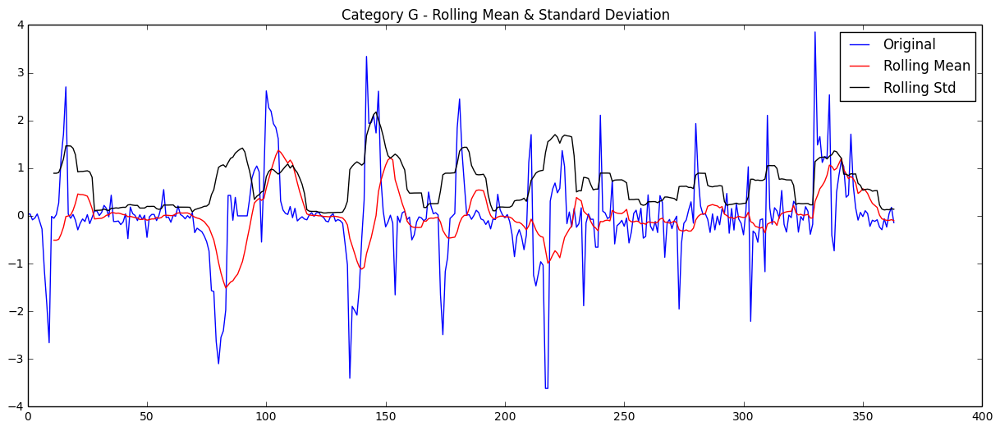

Results of Dickey-Fuller Test:
Test Statistic                  -4.499378
p-value                          0.000197
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


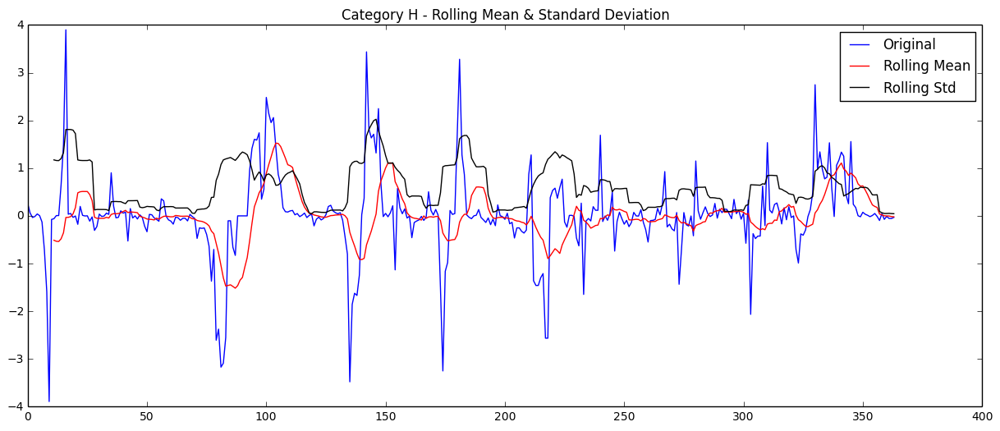

Results of Dickey-Fuller Test:
Test Statistic                  -4.477188
p-value                          0.000216
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


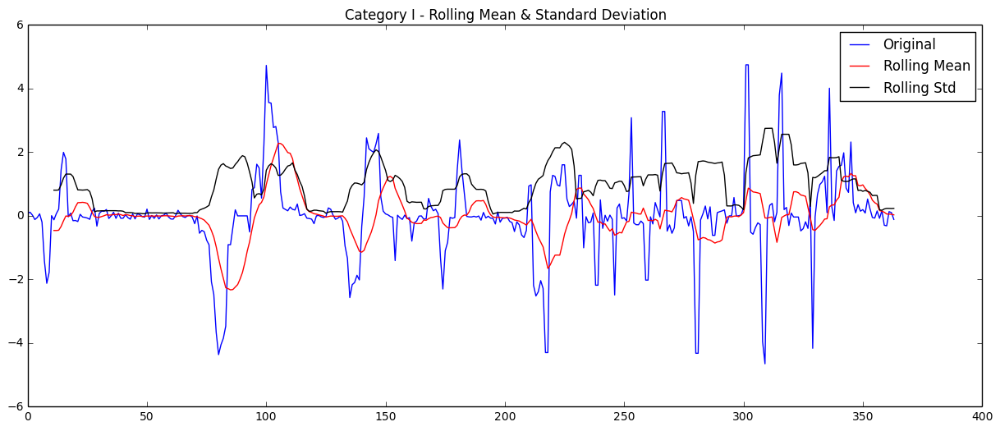

Results of Dickey-Fuller Test:
Test Statistic                  -4.720572
p-value                          0.000077
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


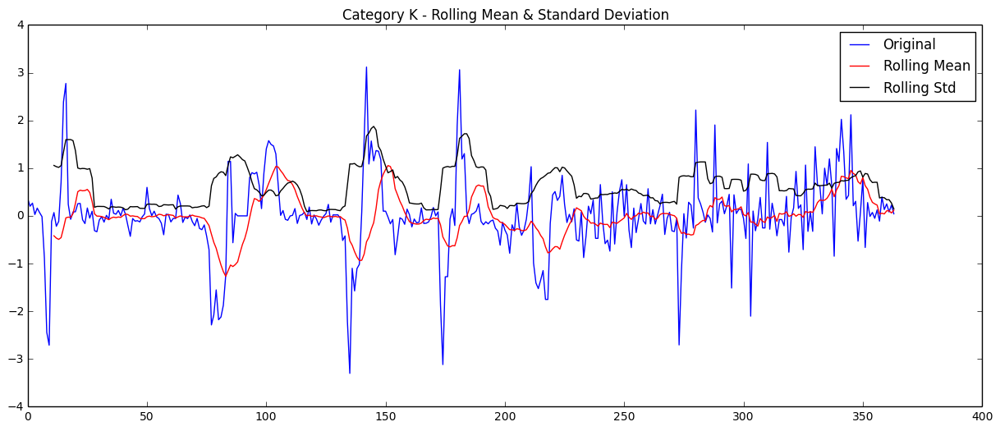

Results of Dickey-Fuller Test:
Test Statistic                  -4.165383
p-value                          0.000754
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


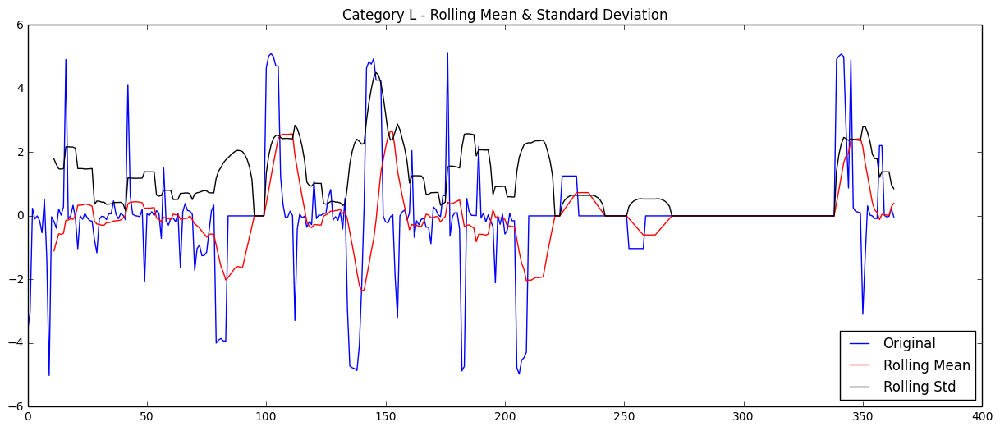

Results of Dickey-Fuller Test:
Test Statistic                  -4.665994
p-value                          0.000097
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


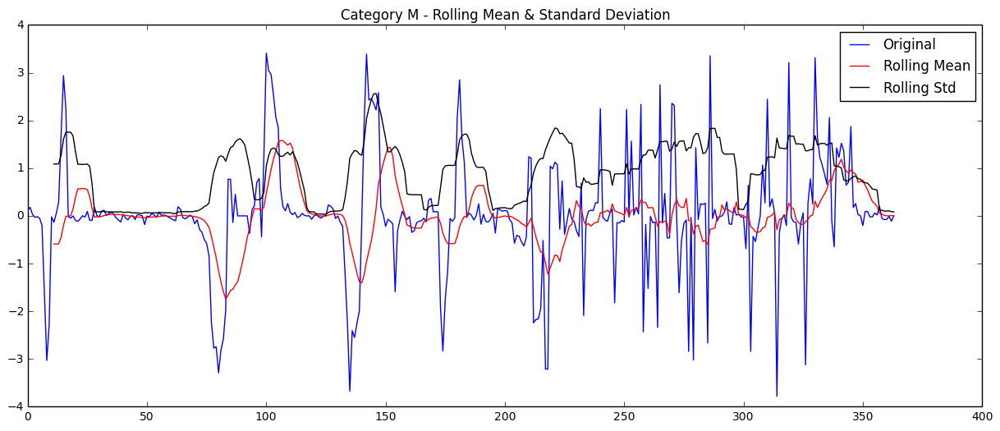

Results of Dickey-Fuller Test:
Test Statistic                  -4.534256
p-value                          0.000170
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


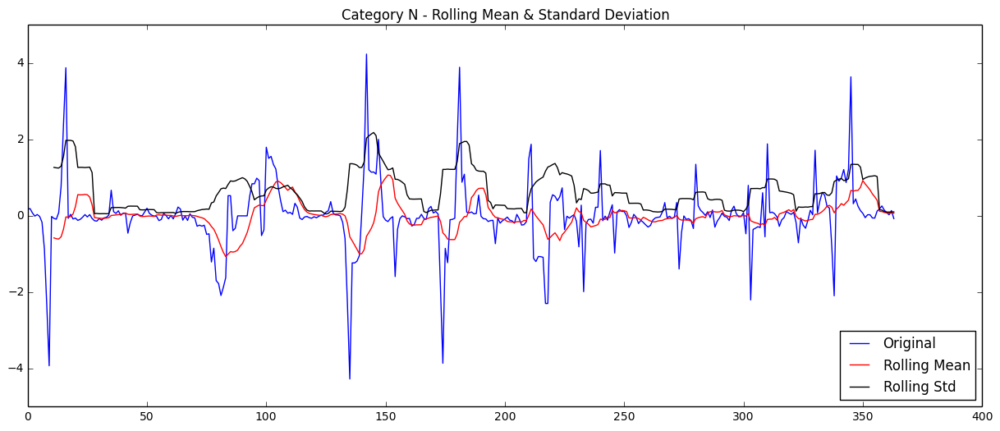

Results of Dickey-Fuller Test:
Test Statistic                  -5.026236
p-value                          0.000020
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


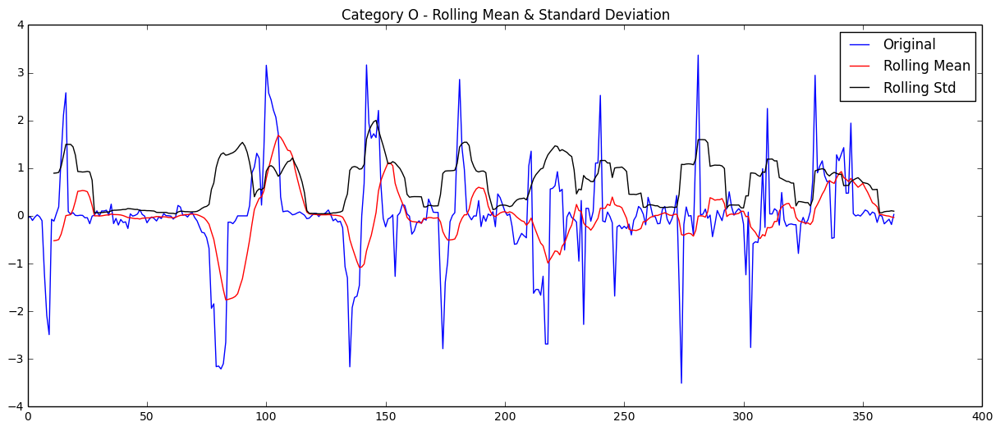

Results of Dickey-Fuller Test:
Test Statistic                  -4.447607
p-value                          0.000244
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


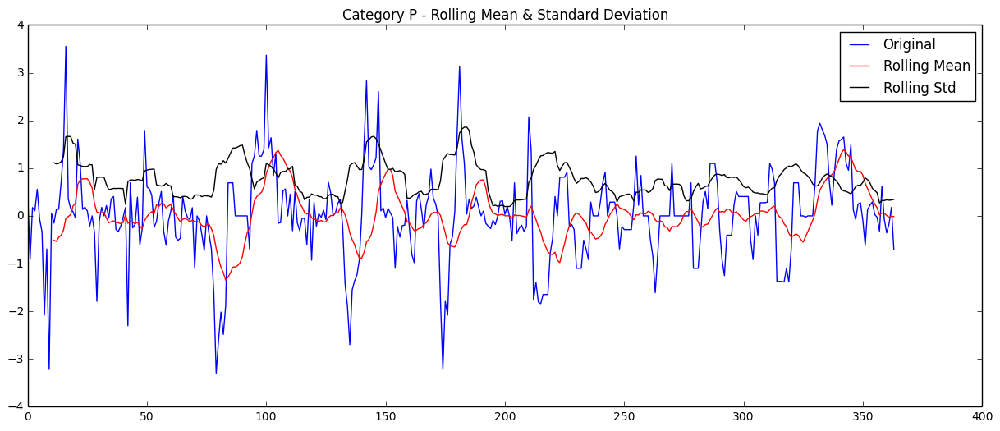

Results of Dickey-Fuller Test:
Test Statistic                  -4.271934
p-value                          0.000497
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


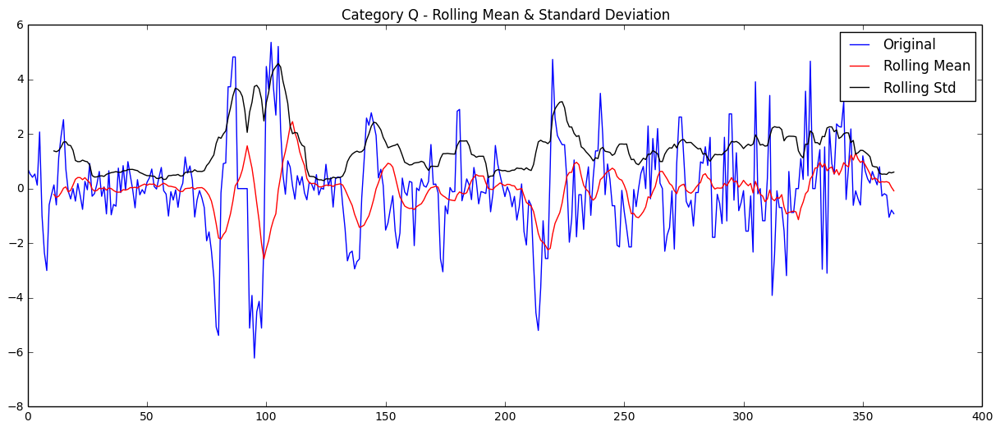

Results of Dickey-Fuller Test:
Test Statistic                  -5.050643
p-value                          0.000018
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


In [38]:
# Let's see the Dickey-Fuller test after taking the log, diff, & season diff...

_ = map(test_stationarity, splitted_data_log_diff_season, temp_list)

In [46]:
# See if inverse hyperbolic sine improved test statistics, or made it worse.

observed_stat = map(test_statistic, splitted_data)
season_log_stat = map(test_statistic, splitted_data_log_diff_season)
stat_log_diff_season = map(lambda x, y: x - y, observed_stat, season_log_stat)
for i, cat in enumerate(temp_list):
    print cat, ':', stat_log_diff_season[i]
print np.mean(stat_log_diff_season)

A : 2.10841933618
B : 2.38040198582
C : 2.44827461016
D : 2.94846409714
E : 2.1449181424
F : 2.00002530047
G : 2.20891013095
H : 2.31133684049
I : 2.40513570734
K : 2.21797001438
L : 2.47022841165
M : 1.91726109954
N : 2.73933565794
O : 1.81942798424
P : 1.68632956981
Q : 3.57221229941
2.33616569924


# 3.3) Seasonal diff of inverse hyperbolic data

/Library/Python/2.7/site-packages/ipykernel/__main__.py:6: FutureWarning: pd.rolling_mean is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).mean()
/Library/Python/2.7/site-packages/ipykernel/__main__.py:7: FutureWarning: pd.rolling_std is deprecated for Series and will be removed in a future version, replace with 
	Series.rolling(window=12,center=False).std()


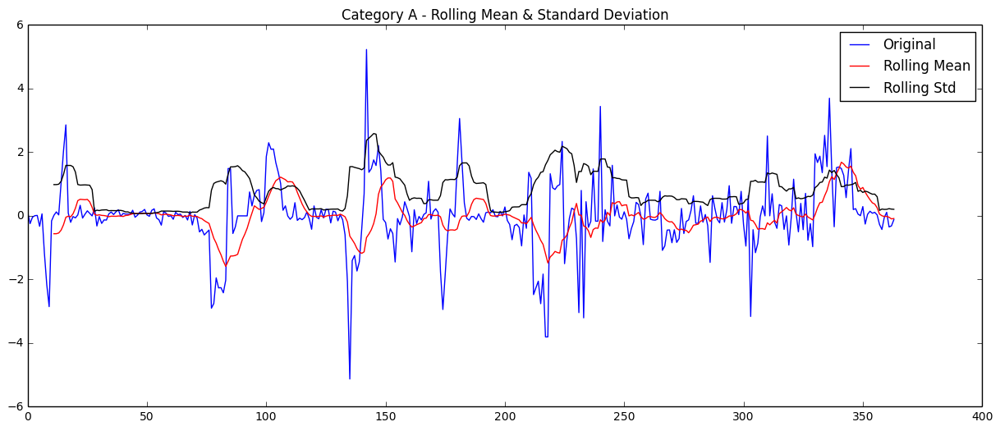

Results of Dickey-Fuller Test:
Test Statistic                  -4.231874
p-value                          0.000582
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


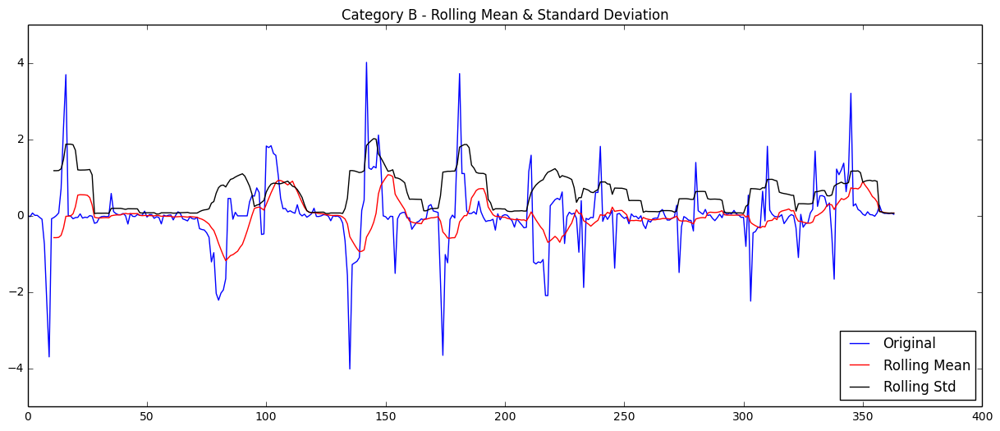

Results of Dickey-Fuller Test:
Test Statistic                  -4.683858
p-value                          0.000090
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


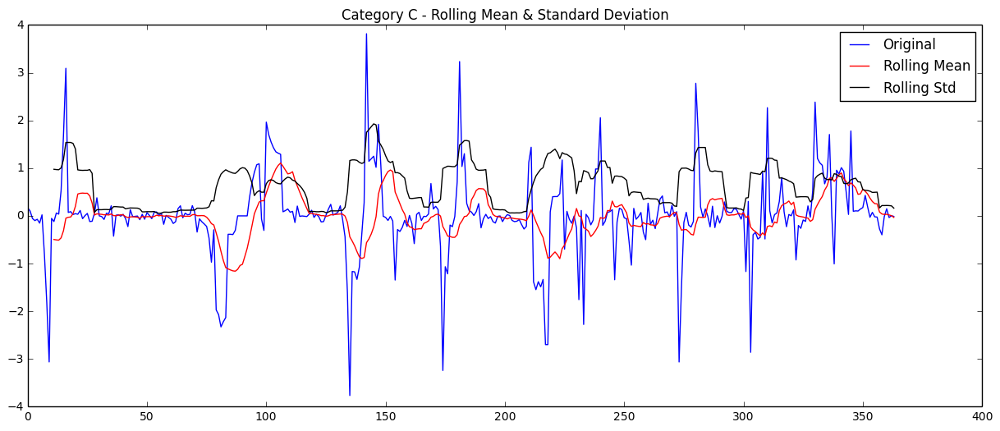

Results of Dickey-Fuller Test:
Test Statistic                  -4.650898
p-value                          0.000104
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


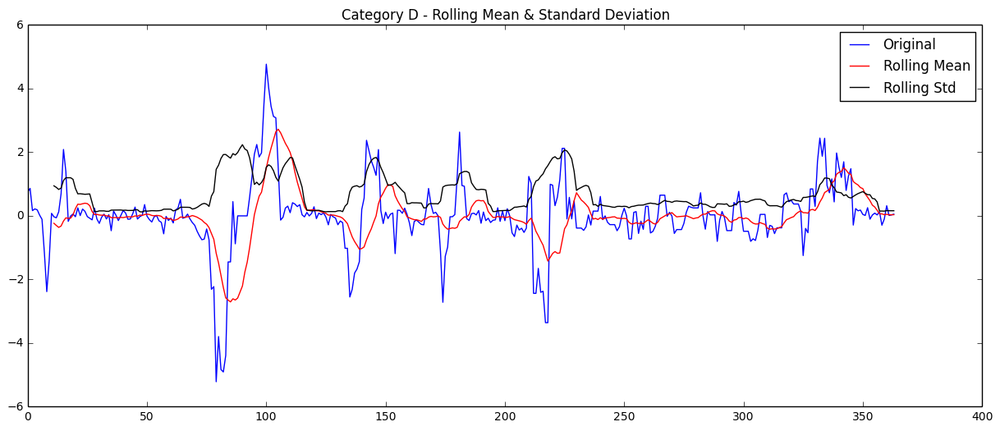

Results of Dickey-Fuller Test:
Test Statistic                  -5.110400
p-value                          0.000013
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


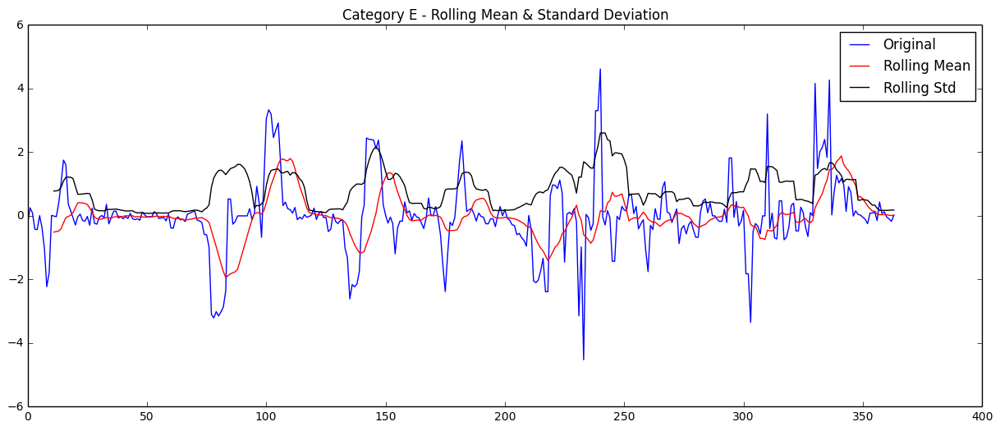

Results of Dickey-Fuller Test:
Test Statistic                  -4.161278
p-value                          0.000766
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


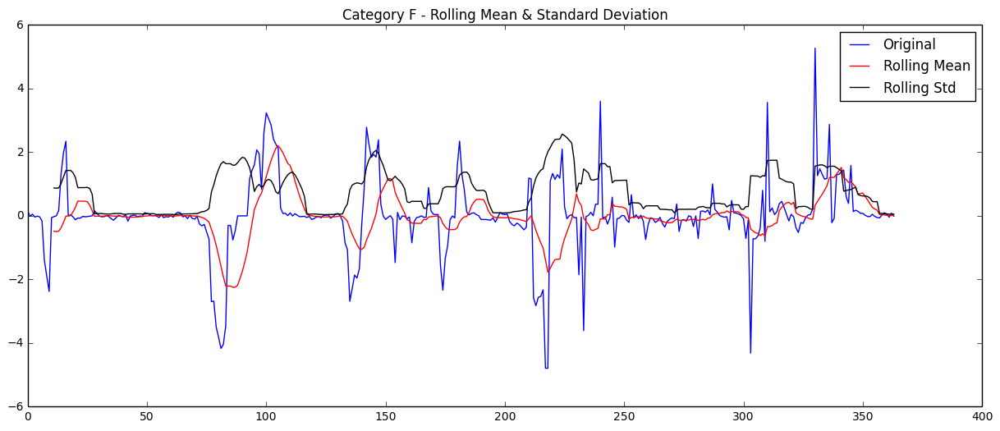

Results of Dickey-Fuller Test:
Test Statistic                  -4.223754
p-value                          0.000600
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


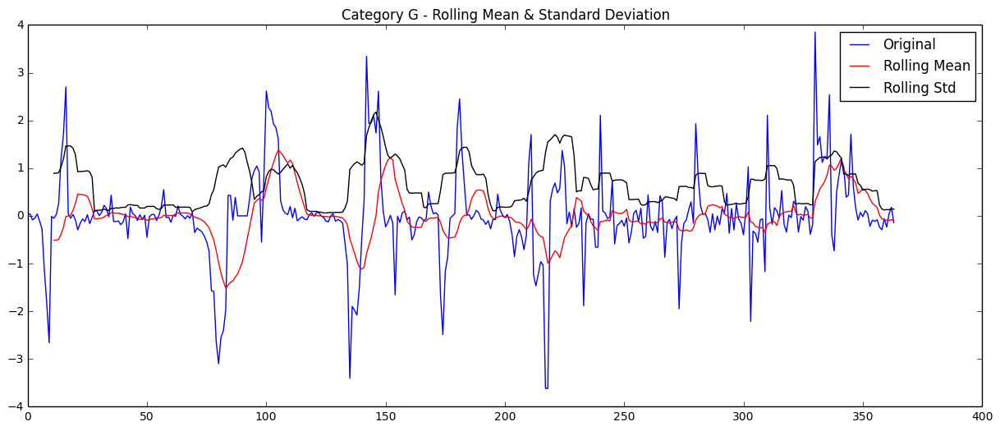

Results of Dickey-Fuller Test:
Test Statistic                  -4.499538
p-value                          0.000197
#Lags Used                      17.000000
Number of Observations Used    346.000000
Critical Value (5%)             -2.869930
Critical Value (1%)             -3.449392
Critical Value (10%)            -2.571240
dtype: float64


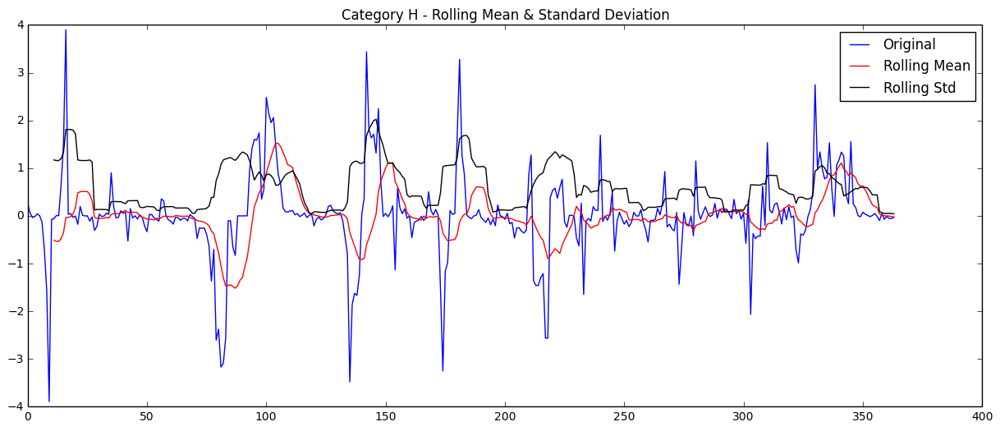

Results of Dickey-Fuller Test:
Test Statistic                  -4.477177
p-value                          0.000216
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


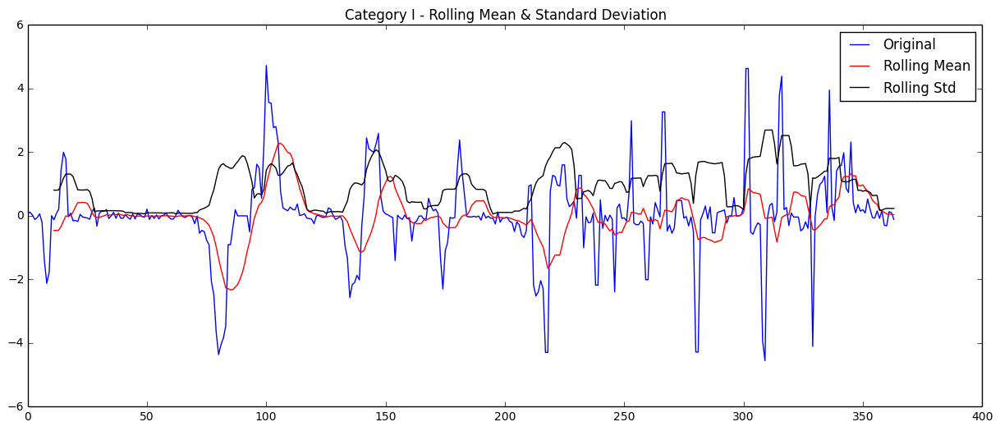

Results of Dickey-Fuller Test:
Test Statistic                  -4.708239
p-value                          0.000081
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


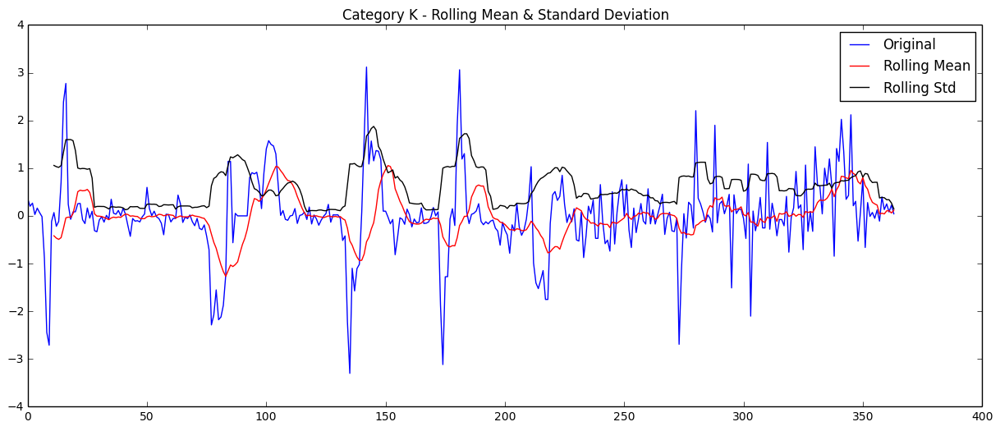

Results of Dickey-Fuller Test:
Test Statistic                  -4.164445
p-value                          0.000756
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


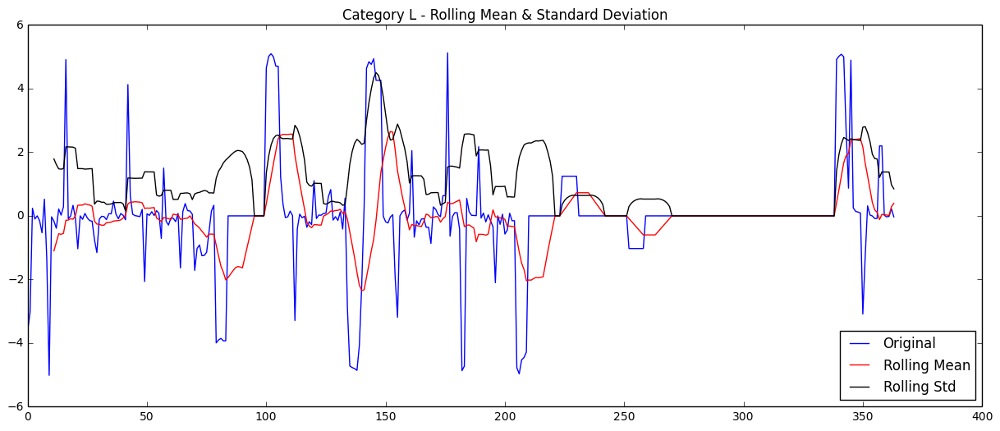

Results of Dickey-Fuller Test:
Test Statistic                  -4.666349
p-value                          0.000097
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


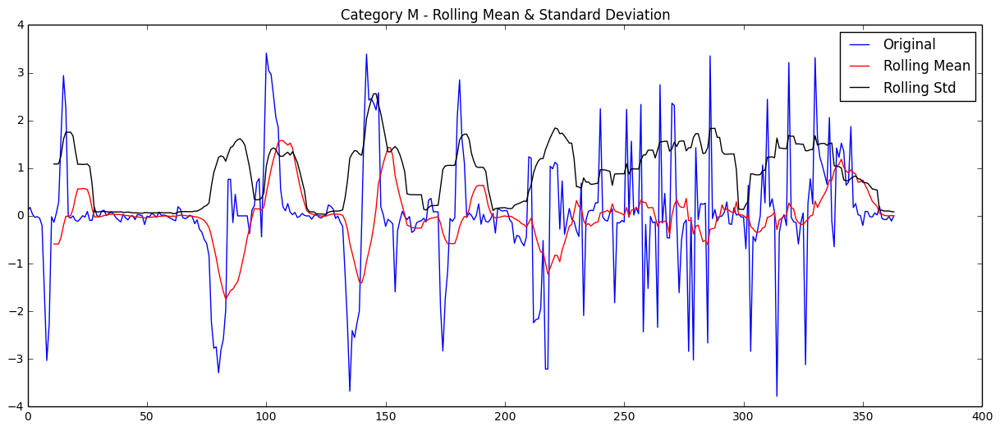

Results of Dickey-Fuller Test:
Test Statistic                  -4.534245
p-value                          0.000170
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


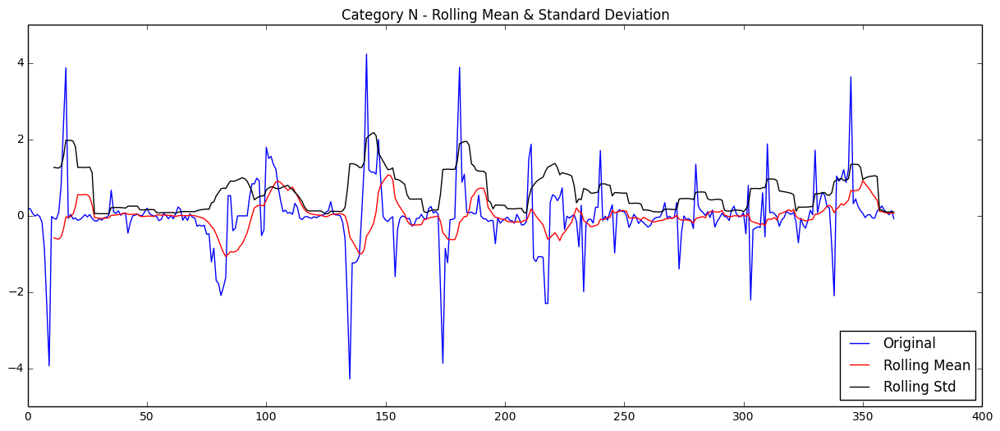

Results of Dickey-Fuller Test:
Test Statistic                  -5.026236
p-value                          0.000020
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64


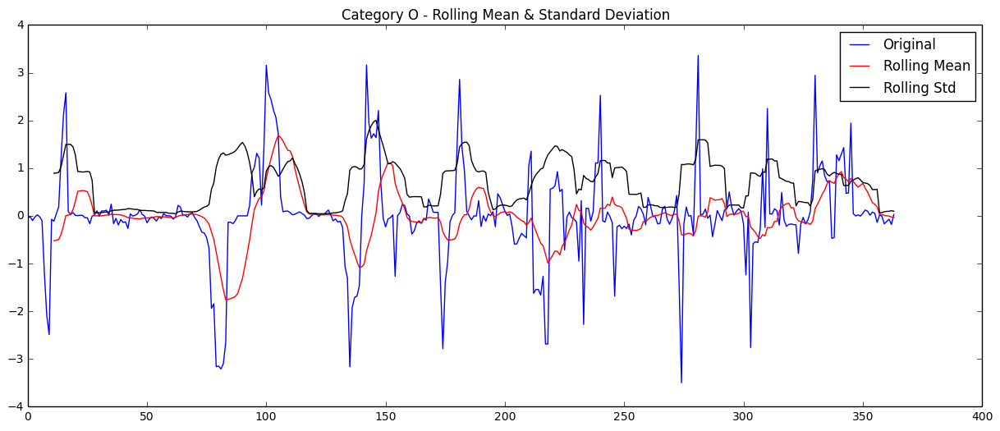

Results of Dickey-Fuller Test:
Test Statistic                  -4.447847
p-value                          0.000244
#Lags Used                      16.000000
Number of Observations Used    347.000000
Critical Value (5%)             -2.869906
Critical Value (1%)             -3.449337
Critical Value (10%)            -2.571227
dtype: float64


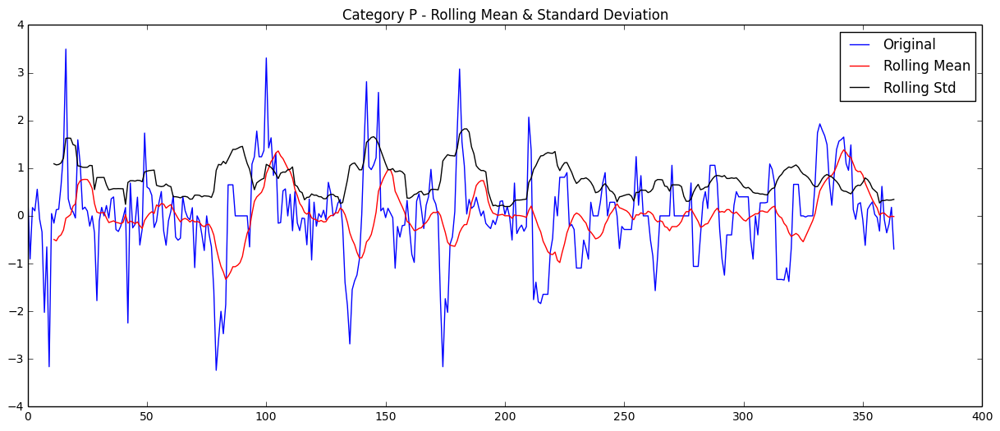

Results of Dickey-Fuller Test:
Test Statistic                  -4.271459
p-value                          0.000498
#Lags Used                      15.000000
Number of Observations Used    348.000000
Critical Value (5%)             -2.869881
Critical Value (1%)             -3.449282
Critical Value (10%)            -2.571214
dtype: float64


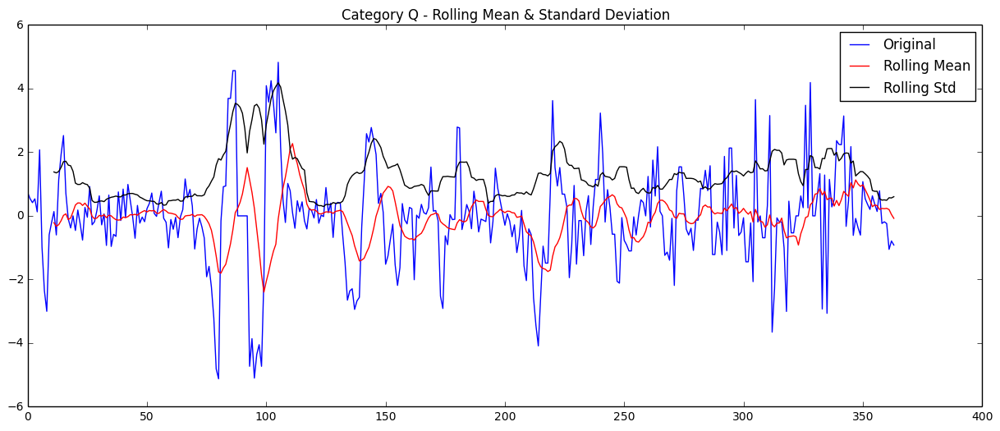

Results of Dickey-Fuller Test:
Test Statistic                  -5.288400
p-value                          0.000006
#Lags Used                      14.000000
Number of Observations Used    349.000000
Critical Value (5%)             -2.869857
Critical Value (1%)             -3.449227
Critical Value (10%)            -2.571201
dtype: float64
A : 2.77325989493
B : 2.00005327796
C : 2.05697510307
D : 1.8563072982
E : 1.95488845929
F : 2.20031958957
G : 1.92644437448
H : 2.04948412613
I : 1.85327844723
K : 2.35306400738
L : 3.74706667994
M : 2.47048181419
N : 3.79825151592
O : 1.67489009244
P : 1.53480747931
Q : 5.0701412818
2.34552985809


In [47]:
splitted_data_inversed_diff_season = map(lambda x: x - x.shift(7), splitted_data_inversed)
_ = map(lambda x: x.dropna(inplace=True), splitted_data_inversed_diff_season)
_ = map(test_stationarity, splitted_data_inversed_diff_season, temp_list)


# See if inverse hyperbolic sine improved test statistics, or made it worse.

observed_stat = map(test_statistic, splitted_data)
inversed_season_stat = map(test_statistic, splitted_data_inversed_diff_season)
stat_diff_inversed_season = map(lambda x, y: x - y, observed_stat, inversed_season_stat)
for i, cat in enumerate(temp_list):
    print cat, ':', stat_diff_season[i]
print np.mean(stat_diff_inversed_season)

### All the test statistics look really good.
### Next step is to visualize the ACF/PACF plots to determine we will use MA, AR, or ARIMA model.

# Step 3.2) ACF/PACF Plots for
## - Observed data
## - Log transformed data
## - Diff Log transformed data
## - Seasonal Diff Log transformed data

In [ ]:
def acf_pacf_plot(timeseries, title, item, lags=30):
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(timeseries, lags=lags, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(timeseries, lags=lags, ax=ax2)
    fig.suptitle('Category {} - {} ACF/PACF Plot'.format(item, title), fontsize=20)

In [ ]:
# Observed data ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data, ['Observed Data']*16, temp_list)

## We observe the following:
### - A), B), C), D), E), F), G), H), I), K), L), M), N), O), P) Both tails off
### - Q) PACF cuts off at 1, probably AR(1) model...

In [ ]:
# Let's see the log transformed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log, ['Log']*16, temp_list)

## We observe these:
### A), D), E), F), G), H), I), L), P) both tail
### B), C), K), M), N), O), Q) PACF cut 1
### Some cut offs are not clear...possibly AR(1)?

In [ ]:
# Finally, let's see the Season Diff Log transformed ACF/PACF plot.

_ = map(acf_pacf_plot, splitted_data_log_diff_season, ['Season Diff Log']*len(temp_list), temp_list, [range(0, 182, 7)]*16)

### We observed:
### All - ACF cut 1...SMA(1)? -> SARIMA(0, 1, 1)?
### Some are rather not clear
### No worries, we will use grid search to help us find the optimized model!

# Step 4) Model Building
### - At this point we are sure we need MA and SMA models.
### - The AR and SAR models are uncertain.
### - The difference is 1 in both normal and seasonal lag.
### - We will use grid search to find out the AR & SAR order.

In [49]:
# We will use this function to help us search the best p & q values, and seasonal P & Q values.
# Four for loops is a lot, but we will be using it mostly for 1 or 2 values in each p, q, P & Q values.
# Because we already have a good idea these values won't be more than 2.

def evaluate_models(dataset, p_values, q_values, P_values, Q_values):
    best_score, best_cfg, best_season = float("inf"), None, None
    for p in p_values:
        for q in q_values:
            for P in P_values:
                for Q in Q_values:
                    order = (p,0,q)
                    season_order = (P, 1, Q, 7)
                    try:
                        mod = sm.tsa.statespace.SARIMAX(dataset, trend='n', order=order, \
                                                           seasonal_order=season_order)
                        result = mod.fit()
                        aic = result.aic
                        if aic < best_score:
                            best_score, best_cfg, best_season = aic, order, season_order
                        print('SARIMA%s %s AIC=%.3f' % (order, season_order, aic))
                    except Exception as e:
                        print e
                        continue

    print('Best SARIMA%s %s AIC=%.3f' % (best_cfg, best_season, best_score))
    return [best_cfg, best_season]

In [50]:
def model_building(timeseries, item, p=range(0, 3), q=range(0, 3), P=range(0, 3), Q=range(0, 3)):
    orders = evaluate_models(timeseries, p, q, P, Q)
    mod = sm.tsa.statespace.SARIMAX(timeseries, trend='n', order=orders[0], seasonal_order=orders[1])
    results = mod.fit()
    
    print 'Category {}: '.format(item), results_1.summary()
    return results

In [51]:
results_obs = map(model_building, splitted_data, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=4431.030
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=4432.824
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=4431.094
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=4433.084
SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=4434.206
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=4433.092
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=4417.669


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=4418.002
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=4307.639
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4270.456
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4269.368
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4276.642
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4261.668
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4261.699
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4276.302
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4258.089


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
/Library/Python/2.7/site-packages/statsmodels/tsa/statespace/tools.py:405: RuntimeWarning: invalid value encountered in sqrt
  x = r / ((1 - r**2)**0.5)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4263.160
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4241.692
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4173.988
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4171.359
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4192.600
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4167.442
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4167.878
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4186.739
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4166.124
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4165.530
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4241.415
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4175.021
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4172.629
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4191.984
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4168.539
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4168

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4167.053
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=4241.252
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4175.168
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4172.737
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=4192.171
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4168.654
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4168.995
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=4187.335
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4166.708


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4166.372
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=4243.252
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=4174.250
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4171.325
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4193.949
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4167.342
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4167.934
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4188.475


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4166.619


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4165.704
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4244.963


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4178.259
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4174.118
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4194.153


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4170.563


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4170.726


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4190.094


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4168.139


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4168.259
Best SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4165.530
Category A:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 2, 7)   Log Likelihood               -2076.765
Date:                           Sun, 26 Feb 2017   AIC                           4165.530
Time:                                   21:07:38   BIC                           4189.028
Sample:                               09-26-2015   HQIC                          4174.863
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.738

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6283.116
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6264.118
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6216.243
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6208.471
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6230.663
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6194.904
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6196.050
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6224.540
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6192.495


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6203.634
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6265.755
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6218.077
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6210.442
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6233.856
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6197.515
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6197.861
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6226.356
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6194.204


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6205.785
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6267.759
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6217.611
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6208.575
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6235.935
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6196.801


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6204.164
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6227.045
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6194.365


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6207.219
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6265.766
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6218.108
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6210.448
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6233.740
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6196.756
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6197.895
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6228.645
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6194.255


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6205.457
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=6267.754
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6217.064
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6206.309
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=6233.937


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6196.471


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6201.561
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=6227.131


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6201.942


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6204.733
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=6265.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6217.390


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=6205.362


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=6235.605


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=6204.784


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=6206.332
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=6229.032


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6205.036


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6207.964
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6192.495
Category B:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3091.247
Date:                           Sun, 26 Feb 2017   AIC                           6192.495
Time:                                   21:09:14   BIC                           6212.076
Sample:                               09-26-2015   HQIC                          6200.272
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.686

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5750.985
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5640.882
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=5604.916
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=5595.788
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=5616.657
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=5588.146
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=5589.223
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=5608.978
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=5588.829


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5604.233
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5564.190
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=5492.443
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=5482.055
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5522.601
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5478.508
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=5479.947
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=5507.487
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=5479.565
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=5481.534
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5565.074
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=5492.321
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=5482.788
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5521.784
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=5478.999
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=5480

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=5486.157
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5566.558
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=5492.834
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=5483.187
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5523.705
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5479.969


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=5481.386
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5509.502
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5480.894


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=5488.372
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5564.941
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=5492.616
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=5482.983
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5521.735
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=5479.196
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=5480.527
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5507.723
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=5479.933


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=5487.894
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=5566.878
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=5491.195


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=5486.712
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=5523.733


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=5482.696


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=5486.102


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=5509.520


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=5485.532


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=5493.118
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5478.508
Category C:                           

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=4786.841
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=4668.388
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4657.684
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4653.578
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4660.551
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4641.962
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4643.878
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4657.658
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4642.991


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4645.088
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4605.765
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4565.591
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4556.080
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4581.523
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4553.080
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4554.551
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4567.576
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4554.305
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4556.243
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4602.336
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4562.832
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4554.997
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4576.947
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4551.462
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4552

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4550.220
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4566.353


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4550.242


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4552.137
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4605.103
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4563.634


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4553.791
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4578.363
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4552.675


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4552.663
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4567.074


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4553.704


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4555.689
Best SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4548.611
Category D:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 7)   Log Likelihood               -2268.306
Date:                           Sun, 26 Feb 2017   AIC                           4548.611
Time:                                   21:11:42   BIC                           4572.108
Sample:                               09-26-2015   HQIC                          4557.943
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.513

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=4926.522
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=4761.591
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4728.842
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4728.291
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4735.075
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4725.993
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4726.145
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4733.316
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4723.069


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4724.872
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4661.278
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4552.189
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4552.838
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4589.257
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4552.466
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4553.940
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4575.045
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4551.868
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4553.813
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4662.828
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4554.116
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4554.801
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4589.795
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4554.432
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4555

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4553.899
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4593.061
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4553.458


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4554.993
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4577.060


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4553.094


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4555.773
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4666.158


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4556.488


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4556.474


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4590.893


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4555.759


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4557.569
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4577.966


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4554.887


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4557.293
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4551.868
Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -2270.934
Date:                           Sun, 26 Feb 2017   AIC                           4551.868
Time:                                   21:12:58   BIC                           4571.449
Sample:                               09-26-2015   HQIC                          4559.645
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.848

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=7085.405
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=7018.420
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6974.026
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6966.422
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6989.651
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6954.201
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6955.360
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6980.027
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6952.753


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6961.302
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=7020.184
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6973.138
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6967.504
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6991.640
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6961.241


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6956.636
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6981.488
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6961.236


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6963.308
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=7021.833
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6977.080
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6969.008
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6993.854
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6963.273


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6958.250
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6983.437
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6955.684


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6965.404
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=7020.204
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6975.427
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6967.424
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6991.535
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6961.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6956.681
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6981.384
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6960.983


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6963.053
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=7015.723
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6979.127
S

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6963.857


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6966.606
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6952.753
Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3471.376
Date:                           Sun, 26 Feb 2017   AIC                           6952.753
Time:                                   21:14:04   BIC                           6972.334
Sample:                               09-26-2015   HQIC                          6960.530
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.757

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5918.768
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5793.801
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=5768.328
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=5757.420
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=5777.211
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=5748.302
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=5748.944
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=5768.591
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=5748.144


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5764.731
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5726.681
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=5677.782
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=5664.102
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5699.018
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5658.955
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=5660.507
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=5683.048
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=5660.318


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=5662.262
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5728.609
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=5679.776
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=5665.890
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5701.000
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=5660.884
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=5662.455
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=5684.960
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=5663.840


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=5670.448
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5730.636
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=5680.304
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=5666.655
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5702.804
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5662.023


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=5663.587
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5686.285
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5663.415


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=5672.785
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5728.600
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=5679.777
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=5665.919
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5701.001
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=5660.893
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=5662.461
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5684.970


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=5662.289


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=5669.219
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=5726.511


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=5680.020


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=5665.177


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=5703.187


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=5663.792


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=5672.109


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=5690.820


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=5671.919


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=5673.868
Best SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5658.955
Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(1, 1, 1, 7)   Log Likelihood               -2825.477
Date:                           Sun, 26 Feb 2017   AIC                           5658.955
Time:                                   21:15:22   BIC                           5674.620
Sample:                               09-26-2015   HQIC                          5665.177
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.727

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=6291.434
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=6155.424
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=6136.528
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=6134.053
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=6140.828
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=6114.376
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=6116.343
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=6138.548
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=6114.879


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6134.373
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6093.226
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6052.627
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6046.247
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6066.818


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6030.903
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6032.763
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6058.370
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6029.732


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6040.035
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6095.170
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6054.526
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6047.906
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6069.052
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6032.698
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6034.562
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6060.225


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6031.619


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6042.548
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6097.120
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6053.922
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6046.823
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6070.614


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6032.604
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6034.424
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6060.639


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6031.223


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6043.346
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6095.170
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6054.545
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6047.975
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6068.893
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6032.734
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6034.598
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6062.243
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6031.639


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6042.153
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=6098.233
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6055.960


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=6044.363
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=6071.782


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=6034.310


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=6044.123


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=6062.471


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6031.190


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6045.186
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6029.732
Category H:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3009.866
Date:                           Sun, 26 Feb 2017   AIC                           6029.732
Time:                                   21:16:34   BIC                           6049.313
Sample:                               09-26-2015   HQIC                          6037.509
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.732

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=5458.839
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=5477.681
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=5458.759


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5463.032
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=5300.632
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=5291.438
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=5286.686
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=5293.860
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=5270.000
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=5271.995
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=5291.915
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=5271.882
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5273.842
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5227.179
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=5203.515
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=5195.066
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5210.854
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=5181.009
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=5182

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=5185.007
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5229.118
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=5205.467
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=5196.944
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5212.825
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=5182.915
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=5184.885
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=5207.424
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=5184.376
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=5186.910
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5229.489
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=5199.736
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=5190.021
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5210.202
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5178.218
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=5180.107
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5203.317


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=5179.183


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=5182.304
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5229.123
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=5205.485
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=5196.991
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5212.834
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=5182.948
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=5184.917
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5207.444
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=5184.405
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=5186.974
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=5180.070


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=5183.318
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=5204.922


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=5183.083


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=5184.256
Best SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=5178.218
Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(1, 1, 1, 7)   Log Likelihood               -2583.109
Date:                           Sun, 26 Feb 2017   AIC                           5178.218
Time:                                   21:17:36   BIC                           5201.715
Sample:                               09-26-2015   HQIC                          5187.551
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.844

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=5074.625
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=4990.621
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=4959.924
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=4954.916
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=4968.966
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=4952.064
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=4953.126
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=4961.897
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=4951.501
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=4953.505
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=4950.268
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=4907.943
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=4904.488
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=4919.998
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=4901.824


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=4902.673
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=4913.296


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=4900.987


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=4903.031
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=4931.780
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4869.454
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4862.847
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=4893.593
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4861.017
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4862.468
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=4878.203
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4862.250
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4864.152
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=4929.370
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4865.730
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4859.839
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=4888.952
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4857.546
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4858.834
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=4875.829
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4858.334


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4860.251
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=4930.389
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4866.829
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4860.790
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=4890.783
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=4858.794
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=4860.162
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=4877.723
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4859.755
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4861.668
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=4928.707
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4866.145
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4860.299
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=4888.555
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4857.972
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4859.243
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=4875.970
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4858.717
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4860.641
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=4929.112
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=4864.060


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=4857.183
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=4890.218


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4855.272


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=4860.591
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=4876.955


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=4856.928


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=4862.326
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=4932.312
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4866.599


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4859.463
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=4891.355


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4859.569


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4861.289
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=4879.462


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4859.424


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4860.419
Best SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=4855.272


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category K:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 7)   Log Likelihood               -2421.644
Date:                           Sun, 26 Feb 2017   AIC                           4855.288
Time:                                   21:19:01   BIC                           4878.785
Sample:                               09-26-2015   HQIC                          4864.621
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.4615      0.126     11.558      0.000       1.214       1.709
ar.L2         -0.4862      0.1

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=5052.003
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=5084.173
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=5037.550
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=5038.634
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=5043.042


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=5035.775
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=5035.079
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=5042.835
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=5025.387


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=5036.080
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=5054.629
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=4995.702
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=4996.393
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=5003.018
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=4992.856
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=4992.384
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=5003.003
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=4981.502


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=4983.388
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=5055.603
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=4997.071
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=4997.826
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=5003.836
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=4994.266
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=4993.762
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=5004.189
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=4982.728


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=4984.510
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=5057.315
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=4995.182
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=4995.032
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=5004.538
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=4991.124
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=4990.995
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=5004.069


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4980.948


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=4986.914
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=5055.755
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=4997.225
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=4997.974
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=5004.044
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=4994.430
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=4993.931
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=5004.358
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=4982.917


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=4984.684
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=5056.706
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=4997.043


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=4996.677
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=5005.169


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=4993.028


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=4995.899
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=5005.058


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=4984.923


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=4983.545
Best SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=4980.948


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category L:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(2, 1, 1, 7)   Log Likelihood               -2483.474
Date:                           Sun, 26 Feb 2017   AIC                           4980.948
Time:                                   21:20:10   BIC                           5008.361
Sample:                               09-26-2015   HQIC                          4991.836
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8473      0.042     20.178      0.000       0.765       0.930
ma.L1         -0.1725      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=7147.001
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=7204.330
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=7154.053
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=7147.745
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=7168.458
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=7123.913


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=7125.113
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=7159.084
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=7121.071


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=7137.235
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=7193.435
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=7146.275
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=7136.460
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=7160.837
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=7125.053


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=7114.874
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=7151.462
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=7125.118


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=7127.140
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=7200.516
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=7146.052
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=7138.587
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=7162.502
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=7128.331


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=7117.629
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=7151.778
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=7127.274


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=7129.269
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=7193.069
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=7134.070
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=7128.242
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=7152.803


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=7106.693


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=7108.428
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=7141.130
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=7117.856


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=7119.837
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=7189.939
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=7135.784
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=7130.103
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=7154.281
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=7120.731


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=7121.732
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=7143.084
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=7119.772


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=7121.934
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=7189.471
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=7137.988
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=7128.750
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=7154.279
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=7106.435


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=7107.900
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=7143.718
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=7104.909


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=7119.954
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=7190.742
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=7135.220
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=7120.996
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=7153.941
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=7119.890


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=7121.130
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=7142.589


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=7106.905


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=7120.986
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=7104.909
Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3546.455
Date:                           Sun, 26 Feb 2017   AIC                           7104.909
Time:                                   21:21:25   BIC                           7128.407
Sample:                               09-26-2015   HQIC                          7114.242
                         

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=6862.415
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=6775.134
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=6747.075
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=6732.619
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=6747.763
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=6718.924
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=6720.320
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=6741.526
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=6716.625


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6735.747
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6719.150
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6666.432
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6660.391
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6682.526
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6645.273
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6646.284
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6675.498
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6642.338


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6653.980
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6720.192
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6664.533
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6656.824
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6684.002
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6646.892


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6647.904
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6677.341
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6643.875


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6655.761
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6721.780
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6670.331
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6663.941
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6686.304
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6648.256


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6649.767
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6679.575
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6645.416


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6658.088
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6720.143
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6668.159
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6662.121
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6683.830
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6646.932
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6647.942
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6677.144
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6643.917


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6655.421
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=6722.104
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=6664.002


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=6654.965
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=6685.995


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=6652.002


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=6654.620
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=6678.730


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=6653.068


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=6657.353


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=6719.110
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6669.798
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=6661.467
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=6688.255


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=6655.734


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=6657.066
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=6681.037


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6655.656


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6657.690
Best SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6642.338
Category N:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(2, 1, 1, 7)   Log Likelihood               -3316.169
Date:                           Sun, 26 Feb 2017   AIC                           6642.338
Time:                                   21:22:52   BIC                           6661.919
Sample:                               09-26-2015   HQIC                          6650.115
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.683

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=6654.809
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=6676.842
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=6648.244


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=6669.571
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=6629.163
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=6589.694
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=6568.980
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=6606.638
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6554.993


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=6556.975
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=6592.358
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=6556.675
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=6568.148
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=6631.063
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=6591.783
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=6569.702
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=6608.783
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=6556.664


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=6558.919
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=6594.179
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=6558.369


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=6570.156
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=6633.029
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=6589.227
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=6568.233
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=6610.624


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=6556.931


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=6564.274
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=6595.289


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=6558.615
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=6571.774
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=6631.081
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=6591.639
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=6575.484
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=6608.685
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=6556.720


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=6564.447
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=6594.078
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=6558.417


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=6569.610
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=6628.846
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=6592.439


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=6566.620
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=6612.142


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=6559.972


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=6571.470
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=6596.963


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=6568.168


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=6573.558
Best SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=6554.993
Category O:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(1, 1, 1, 7)   Log Likelihood               -3273.497
Date:                           Sun, 26 Feb 2017   AIC                           6554.993
Time:                                   21:24:04   BIC                           6570.658
Sample:                               09-26-2015   HQIC                          6561.215
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.742

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=3181.203
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=3196.457
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=3180.893
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=3182.633
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=3187.660
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=3174.839
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=3174.173
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=3177.262
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=3159.097


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=3161.120
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=3177.212


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=3160.615


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=3162.317
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=3169.604
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=3151.928
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=3149.381
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=3156.267
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=3135.017


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=3137.012
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=3154.299
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=3136.535
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=3138.375
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=3171.148
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=3153.552
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=3150.770
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=3157.972
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=3136.522


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=3138.518
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=3155.741
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=3138.097
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=3139.967
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=3169.036
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=3142.698
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=3139.609
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=3150.230


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=3125.910


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=3128.039
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=3146.679


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=3126.360


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=3128.268
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=3171.350
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=3153.770
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=3151.113
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=3158.136
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=3136.793


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=3138.790
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=3156.055
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=3138.344
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=3140.197
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=3127.852


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=3129.893
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=3148.539


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=3128.357


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=3130.258
Best SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=3125.910


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(1, 1, 1, 7)   Log Likelihood               -1556.955
Date:                           Sun, 26 Feb 2017   AIC                           3125.910
Time:                                   21:25:12   BIC                           3149.407
Sample:                               09-26-2015   HQIC                          3135.243
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9096      0.030     29.909      0.000       0.850       0.969
ma.L1         -0.2788      0.0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=3634.578
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=3632.525
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=3633.091
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=3632.298
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=3821.901
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=3640.464
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=3632.937
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=3664.329
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=3629.642
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=3631.632
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=3631.565
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=3629.291
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=3628.081
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=3816.574
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=3635.649
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=3628.136
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=3662.361
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=3625.798
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=3627.796
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=3628.386
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=3625.098
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=3624.953
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=3807.706
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=3

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=3629.787
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=3630.131
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=3627.008
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=3626.891
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=3812.216
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=3634.691
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=3627.514
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=3661.631
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=3625.386
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=3627.381
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=3627.699
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=3625.020
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=3624.546
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=3783.912
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=3626.571
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=3624.930
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=3654.598
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=3622.346


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=3624.340
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=3623.486
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=3620.650


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=3622.566
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=3620.650
Category Q:                           

In [52]:
results_log = map(model_building, splitted_data_log, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=1085.180
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=1086.581
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=1088.629
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=1085.497


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1084.834
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1088.591
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1076.747


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1078.758
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1059.656
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=995.037
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=995.867
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1012.334
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=995.630


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=997.046
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1003.167
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=993.383


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=995.120
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=1038.143
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=957.292
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=958.822
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=979.756
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=958.759


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=960.467
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=967.052
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=957.154


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=958.808
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1033.874
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=912.604
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=914.599
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=964.007
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=914.599
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=916.604
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=935.869
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=916.023


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=917.984
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=1024.016
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=881.744
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=883.617
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=941.152
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=883.623


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=885.602
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=908.444
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=885.444
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=887.444
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1025.321
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=880.519
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=882.440
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=943.100
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=882.444


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=884.436
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=910.098
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=884.273
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=886.269
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=1024.489
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=892.520
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=894.417
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=945.164
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=894.424


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=896.391
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=915.337
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=896.129
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=898.124
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=1025.488
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=880.350
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=882.289
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=943.101
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=882.292


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=884.288
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=910.071
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=884.148
SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=886.141
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=828.517
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=857.574
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=826.426
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=828.327
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=813.744
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=724.736
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=714.838
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=763.373
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=709.982
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=711.405
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=748.663
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=710.242


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=712.263
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=788.127
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=676.195
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=667.456
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=730.006
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=665.028


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=666.695
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=709.967
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=665.885


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=667.927
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=775.909
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=618.865
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=616.464
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=709.071
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=616.382


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=618.385
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=680.120
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=618.382
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=620.377
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=775.313
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=607.712
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=605.908
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=704.756
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=605.798


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=607.810
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=673.636
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=607.775
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=609.774
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=776.927
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=603.125
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=603.326
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=706.755
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=603.347


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=605.325
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=675.469
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=605.319
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=607.345
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=775.063
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=610.923
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=608.698
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=704.977
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=608.566


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=610.570
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=674.385
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=610.540
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=612.543
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=777.008
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=599.161


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=599.205
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=706.755
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=599.272
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=601.225
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=675.340
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=601.111


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=603.185
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=599.161
Category B:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -294.581
Date:                           Sun, 26 Feb 2017   AIC                            599.161
Time:                                   21:27:55   BIC                            618.742
Sample:                               09-26-2015   HQIC                           606.938
                           

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=870.399
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=881.519
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=864.928


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=867.016
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=841.431
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=767.679
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=765.816
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=793.692
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=764.883


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=765.807
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=780.151
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=762.422


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=764.330
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=814.301
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=723.911
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=722.762
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=759.071
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=722.196


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=723.348
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=739.847
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=720.273


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=722.180
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=804.601
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=679.786
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=679.216
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=738.695
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=678.529


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=680.096
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=708.094
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=678.523


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=680.407
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=801.404
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=663.120
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=662.801
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=728.384
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=661.851


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=663.437
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=694.710
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=660.819


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=662.778
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=803.138
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=660.248
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=659.232
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=730.335
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=658.534


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=660.426
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=696.208
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=658.340


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=660.489
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=801.095
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=668.476
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=668.265
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=729.726
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=667.367


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=668.884
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=697.281
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=666.398


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=668.245
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=803.092
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=659.121
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=657.357
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=730.327
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=657.663


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=658.380
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=696.092
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=656.863


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=658.660
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=800.633
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=667.119
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=666.759
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=732.313
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=665.794


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=667.696
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=698.259


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=664.821


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=667.633
Best SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=656.863
Category C:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(2, 1, 1, 7)   Log Likelihood                -321.432
Date:                           Sun, 26 Feb 2017   AIC                            656.863
Time:                                   21:29:12   BIC                            684.277
Sample:                               09-26-2015   HQIC                           667.751
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3087 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1072.402
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=887.508
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=878.328
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=870.681
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=880.780
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=841.244
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=843.223
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=880.853
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=843.219
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=841.806
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=724.575
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=577.181
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=577.714
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=646.225
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=577.501


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=579.333
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=623.845
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=578.619
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=580.215
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=726.575
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=577.363
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=578.055
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=646.499
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=577.848


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=579.680
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=624.433
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=578.748
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=580.341
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=728.342
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=579.079
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=579.673
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=647.966
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=579.458


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=581.323
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=626.034
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=580.499
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=581.924
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=726.575
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=577.481
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=578.180
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=646.363
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=577.973


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=579.796
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=624.336
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=578.866
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=580.488
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1094.951
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1112.248
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1092.181
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1089.450
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=995.633
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=948.239
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=946.814
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=958.932
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=941.010


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=940.863
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=956.289
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=934.789


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=936.808
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=902.395
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=758.771
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=760.745
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=824.968
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=760.747
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=762.703
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=792.000
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=762.549
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=764.543
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=900.568
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=752.266
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=754.258
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=818.860
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=754.258
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=756.248
SARIMA(1, 0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=759.086
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=899.530
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=753.217
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=755.203
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=818.376
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=755.203
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=757.186
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=785.992
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=757.117
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=759.113
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=890.103
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=755.427
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=757.229
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=819.189
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=757.246
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=759.078
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=785.439
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=758.901
SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=760.875
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=892.100
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=754.864
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=756.694
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=820.137
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=756.706
SARIMA(2, 0, 2) 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=760.430
Best SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=752.266
Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -372.133
Date:                           Sun, 26 Feb 2017   AIC                            752.266
Time:                                   21:31:05   BIC                            767.931
Sample:                               09-26-2015   HQIC                           758.488
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8975 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1103.720
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1124.582
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1103.513


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1103.731
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1014.831
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=978.717
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=968.085
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=993.991
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=962.759


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=964.038
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=983.215
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=963.539


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=965.729
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=933.107
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=805.038
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=805.818
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=879.256
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=806.174
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=806.441
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=836.134
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=802.513


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=803.285
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=925.465
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=789.739
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=791.322
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=860.425
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=791.412
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=792.626
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=820.306
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=790.552


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=792.062
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=925.947
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=791.216
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=792.774
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=861.120
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=792.870
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=794.090
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=821.918
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=791.836


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=793.286
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=924.153
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=791.818
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=793.356
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=859.465
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=793.461
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=794.521
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=820.103
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=792.339


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=793.811
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=926.071
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=790.953
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=792.494
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=861.191
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=792.595
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=793.795
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=821.863
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=791.443


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=792.855
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=924.625
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=792.816


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=794.346


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=862.586
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=794.450


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=795.646
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=823.272
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=793.345


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=794.774
Best SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=789.739
Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -390.869
Date:                           Sun, 26 Feb 2017   AIC                            789.739
Time:                                   21:31:58   BIC                            805.404
Sample:                               09-26-2015   HQIC                           795.960
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9072 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=926.600
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=942.764
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=922.195
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=924.078
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=847.063
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=790.002
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=784.572
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=810.440
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=780.775
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=781.407
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=799.933
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=778.528


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=780.578
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=824.277
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=742.493
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=740.198
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=774.104
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=739.022


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=739.829
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=758.766
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=736.142


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=738.042
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=798.833
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=666.951
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=667.322
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=730.457
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=667.095


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=668.843
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=697.725
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=667.464


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=669.287
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=799.589
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=656.548
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=658.007
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=722.706
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=657.912
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=660.114
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=687.847
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=657.146


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=659.034
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=801.193
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=653.930
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=654.786
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=724.311
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=654.479


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=656.290
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=689.077
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=654.307


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=656.820
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=799.783
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=660.032
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=661.364
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=724.470
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=661.264
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=663.446
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=690.185
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=660.813


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=662.573
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=802.762
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=655.408
SARI

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=657.797
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=690.948


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=655.582


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=657.543
Best SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=653.930
Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood                -321.965
Date:                           Sun, 26 Feb 2017   AIC                            653.930
Time:                                   21:33:00   BIC                            673.511
Sample:                               09-26-2015   HQIC                           661.707
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9289 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=883.673
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=816.403
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=771.184
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=757.482
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=791.006
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=739.781
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=741.765
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=779.408
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=741.071


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=743.126
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=776.011
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=705.930


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=691.808
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=740.560
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=680.981


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=682.932
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=723.061
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=681.785


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=683.815
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=749.618
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=602.220
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=597.779
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=696.787
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=598.212
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=599.649
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=661.481
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=599.708
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=601.646
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=747.016
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=590.182
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=586.821
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=688.548
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=587.095
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=588.744
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=652.069
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=588.778
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=590.744
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=748.684
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=588.421
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=586.257
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=690.545
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=586.572
SARIMA(1, 0, 2) 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=589.986
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=746.751
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=593.214
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=589.331
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=689.061
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=589.613
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=591.266
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=652.944
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=591.326
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=593.260
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=748.748
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=586.792
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=584.717
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=690.545
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=585.790


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=586.440
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=654.006
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=587.432


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=588.299
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=584.717
Category H:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(0, 1, 2, 7)   Log Likelihood                -286.359
Date:                           Sun, 26 Feb 2017   AIC                            584.717
Time:                                   21:34:11   BIC                            608.214
Sample:                               09-26-2015   HQIC                           594.049
                           

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1179.162
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1209.814
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1178.666


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1180.659
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1065.479
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=1003.844
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=993.515
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1027.947
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=983.853
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=985.117
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1018.057
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=983.004


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=985.032
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1033.524
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=871.075
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=870.840
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=962.817
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=870.795
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=867.160
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=928.766
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=872.767
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=868.631
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=1031.052
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=870.965
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=871.384
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=964.378
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=871.378


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=867.762
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=930.760
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=873.376


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=869.469
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1027.340
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=853.467
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=854.013
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=954.843
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=854.019


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=855.929
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=920.595
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=856.016


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=856.522
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=1032.953
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=872.049
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=872.151
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=964.593
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=872.128


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=868.438
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=930.763
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=874.116


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=870.021
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=1028.869
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=855.452


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=856.004
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=956.071
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=856.008


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=857.947
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=922.375
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=858.006


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=859.708
Best SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=853.467
Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood                -421.734
Date:                           Sun, 26 Feb 2017   AIC                            853.467
Time:                                   21:35:11   BIC                            873.048
Sample:                               09-26-2015   HQIC                           861.244
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9493 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=839.760
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=845.992
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=834.680


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=836.713
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=788.688
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=712.118
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=713.663
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=728.101
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=713.435


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=714.576
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=723.685
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=708.489


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=710.442
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=760.790
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=662.012
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=663.954
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=686.091
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=663.928


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=665.830
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=675.830
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=658.818


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=660.613
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=746.200
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=597.636
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=599.026
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=651.785
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=598.721


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=600.359
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=632.026
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=593.233


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=595.147
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=743.428
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=577.373
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=577.143
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=647.632
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=576.634


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=578.648
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=623.362
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=574.317


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=576.344
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=745.095
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=572.153
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=572.955
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=649.260
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=572.706


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=574.762
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=624.594
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=570.944


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=573.011
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=743.203
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=584.174
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=584.330
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=648.281
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=583.733


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=585.558
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=624.768
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=580.071


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=582.063
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=745.192
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=569.382


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=570.058
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=649.125
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=569.766


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=571.796
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=624.095
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=568.320


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=570.339


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=744.931


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=571.282


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=572.995
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=651.110


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=571.931


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=573.637
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=626.005


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=570.203


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=572.166
Best SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=568.320
Category K:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(2, 1, 1, 7)   Log Likelihood                -277.160
Date:                           Sun, 26 Feb 2017   AIC                            568.320
Time:                                   21:36:33   BIC                            595.734
Sample:                               09-26-2015   HQIC                           579.208
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3565 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1369.561
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1386.641
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1367.266
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1356.970
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1250.789
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=1215.531
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=1207.914
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1226.377
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=1198.676


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=1199.820
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1221.540
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=1198.754
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=1192.347
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1170.366
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=1104.896
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=1093.247
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=1130.399
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=1086.530


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=1088.029
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=1122.265
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=1087.344
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=1080.447
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=1171.558
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=1103.376
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=1093.102
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=1128.812
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=1086.329


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=1087.718
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=1122.244
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=1086.624
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=1078.627
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1173.470
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=1103.559
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=1093.139
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=1130.764
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=1087.023


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=1088.451
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=1123.790
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=1087.402
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=1079.373
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=1171.539
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=1104.081
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=1093.535
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=1129.128
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=1086.713


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=1088.120
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=1122.525
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=1087.106
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=1079.323
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=1173.538
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=1104.031
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=1092.814
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=1130.792
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=1086.767
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=1088.398
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=1124.077
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=1087.922


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=1079.875
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=1078.627
Category L:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(2, 1, 2, 7)   Log Likelihood                -532.314
Date:                           Sun, 26 Feb 2017   AIC                           1078.627
Time:                                   21:37:26   BIC                           1106.041
Sample:                               09-26-2015   HQIC                          1089.515
                         

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1081.570
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1086.341
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=1007.343
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=1004.672
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1034.431
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=1001.109


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=1001.496
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1016.436
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=996.805


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=998.599
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=1049.196
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=960.498
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=960.094
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=990.412
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=958.682
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=960.582
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=969.398
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=952.670


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=954.335
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1050.490
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=930.052
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=931.023
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=980.503
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=930.874
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=928.173
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=941.627
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=929.608
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=929.551
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=1039.963
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=909.359
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=911.040
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=962.209
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=911.005
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=911.047
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=923.423
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=910.116
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=912.536
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1036.646
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=911.021
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=912.775
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=962.729
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=912.748
SARIMA(1, 0, 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=1036.140


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=912.228


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=913.970
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=961.795


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=913.912


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=914.244
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=926.079


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=913.408


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=915.920
Best SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=909.359
Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -450.680
Date:                           Sun, 26 Feb 2017   AIC                            909.359
Time:                                   21:38:27   BIC                            925.024
Sample:                               09-26-2015   HQIC                           915.581
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8592 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=834.245
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=833.923
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=725.767
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=718.706
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=776.438
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=717.062


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=718.766
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=755.770
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=718.511


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=720.527
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=815.303
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=684.463
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=679.949
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=750.369
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=679.270


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=681.164
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=725.584
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=681.010
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=682.998
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=804.699
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=641.570
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=640.705
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=734.569
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=640.790
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=642.694
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=702.915
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=642.653


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=644.683
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=805.929
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=634.245
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=634.168
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=733.329
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=634.219
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=636.155
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=699.643
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=636.138


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=638.160
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=807.908
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=629.299
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=630.486
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=735.213
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=630.528
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=632.399
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=700.972
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=632.292


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=634.338
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=805.915
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=636.637
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=636.280
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=733.582
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=636.337
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=638.270
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=700.391
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=638.250
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=640.297
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=807.915
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=625.378


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=626.485
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=735.191
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=626.410


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=628.121
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=700.633
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=628.175


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=630.056
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=625.378
Category N:                             

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=787.311
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=819.069
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=784.738


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=786.772
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=789.871
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=655.654
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=654.424
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=720.385
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=653.364


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=654.896
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=682.924
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=652.800


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=654.600
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=790.185
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=646.124
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=645.704
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=716.352
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=645.062


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=646.715
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=677.731
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=644.860


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=646.783
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=792.086
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=647.013
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=646.497
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=718.262
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=645.872


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=647.577
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=679.666
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=645.738


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=647.646
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=790.133
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=647.854
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=647.398
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=716.851
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=646.713


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=648.328
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=678.168
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=646.446


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=648.276
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=792.132
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=646.455
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=645.863
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=718.280
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=645.271


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=647.001
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=679.658
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=645.295


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=647.190
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=644.860
Category O:                             

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=941.249
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=967.465
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=939.421
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=940.951
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=865.908
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=819.649
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=814.074
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=832.591
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=798.458


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=800.163
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=829.708
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=795.863
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=797.238
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=794.898
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=710.751
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=700.015
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=748.094
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=693.786
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=695.329
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=735.807
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=694.005
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=695.829
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=795.267
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=707.621
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=697.952
SARIMA(1, 0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=694.044
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=733.410
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=692.820
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=694.752
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=793.782
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=708.700


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=699.636
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=749.174
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=694.460


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=695.995
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=735.357
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=694.704
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=696.641
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=794.761
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=708.117
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=698.169
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=747.220
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=692.588


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=694.121
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=733.314
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=692.934
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=694.858
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=693.202


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=694.911
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=735.129


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=694.384


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=696.097
Best SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=692.514
Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -341.257
Date:                           Sun, 26 Feb 2017   AIC                            692.514
Time:                                   21:41:42   BIC                            712.095
Sample:                               09-26-2015   HQIC                           700.291
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7981 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=1109.269
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1283.701
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=1105.285
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=1106.249
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=1169.661
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=1106.140
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=1108.066
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=1131.751
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=1107.758


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=1110.031
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=1284.160
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=1103.590
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=1104.532
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=1169.221
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=1104.421
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=1106.347
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=1130.352
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=1106.043


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=1108.317
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=1285.561
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=1105.501
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=1106.449
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=1170.987
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=1106.335
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=1108.259
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=1132.352
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=1107.932


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=1110.290
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=1103.590
Category Q:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 0)x(0, 1, 1, 7)   Log Likelihood                -547.795
Date:                           Sun, 26 Feb 2017   AIC                           1103.590
Time:                                   21:42:25   BIC                           1119.255
Sample:                               09-26-2015   HQIC                          1109.812
                         

In [53]:
results_inv = map(model_building, splitted_data_inversed, temp_list)

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=1063.410
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=1064.883
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=1066.450
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=1063.371


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1061.947
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1066.672
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1054.148


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1056.155
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1021.063
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=956.440
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=956.993
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=973.705
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=956.599


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=957.688
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=964.319
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=953.572


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=955.315
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=997.725
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=915.776
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=917.139
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=938.986
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=917.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=918.506
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=925.063
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=914.497


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=916.109
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=988.226
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=857.389
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=859.380
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=915.394
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=859.380
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=861.224
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=883.084
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=861.125
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=862.980
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=981.041
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=831.734
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=833.718
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=896.978
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=833.718
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=835.725
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=860.961
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=835.718
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=837.618
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=982.675
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=829.393
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=831.393
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=898.977
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=831.393
SARIMA(1, 0, 2) 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=835.339
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=981.368
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=840.536
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=842.523
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=899.988
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=842.524
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=844.533
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=865.926
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=844.460
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=846.279
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=982.784
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=829.198
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=831.196
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=898.977
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=831.196
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=833.195
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=862.421
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=832.961


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=835.149
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=829.198
Category A:                             

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=711.403
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=748.661
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=710.239


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=712.258
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=788.124
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=676.192
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=667.454
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=730.004
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=665.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=666.712
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=709.964
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=665.882


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=667.927
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=775.906
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=618.862
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=616.461
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=709.068
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=616.379


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=618.382


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=680.118
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=618.379
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=620.374
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=775.310
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=607.709
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=605.911
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=704.753
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=605.795


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=607.806
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=673.634
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=607.772
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=609.771
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=776.924
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=603.122
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=603.323
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=706.752
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=603.344


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=605.323
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=675.467
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=605.315
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=607.341
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=775.060
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=610.921
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=608.695
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=704.974
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=608.563


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=610.576
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=674.382
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=610.538
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=612.540
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=777.005
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=599.159


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=599.202
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=706.752
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=599.269
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=601.220
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=675.337
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=601.108


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=603.183
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=599.159
Category B:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -294.579
Date:                           Sun, 26 Feb 2017   AIC                            599.159
Time:                                   21:44:21   BIC                            618.740
Sample:                               09-26-2015   HQIC                           606.936
                           

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=870.181
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=881.315
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=864.718


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=866.823
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=841.203
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=767.492
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=765.622
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=793.493
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=764.685


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=765.606
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=779.960
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=762.224


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=764.104
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=814.030
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=723.675
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=722.519
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=758.828
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=721.951


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=723.103
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=739.614
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=720.030


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=721.866
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=804.338
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=679.508
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=678.932
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=738.448
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=678.244


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=679.806
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=707.845
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=678.246


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=680.073
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=801.120
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=662.798
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=662.471
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=728.105
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=661.522


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=663.108
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=694.428
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=660.498


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=662.500
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=802.850
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=659.941
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=658.921
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=730.057
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=658.223


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=660.120
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=695.932
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=658.035


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=660.317
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=800.807
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=668.158
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=667.941
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=729.443
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=667.043


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=668.558
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=696.996
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=666.081


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=667.984
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=802.803
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=658.811
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=657.045
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=730.050
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=657.351


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=658.078
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=695.817
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=656.329


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=658.344
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=800.342
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=666.795
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=666.432
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=732.033
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=665.466


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=667.387
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=697.974
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=664.498


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=667.841
Best SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=656.329
Category C:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(2, 1, 1, 7)   Log Likelihood                -321.165
Date:                           Sun, 26 Feb 2017   AIC                            656.329
Time:                                   21:45:42   BIC                            683.743
Sample:                               09-26-2015   HQIC                           667.217
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.2994 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1070.163
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=883.821
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=874.544
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=867.038
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=876.998
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=837.730
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=839.717
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=877.108
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=839.713
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=838.216
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=721.633
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=574.264
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=574.837
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=643.219
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=574.634


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=576.465
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=620.725
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=575.776
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=577.377
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=723.628
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=574.631


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=575.381
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=643.660
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=575.155


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=576.995
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=621.468
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=576.088


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=577.689
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=725.445
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=576.276


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=576.895
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=645.225
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=576.686


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=578.544
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=623.147
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=577.770


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=579.185
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=723.627
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=574.748
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=575.475
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=643.550
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=575.276


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=577.099
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=621.391
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=576.206
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=577.833
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1089.710
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1107.213
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1087.141
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1084.326
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=988.651
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=942.316
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=940.820
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=952.761
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=934.770


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=934.665
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=950.212
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=928.727


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=930.752
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=894.382
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=750.926
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=752.905
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=817.153
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=752.907
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=754.860
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=783.854
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=754.663
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=756.659
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=892.485
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=744.268
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=746.262
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=810.865
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=746.263
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=748.251
SARIMA(1, 0

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=751.073
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=891.460
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=745.260
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=747.250
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=810.417
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=747.250
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=749.231
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=777.676
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=749.136
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=751.131
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=882.430
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=747.750
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=749.580
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=811.548
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=749.596
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=751.419
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=777.425
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=751.197
SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=753.172
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=884.430
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=746.977
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=748.828
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=812.352
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=748.840


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=750.711
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=778.325


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=750.478


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=751.674
Best SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=744.268
Category E:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -368.134
Date:                           Sun, 26 Feb 2017   AIC                            744.268
Time:                                   21:47:22   BIC                            759.932
Sample:                               09-26-2015   HQIC                           750.489
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8992 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=965.614
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=933.063
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=804.989
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=805.769
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=879.214
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=806.125
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=806.391
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=836.078
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=802.461


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=803.233
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=925.425
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=789.696
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=791.279
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=860.389
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=791.368
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=792.582
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=820.259
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=790.506


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=792.010
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=925.908
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=791.172
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=792.730
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=861.084
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=792.827
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=794.045
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=821.871
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=791.790


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=793.236
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=924.114
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=791.774
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=793.312
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=859.429
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=793.417
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=794.476
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=820.056
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=792.292


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=793.760
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=926.031
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=790.909
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=792.450
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=861.154
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=792.552
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=793.751
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=821.816
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=791.397


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=792.804
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=924.586
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=792.773
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=794.303


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=862.554


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=794.406


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=795.613
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=823.225
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=793.299


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=794.727
Best SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=789.696
Category F:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -390.848
Date:                           Sun, 26 Feb 2017   AIC                            789.696
Time:                                   21:48:17   BIC                            805.360
Sample:                               09-26-2015   HQIC                           795.917
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9072 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=781.299
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=799.836
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=778.425


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=780.416
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=824.155
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=742.376
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=740.076
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=773.991
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=738.897


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=739.698
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=758.653
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=736.020


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=737.927
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=798.701
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=666.796
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=667.162
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=730.331
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=666.934


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=668.687
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=697.594
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=667.307


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=669.128
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=799.459
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=656.394
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=657.850
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=722.582
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=657.755
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=659.958
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=687.720
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=656.991


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=658.780
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=801.063
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=653.777
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=654.630
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=724.188
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=654.322


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=656.149
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=688.951
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=654.154


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=656.662
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=799.652
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=659.876
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=661.205
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=724.345
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=661.105
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=663.288
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=690.055
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=660.655


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=662.411
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=802.632
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=655.253
SARI

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=657.555
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=690.822


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=655.448


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=657.394
Best SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=653.777
Category G:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood                -321.888
Date:                           Sun, 26 Feb 2017   AIC                            653.777
Time:                                   21:49:23   BIC                            673.358
Sample:                               09-26-2015   HQIC                           661.554
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9290 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=883.674
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=816.399
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=771.179
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=757.478
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=791.002
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=739.776
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=741.759
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=779.403
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=741.068


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=743.125
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=776.006
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=705.926


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=691.803
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=740.555
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=680.976
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=682.926
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=723.056
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=681.781


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=683.813
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=749.612
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=602.215
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=597.773
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=696.781
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=598.207
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=599.644
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=661.475
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=599.702
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=601.641
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=747.011
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=590.177
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=586.816
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=688.542
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=587.090
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=588.739
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=652.064
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=588.773
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=590.739
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=748.679
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=588.416
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=586.252
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=690.540
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=586.567
SARIMA(1, 0, 2) 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=589.983
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=746.746
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=593.209
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=589.326
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=689.056
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=589.608
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=591.261
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=652.938
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=591.321
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=593.255
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=748.743
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=586.787
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=584.712
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=690.540
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=585.785


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=586.431
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=654.001
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=587.427


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=588.302
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=584.712
Category H:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(0, 1, 2, 7)   Log Likelihood                -286.356
Date:                           Sun, 26 Feb 2017   AIC                            584.712
Time:                                   21:50:31   BIC                            608.209
Sample:                               09-26-2015   HQIC                           594.044
                           

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1175.024
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1205.750
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1174.565


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1176.559
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1059.134
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=998.072
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=987.628
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1022.017
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=977.885
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=979.162
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1011.998
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=977.095


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=979.119
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1026.149
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=862.059
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=862.005
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=955.112
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=861.980
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=858.292
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=920.120
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=863.966
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=859.851
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=1023.622
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=861.986
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=862.554
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=956.670
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=862.558


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=858.919
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=922.115
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=864.558


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=860.758
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1019.862
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=844.781
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=845.433
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=947.167
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=845.445


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=846.852
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=912.063
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=847.437


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=847.281
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=1025.542
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=863.041
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=863.311
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=956.886
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=863.303


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=859.561
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=922.117
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=865.299


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=861.236
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=1021.383
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=846.766
SAR

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=849.272
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=913.840
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=849.427


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=851.181
Best SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=844.781
Category I:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 2)x(0, 1, 1, 7)   Log Likelihood                -417.390
Date:                           Sun, 26 Feb 2017   AIC                            844.781
Time:                                   21:51:30   BIC                            864.362
Sample:                               09-26-2015   HQIC                           852.558
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9494 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=839.442
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=845.683
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=834.360


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=836.395
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=788.254
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=711.745
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=713.287
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=727.721
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=713.057


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=714.196
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=723.312
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=708.113


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=710.073
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=760.288
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=661.537
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=663.478
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=685.614
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=663.452
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=665.537
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=675.365
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=658.342


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=660.337
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=745.687
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=597.045
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=598.433
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=651.280
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=598.129


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=599.773
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=631.519
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=592.668


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=594.590
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=742.914
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=576.759
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=576.538
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=647.118
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=576.033


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=578.035
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=622.852
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=573.735


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=575.782
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=744.579
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=571.565
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=572.374
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=648.752
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=572.126


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=574.251
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=624.092
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=570.382


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=572.469
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=742.687
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=583.554
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=583.713
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=647.764
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=583.119


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=584.933
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=624.252
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=579.479


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=581.481
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=744.676
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=568.788


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=569.605
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=648.616
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=569.183


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=571.205
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=623.592
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=567.753


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=569.773


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=744.434


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=570.685


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=572.392
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=650.600


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=571.269


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=572.924
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=625.501


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=569.628


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=571.587
Best SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=567.753
Category K:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(2, 1, 1, 7)   Log Likelihood                -276.877
Date:                           Sun, 26 Feb 2017   AIC                            567.753
Time:                                   21:52:53   BIC                            595.167
Sample:                               09-26-2015   HQIC                           578.641
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3565 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1368.722
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1385.779
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1366.421
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1356.136
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1249.942
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=1214.704
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=1207.095
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1225.542
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=1197.863
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=1199.007
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1220.705
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=1197.939
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=1191.542
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1169.520
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=1104.111
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=1092

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=1086.926
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=1121.435
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=1085.831
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=1077.841
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1172.622
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=1102.779
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=1092.358
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=1129.941
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=1086.235


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=1087.662
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=1122.983
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=1086.612
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=1078.590
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=1170.690
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=1103.294
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=1092.750
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=1128.304
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=1085.921


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=1087.328
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=1121.716
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=1086.313
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=1078.536
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=1172.690
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=1103.249
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=1092.032
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=1129.969
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=1085.978
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=1087.608
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=1123.269
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=1087.132
SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=1079.091
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=nan
Best SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=1077.841
Category L:                                   Statespace Model Results    

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=1084.363
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=1104.375
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=1079.554


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=1081.567
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=1086.336
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=1007.339
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=1004.667
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=1034.426
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=1001.103
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=1001.493
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=1016.432
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=996.800


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=998.576
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=1049.192
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=960.493
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=960.089
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=990.408
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=958.677
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=960.578
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=969.393
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=952.665


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=954.337
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=1050.485
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=930.046
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=931.017
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=980.498
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=930.868
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=928.167
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=941.622
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=929.602
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=929.545
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=1039.958
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=909.354
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=911.035
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=962.204
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=910.999
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=911.041
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=923.418
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=910.110
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=912.531
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=1036.641
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=911.015
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=912.769
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=962.725
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=912.742
SARIMA(1, 0, 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=1036.135


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=912.223


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=913.981
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=961.791


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=913.911


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=914.310
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=926.074


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=913.368


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=915.990
Best SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=909.354
Category M:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 7)   Log Likelihood                -450.677
Date:                           Sun, 26 Feb 2017   AIC                            909.354
Time:                                   21:54:55   BIC                            925.018
Sample:                               09-26-2015   HQIC                           915.575
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8592 

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=834.244
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=833.922
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=725.766
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=718.706
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=776.437
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=717.061


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=718.764
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=755.769
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=718.510


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=720.525
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=815.302
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=684.462
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=679.948
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=750.368
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=679.269


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=681.156
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=725.583
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=681.009


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=682.997
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=804.698
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=641.568
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=640.704
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=734.568
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=640.789
SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=642.693
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=702.914
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=642.651


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=644.685
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=805.928
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=634.244
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=634.167
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=733.328
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=634.218
SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=636.154
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=699.642
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=636.137
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=638.176
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=807.907
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=629.297
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=630.484
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=735.212
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=630.526
SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=632.398
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=700.971
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=632.291


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=634.336
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=805.914
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=636.636
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=636.279
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=733.581
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=636.336
SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=638.269
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=700.390
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=638.249
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=640.296
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=807.914
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=625.377


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=626.221
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=735.190
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=626.281


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=628.120
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=700.632
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=628.174


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=630.026
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=625.377
Category N:                             

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=944.410
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=979.433
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=943.843
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=939.717
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=862.058
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=808.075
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=799.176
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=827.489
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=785.839
SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=787.152
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=818.921
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=784.579


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=786.607
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=789.624
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=655.387
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=654.153
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=720.148
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=653.095


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=654.628
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=682.687
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=652.538


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=654.346
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=789.938
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=645.868
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=645.444
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=716.119
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=644.803


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=646.445
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=677.499
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=644.606


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=646.495
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=791.838
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=646.760
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=646.240
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=718.030
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=645.616


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=647.322
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=679.436
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=645.487


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=647.459
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=789.885
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=647.593
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=647.133
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=716.616
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=646.449


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=648.066
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=677.934
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=646.188


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=647.957
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=791.885
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=646.201
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=645.606
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=718.047
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=645.015


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=646.804
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=679.428
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=645.044


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=646.966
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Best SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=644.606
Category O:                             

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=933.085
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=959.114
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=931.354
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=931.336
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=856.461
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=811.238
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=805.716
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=823.804
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=789.994


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=791.712
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=821.001
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=787.477
SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=788.858
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=785.303
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=702.523
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=691.788
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=739.118
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=685.369


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=686.905
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=726.992
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=685.562
SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=687.398
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=785.652
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=699.427
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=689.730
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=738.376
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=684.116


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=685.638
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=724.604
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=684.393
SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=686.337
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=784.349
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=700.443
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=691.362
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=740.228
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=686.040


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=687.560
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=726.569
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=686.244
SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=688.193
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=785.154
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=699.943
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=689.967
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=738.255
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=684.207


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=685.733
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=724.535
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=684.525
SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=686.460
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with `enforce_stationarity` set to True.
Non-stationary starting autoregressive parameters found with

/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=684.788


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=686.477
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=728.604


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=686.536


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=687.666
Best SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=684.116
Category P:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -337.058
Date:                           Sun, 26 Feb 2017   AIC                            684.116
Time:                                   21:58:17   BIC                            703.697
Sample:                               09-26-2015   HQIC                           691.893
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7983 

In [59]:
def save_model(model, name='observed', category='default'):
    model.save('../models/{}_cat_{}.pickle'.format(name, category))

In [61]:
_ = map(save_model, results_obs, ['observed']*len(temp_list), temp_list)
_ = map(save_model, results_log, ['log']*len(temp_list), temp_list)
_ = map(save_model, results_inv, ['inversed']*len(temp_list), temp_list)

## Results
### Category E: (1, 1, 1)x(0, 1, 1, 7)
### Category M: (0, 1, 1)x(1, 1, 1, 7)
### All other categories: (1, 1, 1)x(1, 1, 1, 7)

In [62]:
# Next step: check the residual plots to see the models are good.

def get_residuals(timeseries_results):
    residuals = pd.DataFrame(timeseries_results.resid)
    
    return residuals

In [63]:
residuals_obs = map(get_residuals, results_obs)
residuals_log = map(get_residuals, results_log)
residuals_inv = map(get_residuals, results_inv)

In [64]:
def residual_analysis(residuals, item):
    fig = plt.figure(figsize=(12,12))

    ax1 = fig.add_subplot(411)
    ax1 = sm.graphics.tsa.plot_acf(residuals, lags=30, ax=ax1, title='Category {} - ACF of Residual'.format(item))

    ax2 = fig.add_subplot(412)
    ax2.title.set_text('Category {} - Q-Q Plot of Std Residuals'.format(item))
    ax2 = qqplot(residuals, line='r', ax=plt.gca())

    # Plot residual errors.
    ax3 = fig.add_subplot(413)
    ax3.title.set_text('Category {} - Standardized Residuals'.format(item))
    ax3 = plt.plot(residuals)
    # residuals.plot(kind='kde')

    temp_q_stat = sm.stats.diagnostic.acorr_ljungbox(residuals, lags=30)
    ax4 = fig.add_subplot(414)
    ax4.title.set_text('Category {} - P value for Ljung-Box Statistics'.format(item))
    ax4 = plt.plot(temp_q_stat[1], 'o')
    # print temp_q_stat[0]

    plt.tight_layout()

/System/Library/Frameworks/Python.framework/Versions/2.7/Extras/lib/python/matplotlib/collections.py:548: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == 'face':


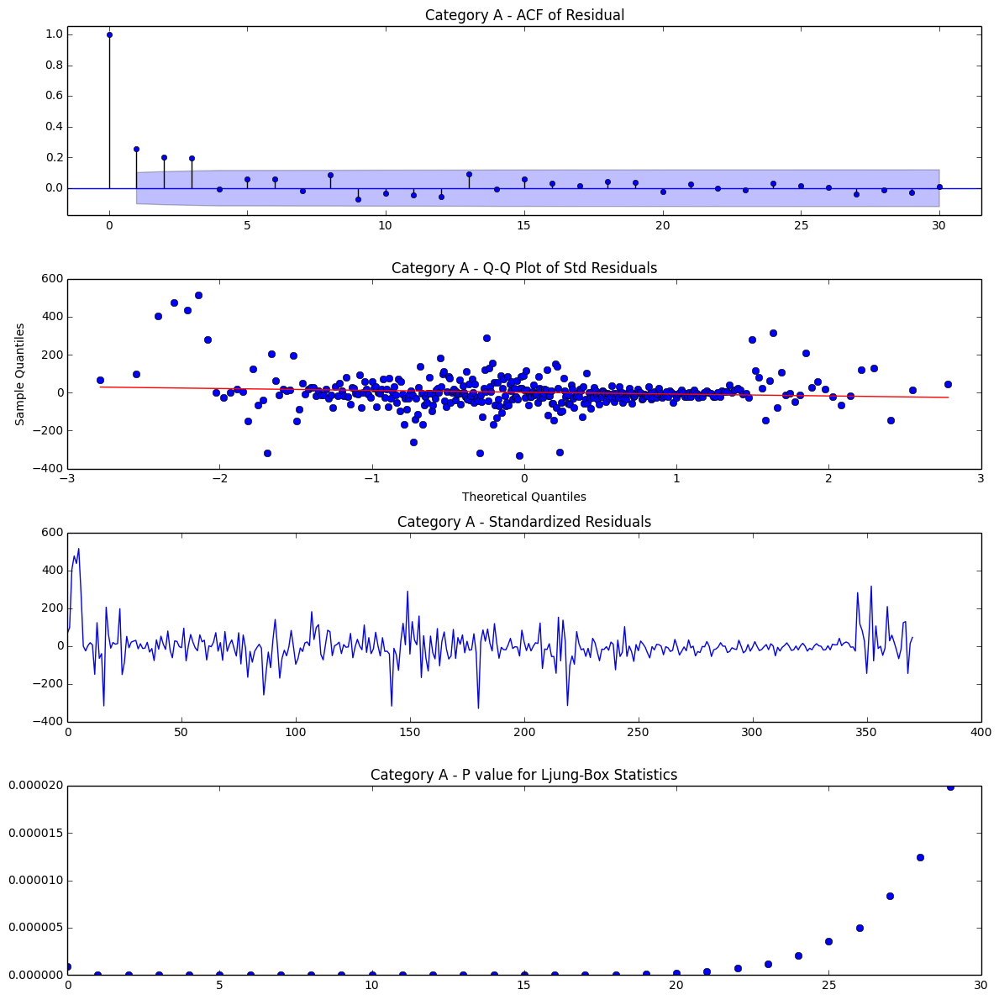

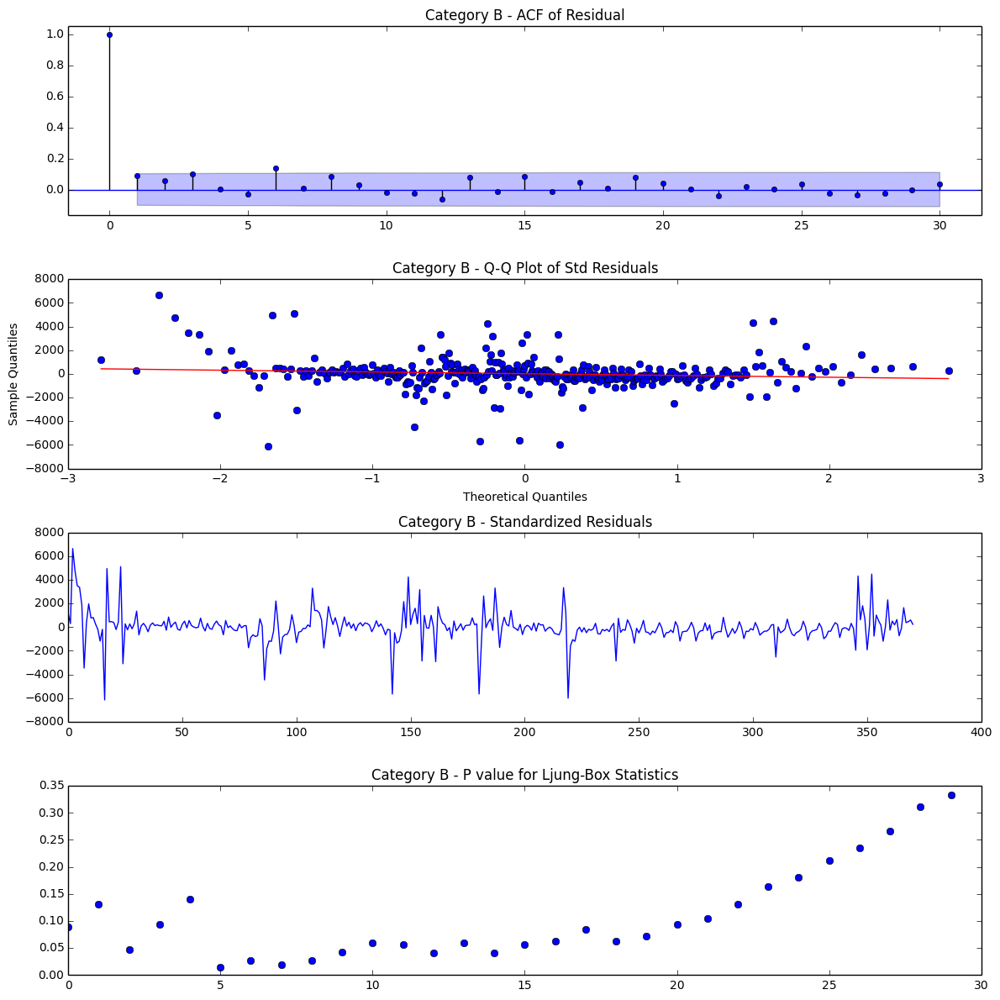

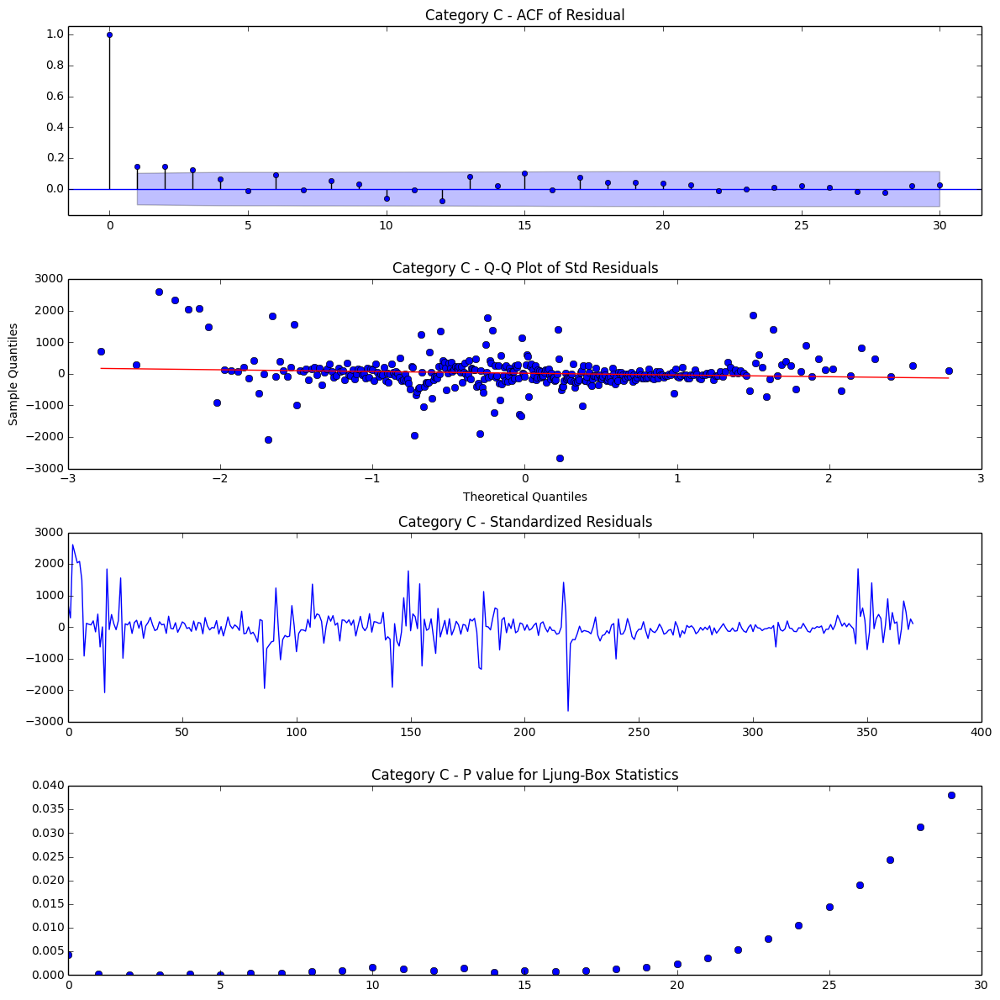

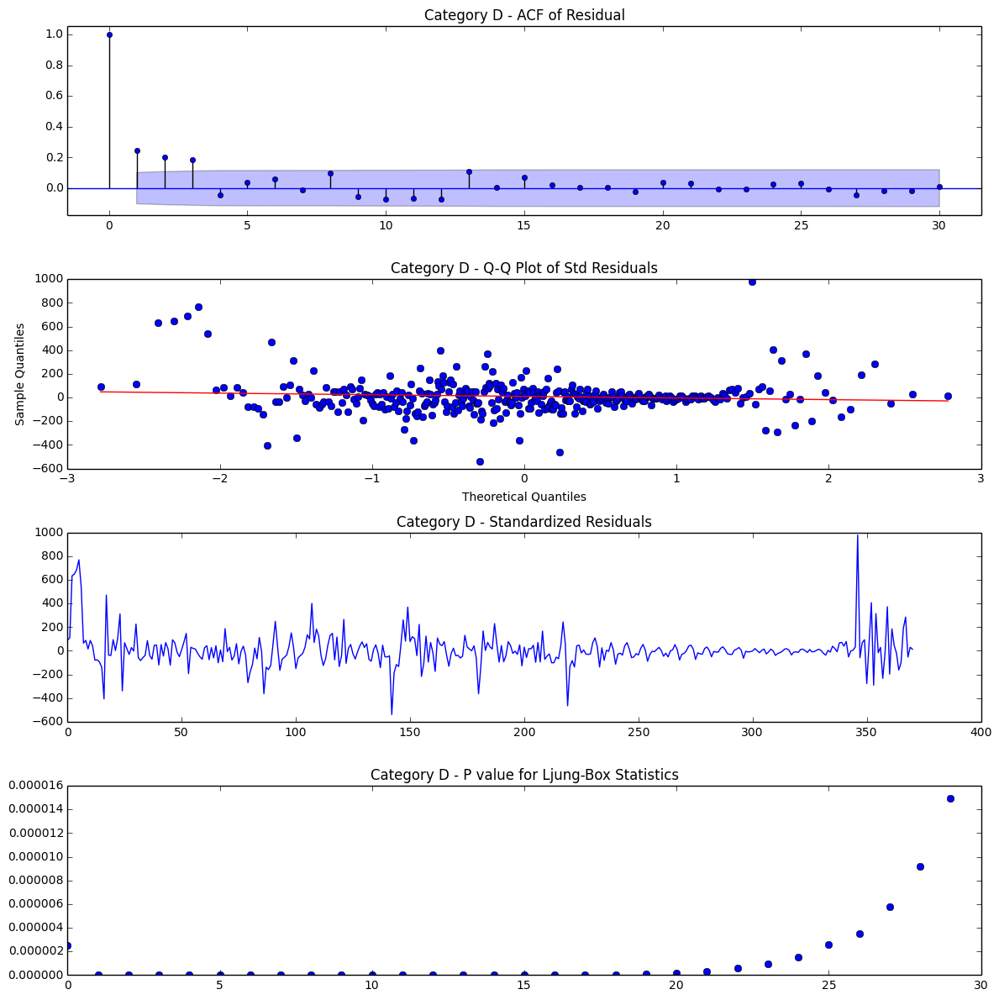

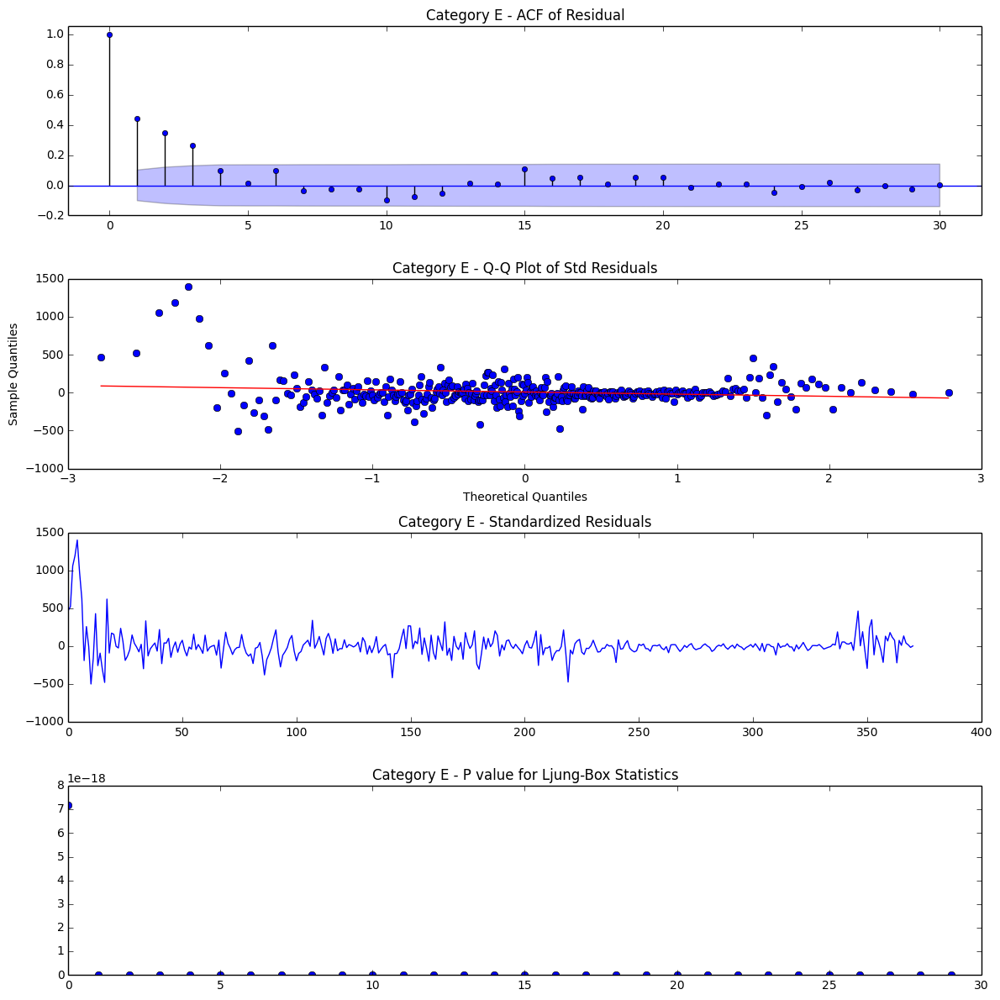

...

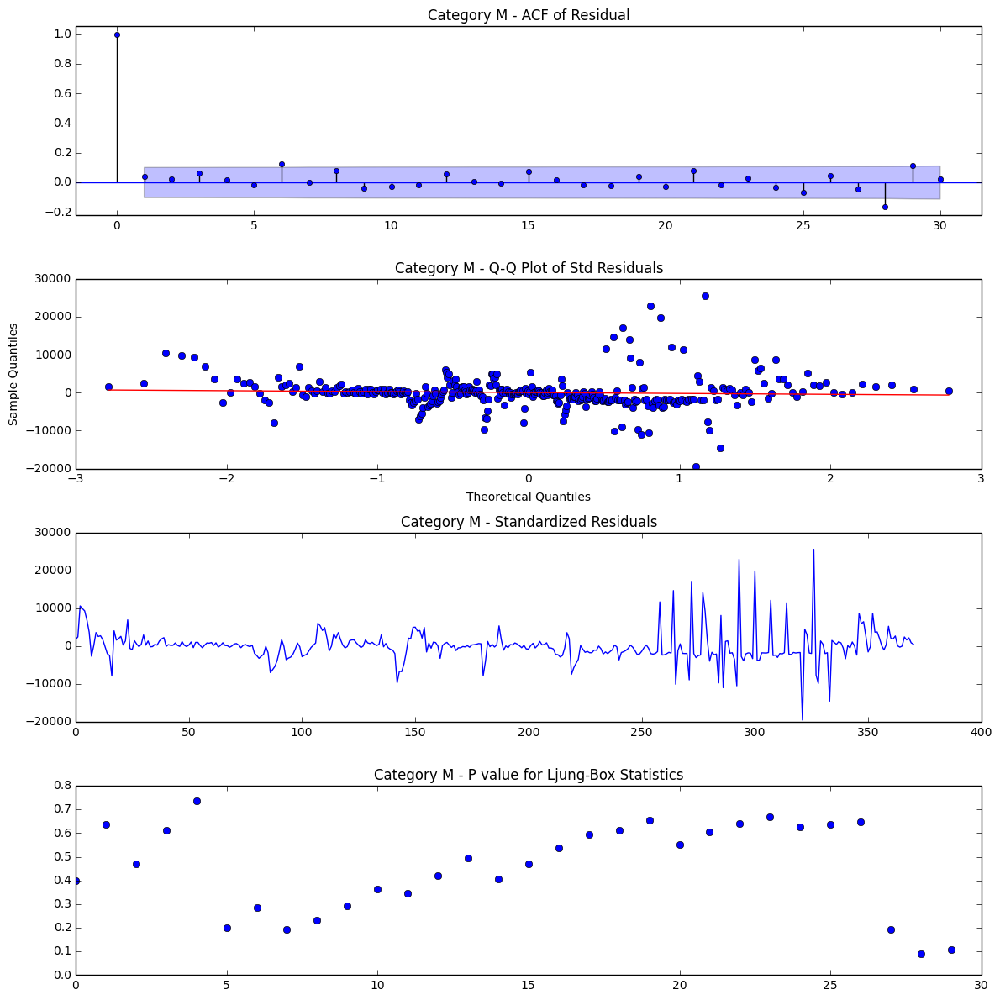

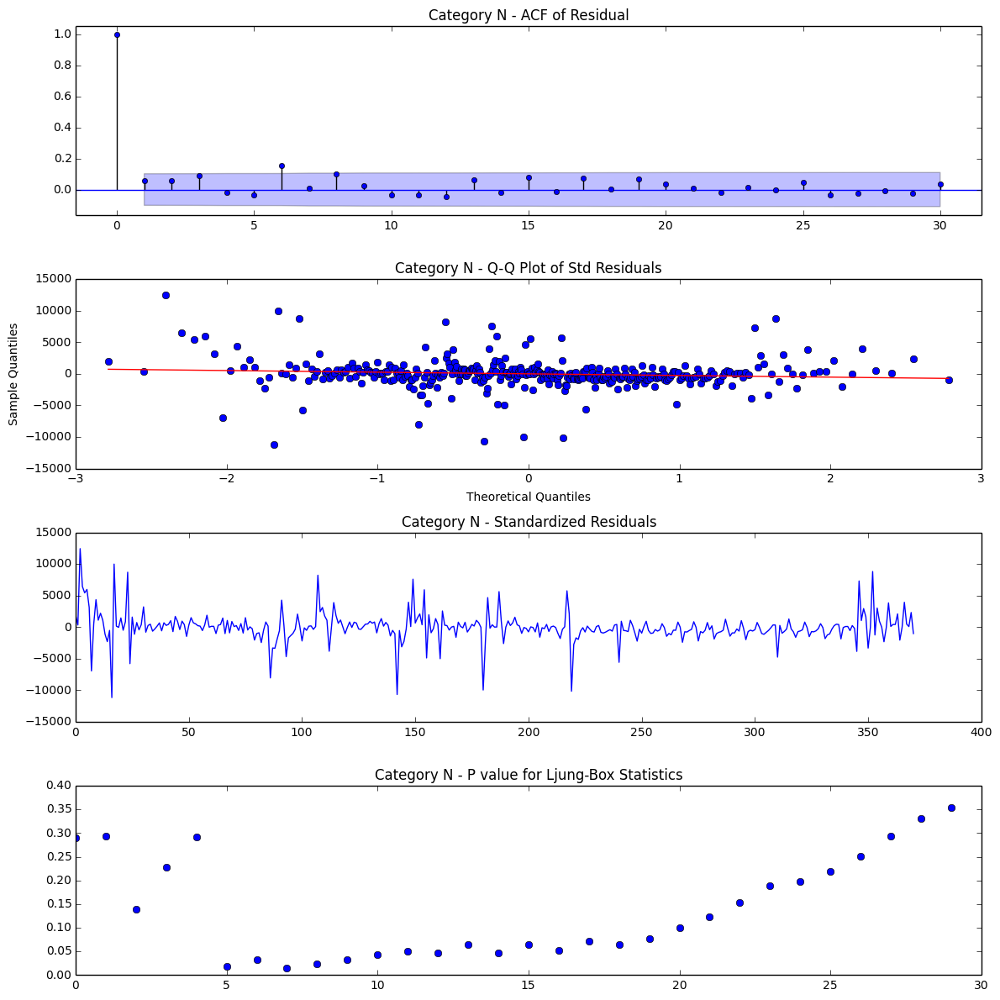

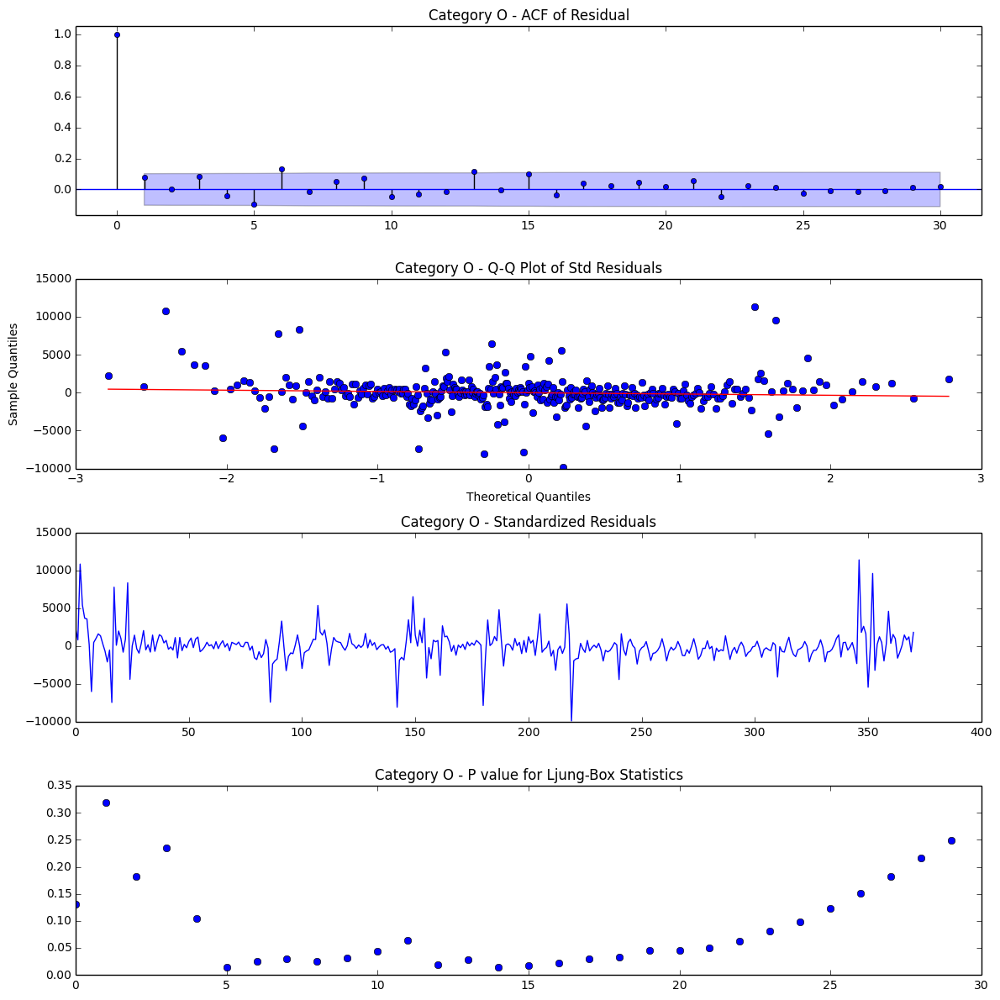

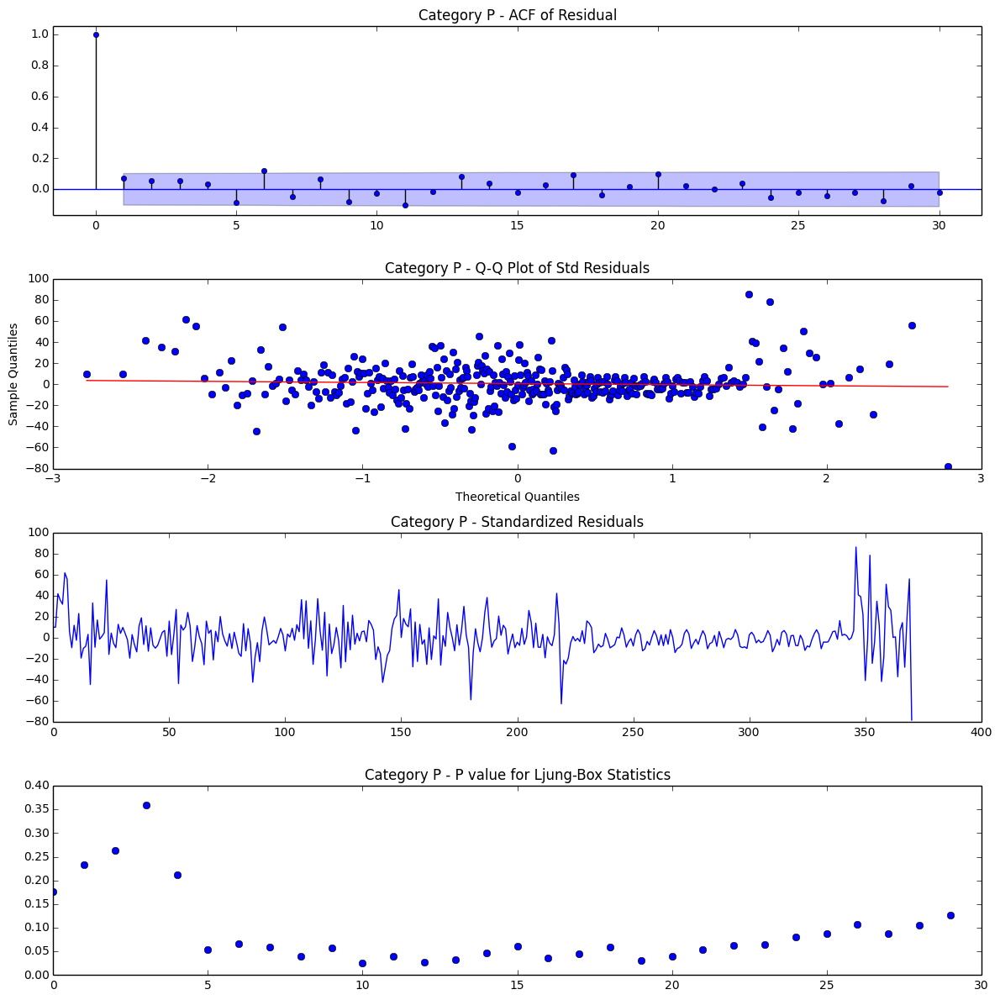

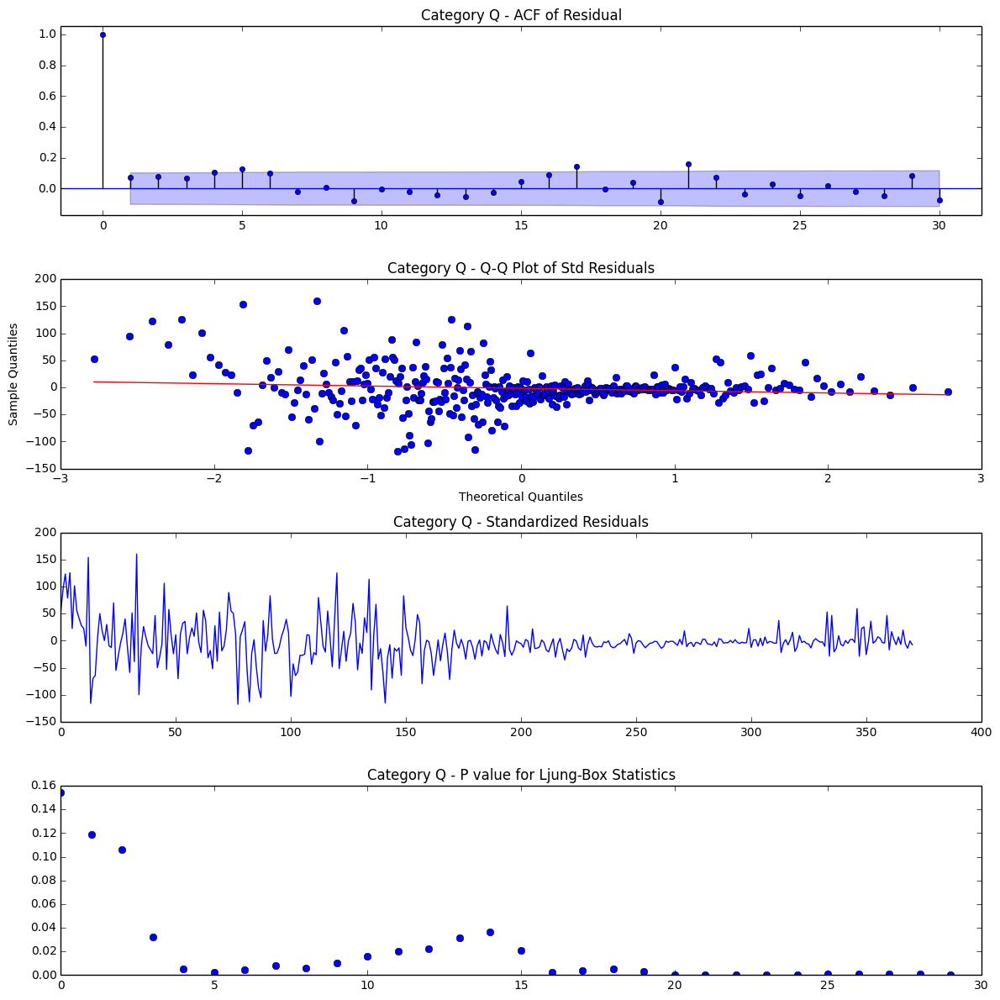

In [65]:
_ = map(residual_analysis, residuals_obs, temp_list)

### The residuals plots mostly look good. Let's move on to forecasting.

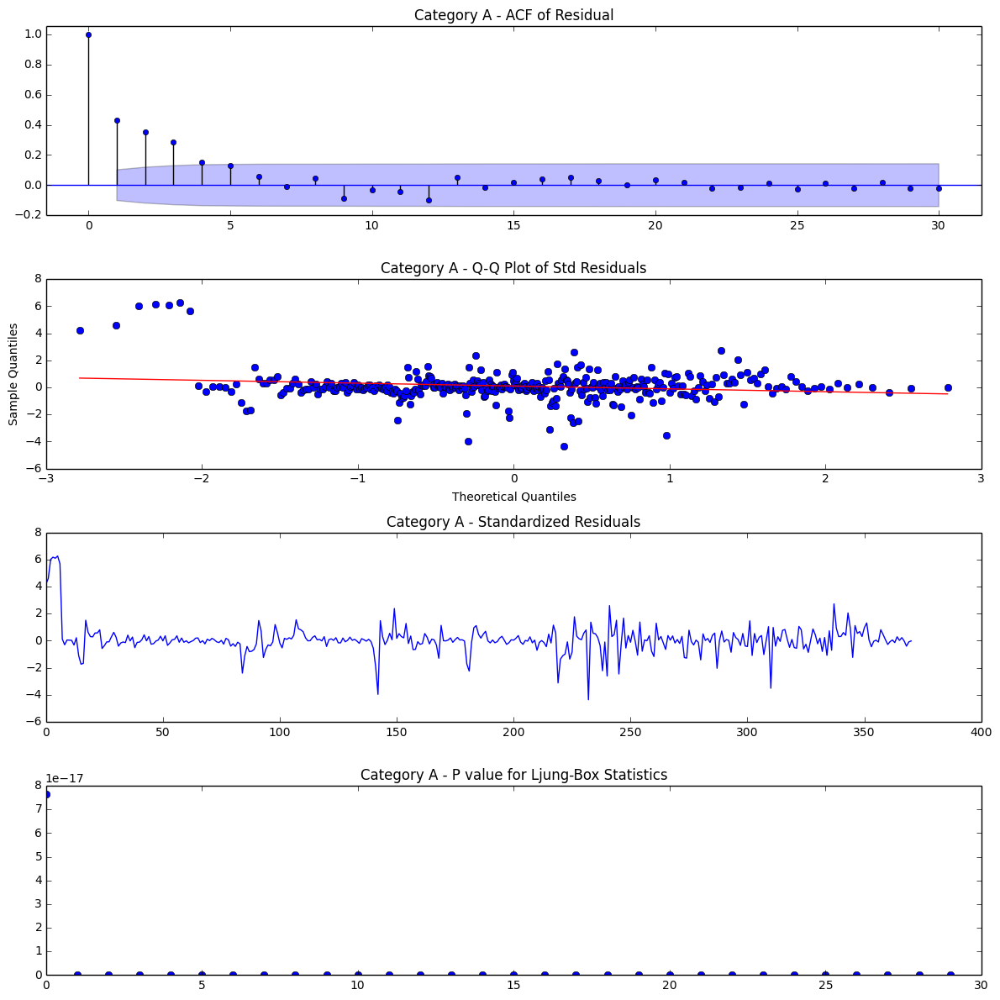

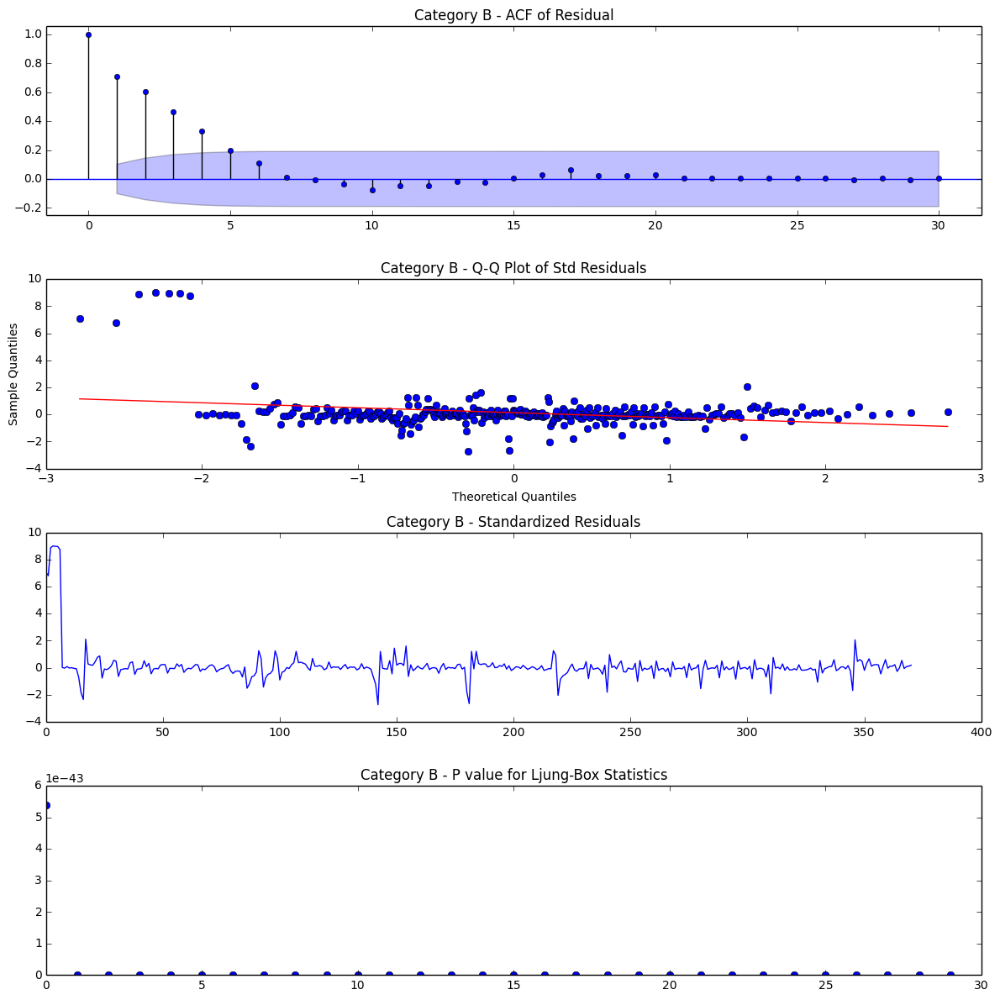

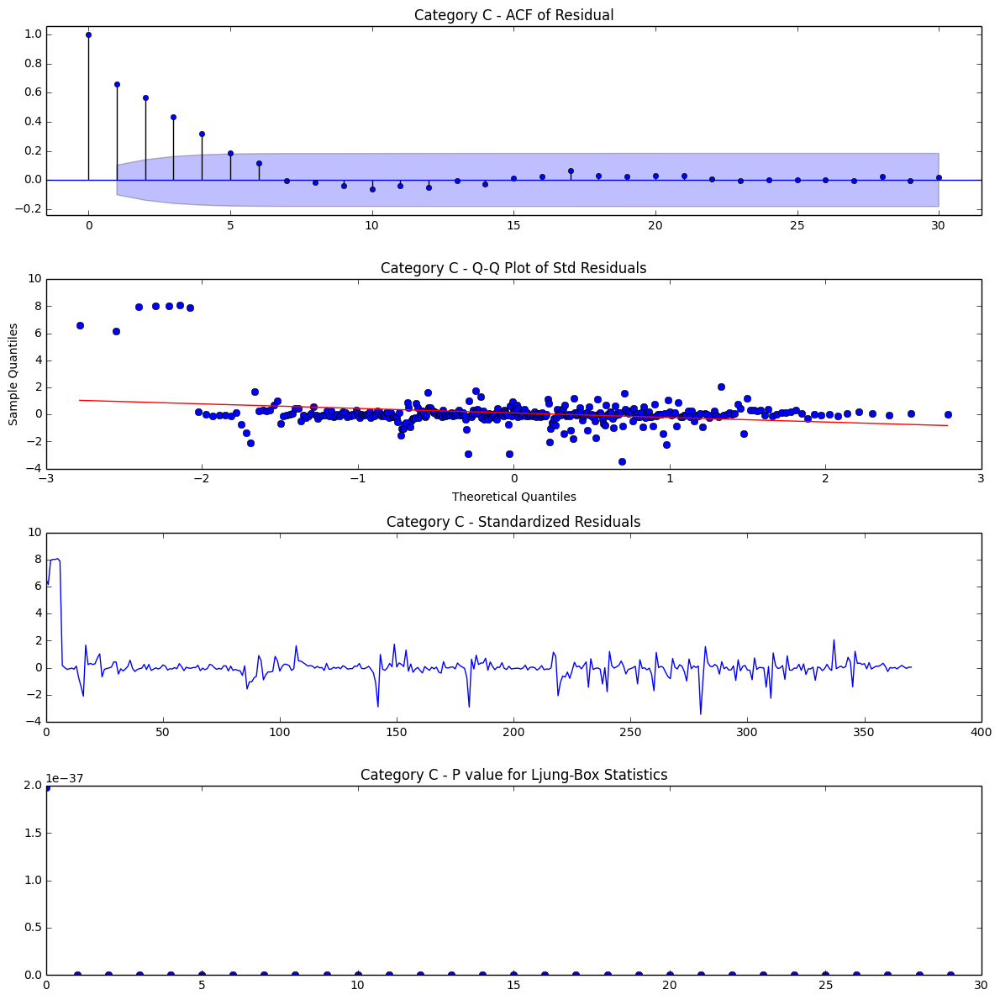

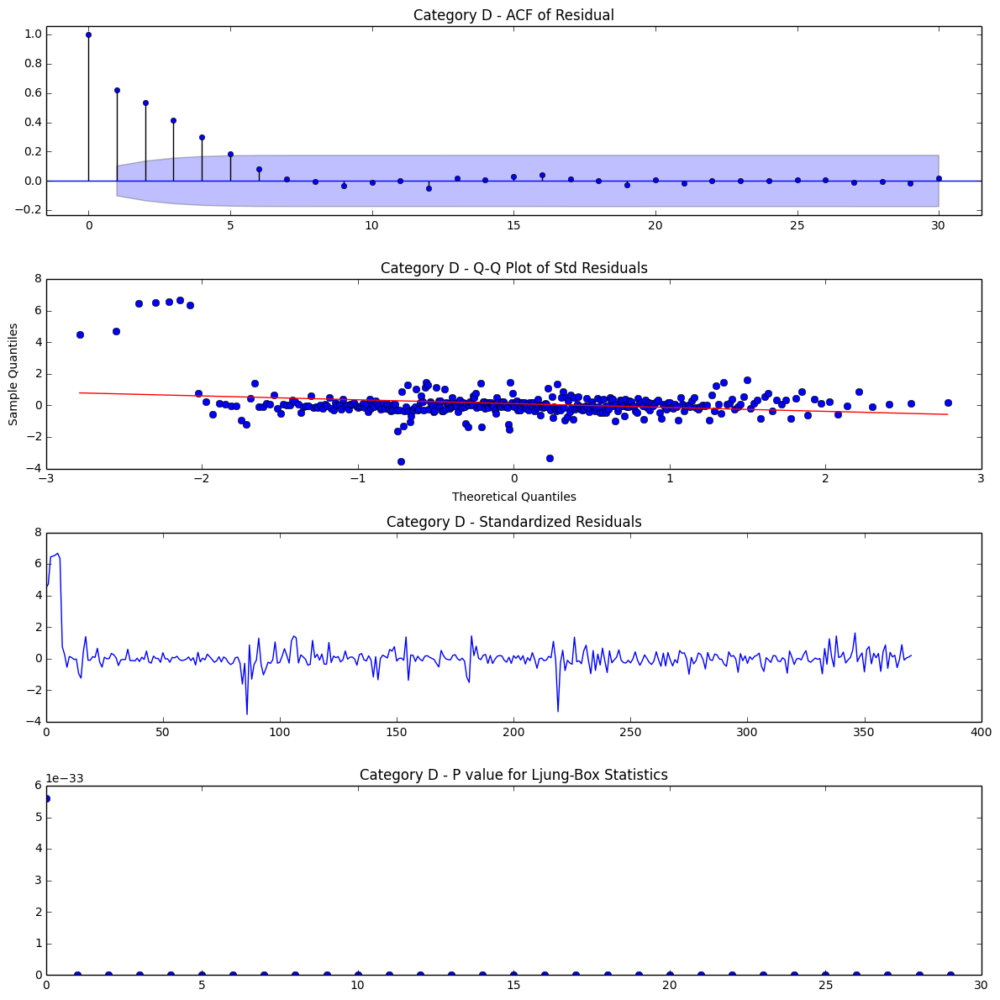

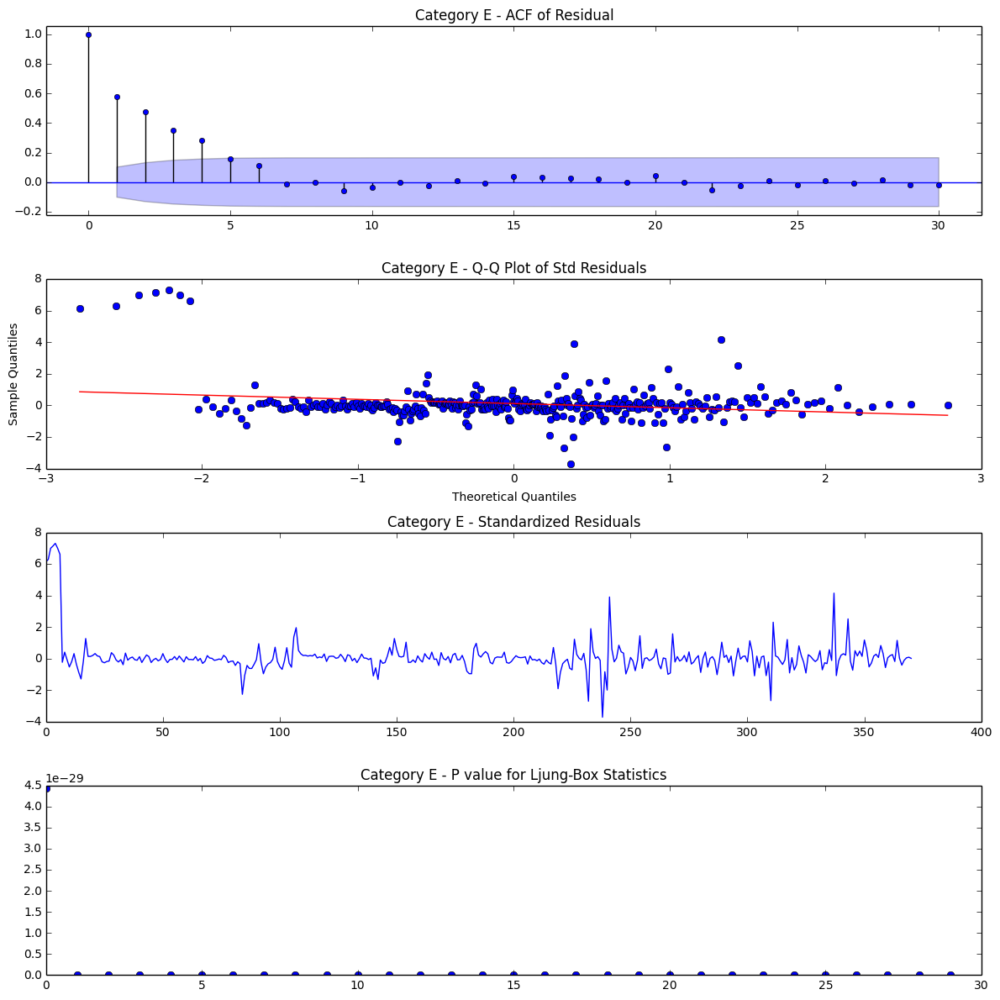

...

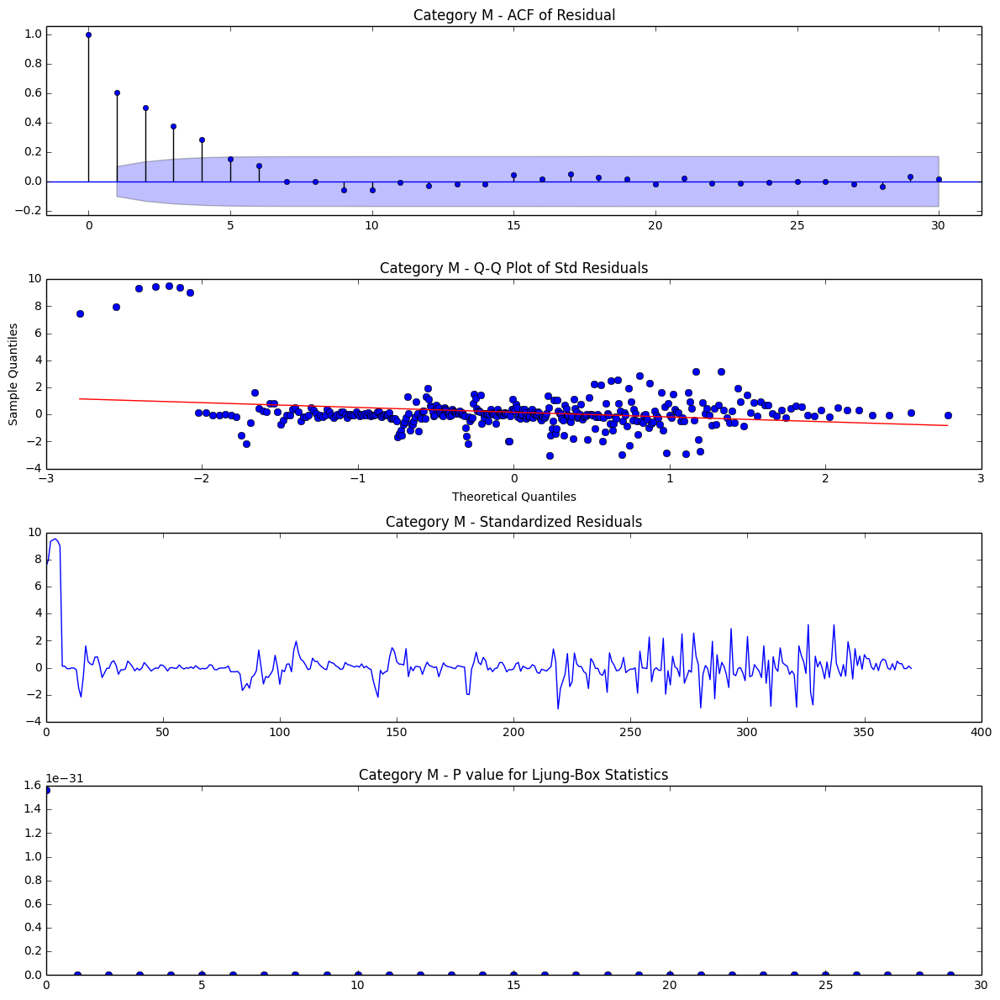

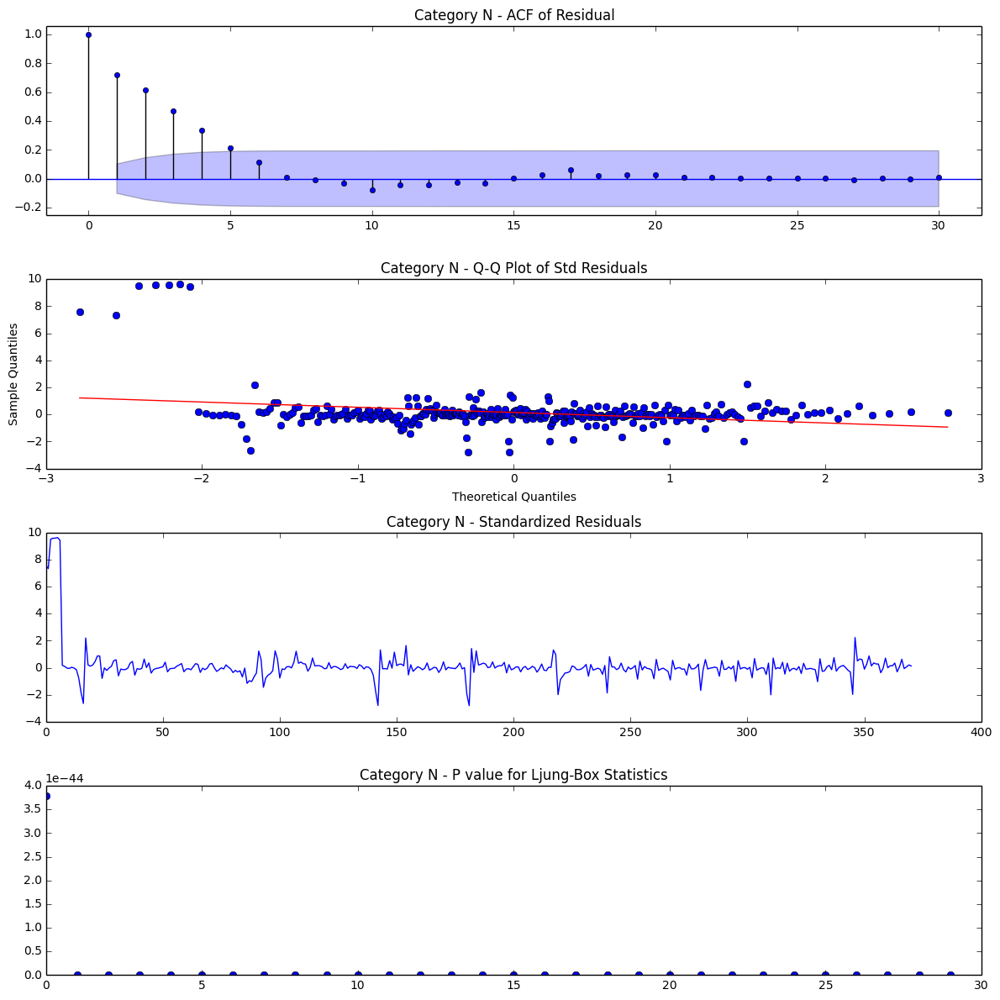

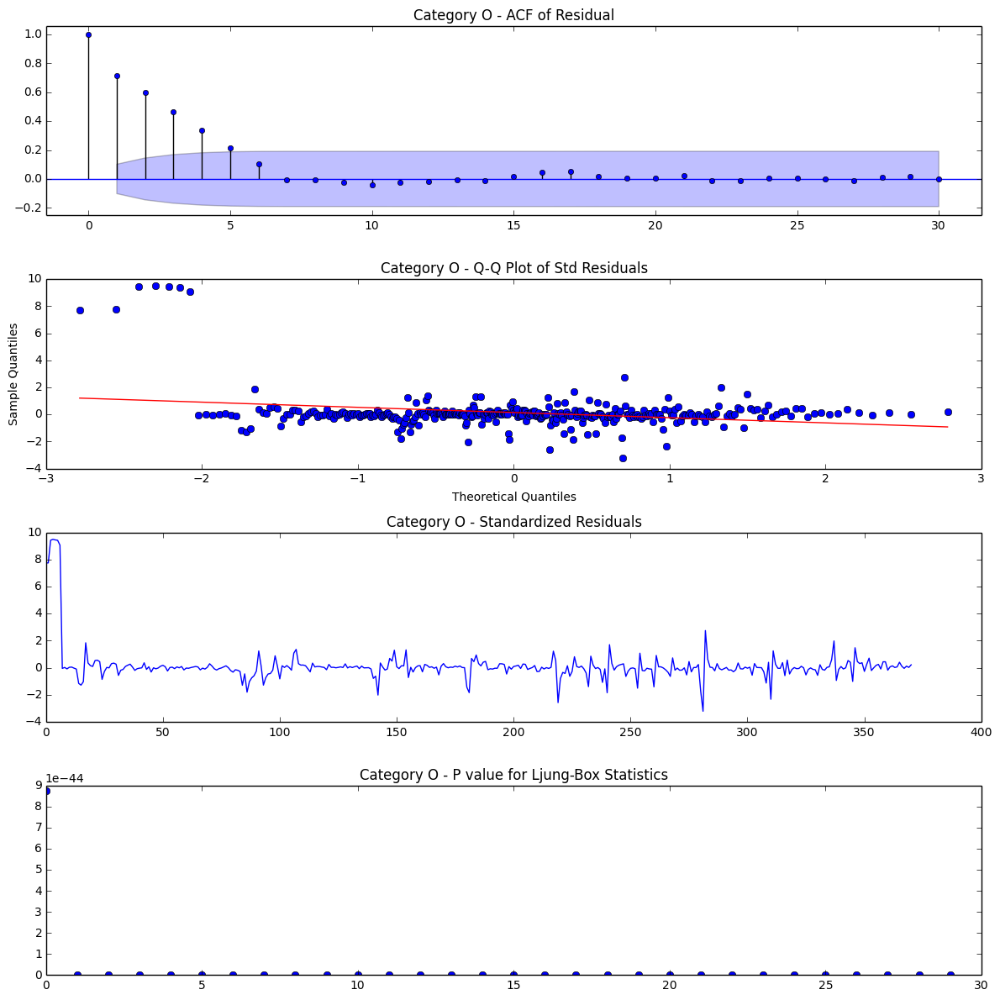

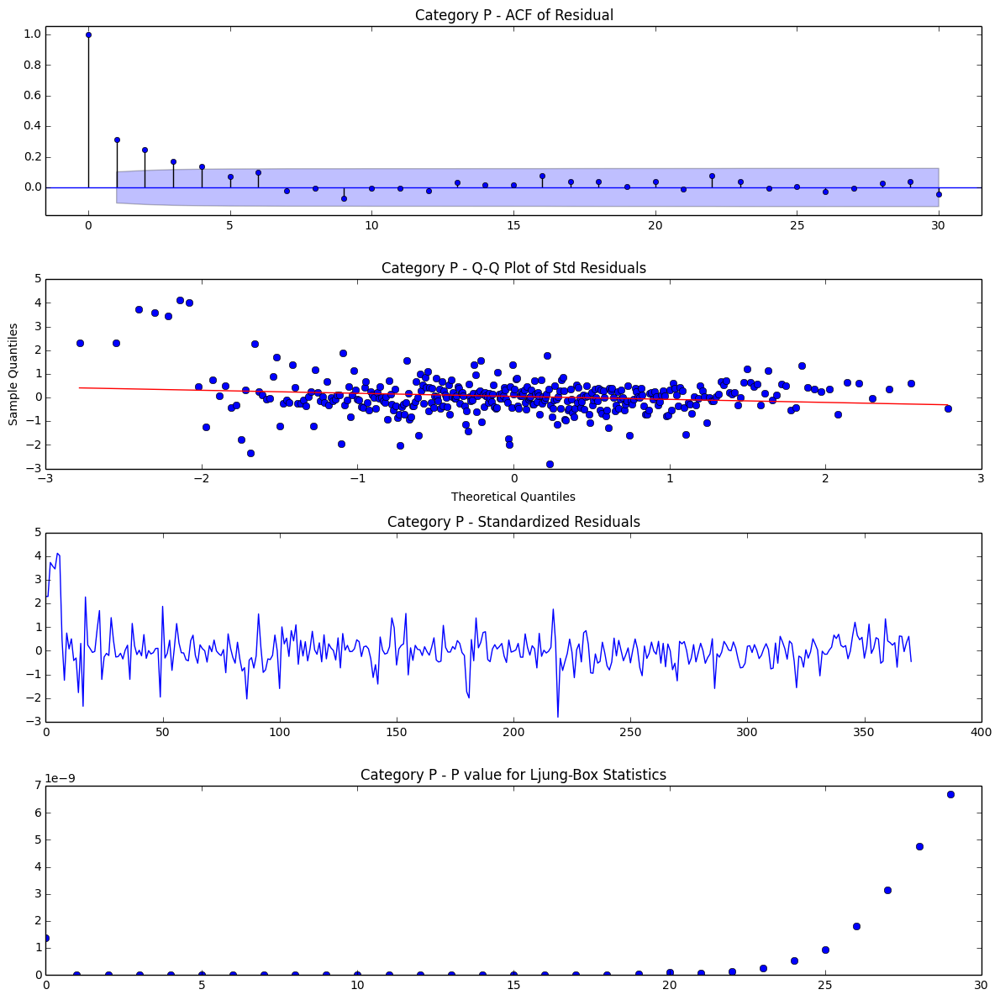

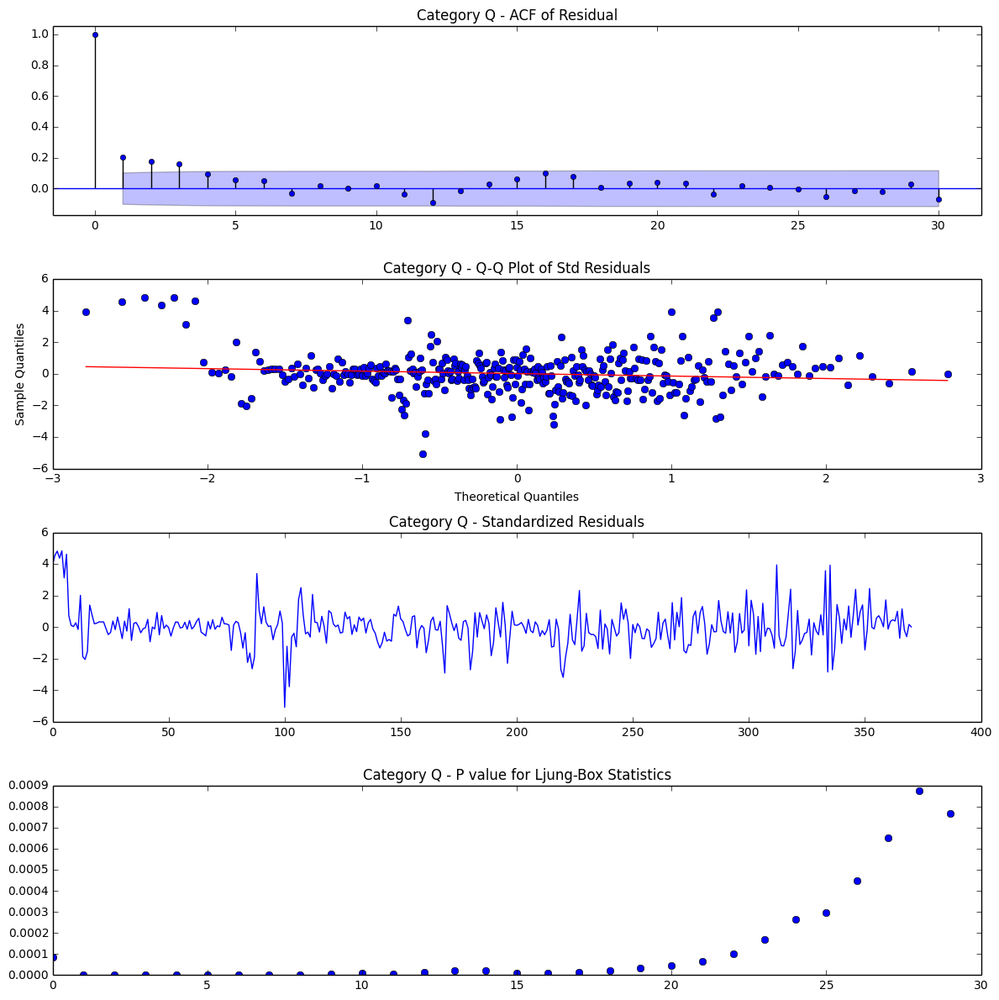

In [66]:
_ = map(residual_analysis, residuals_log, temp_list)

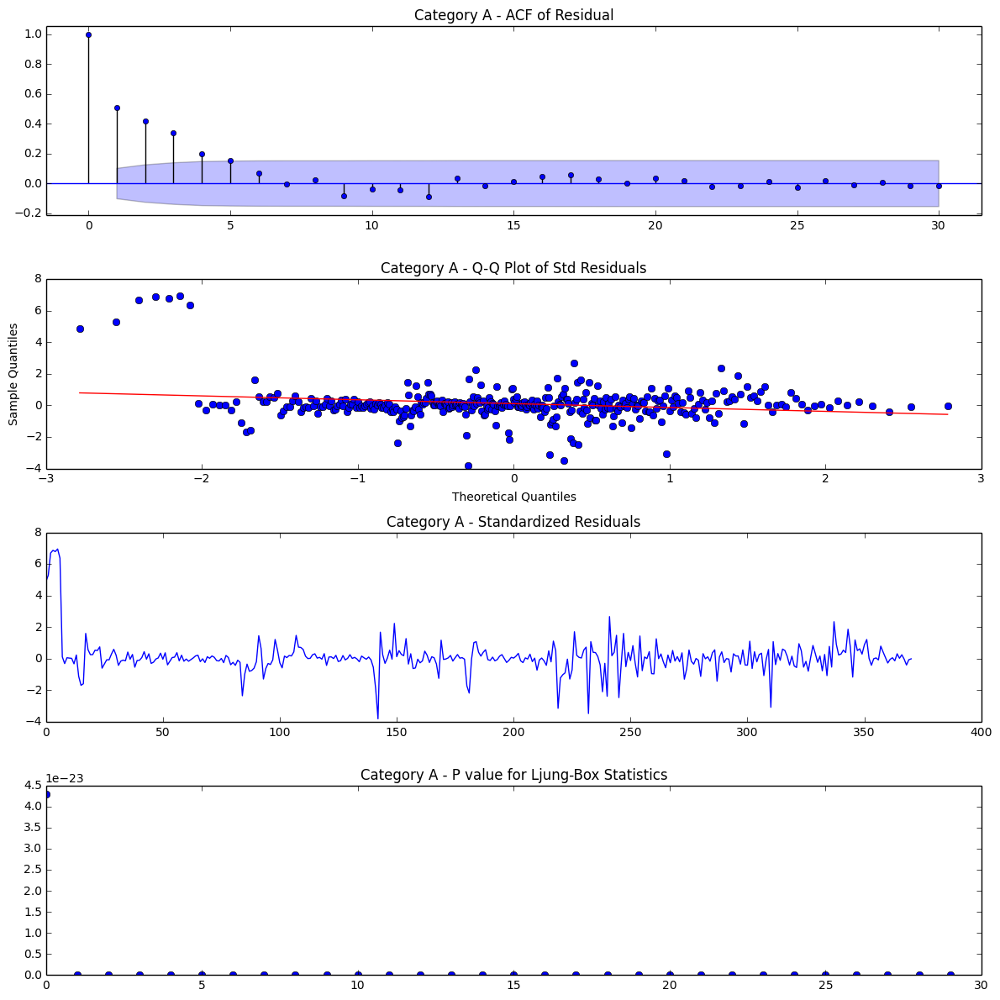

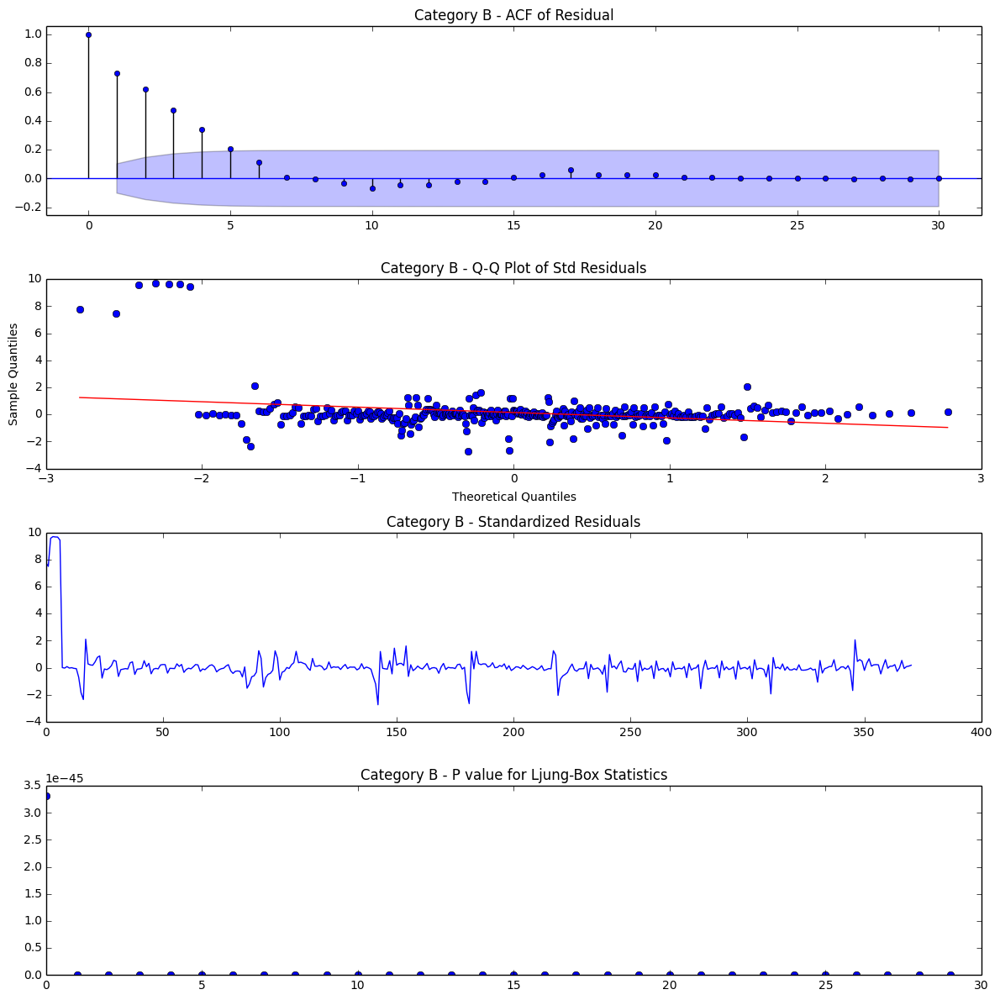

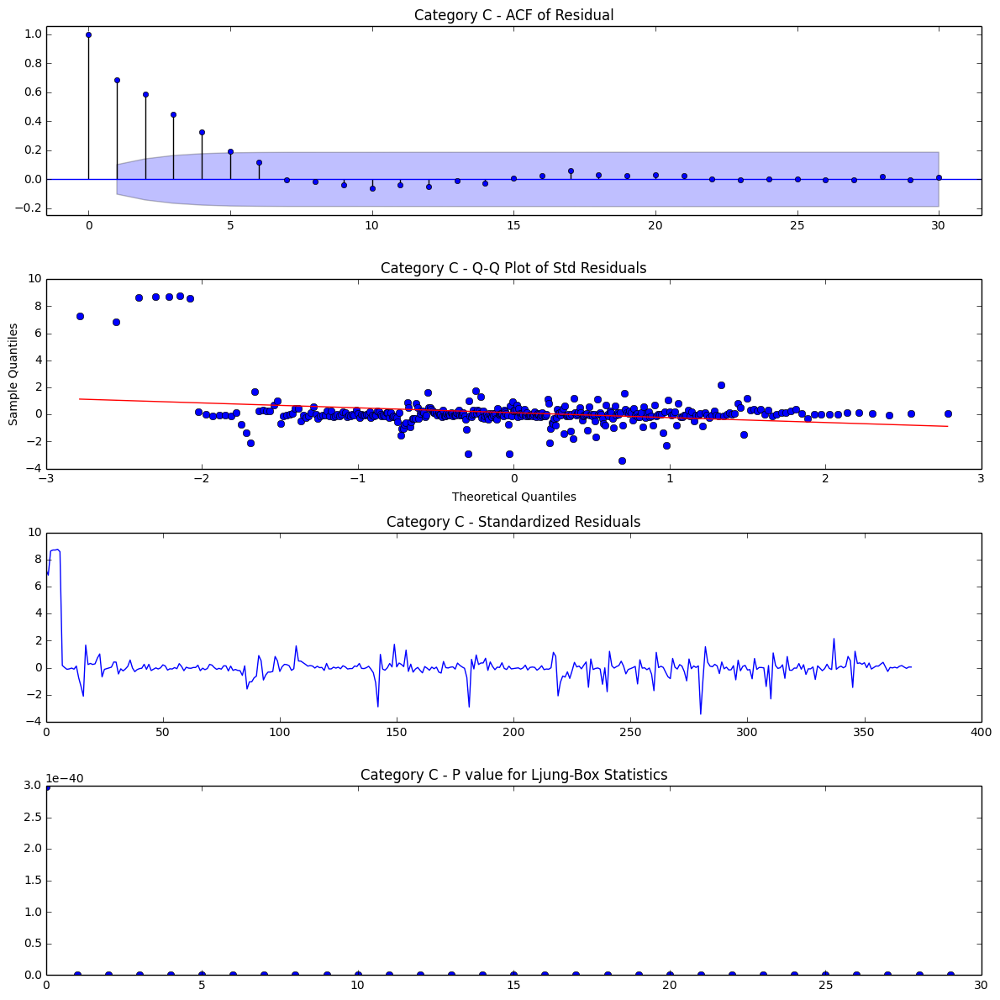

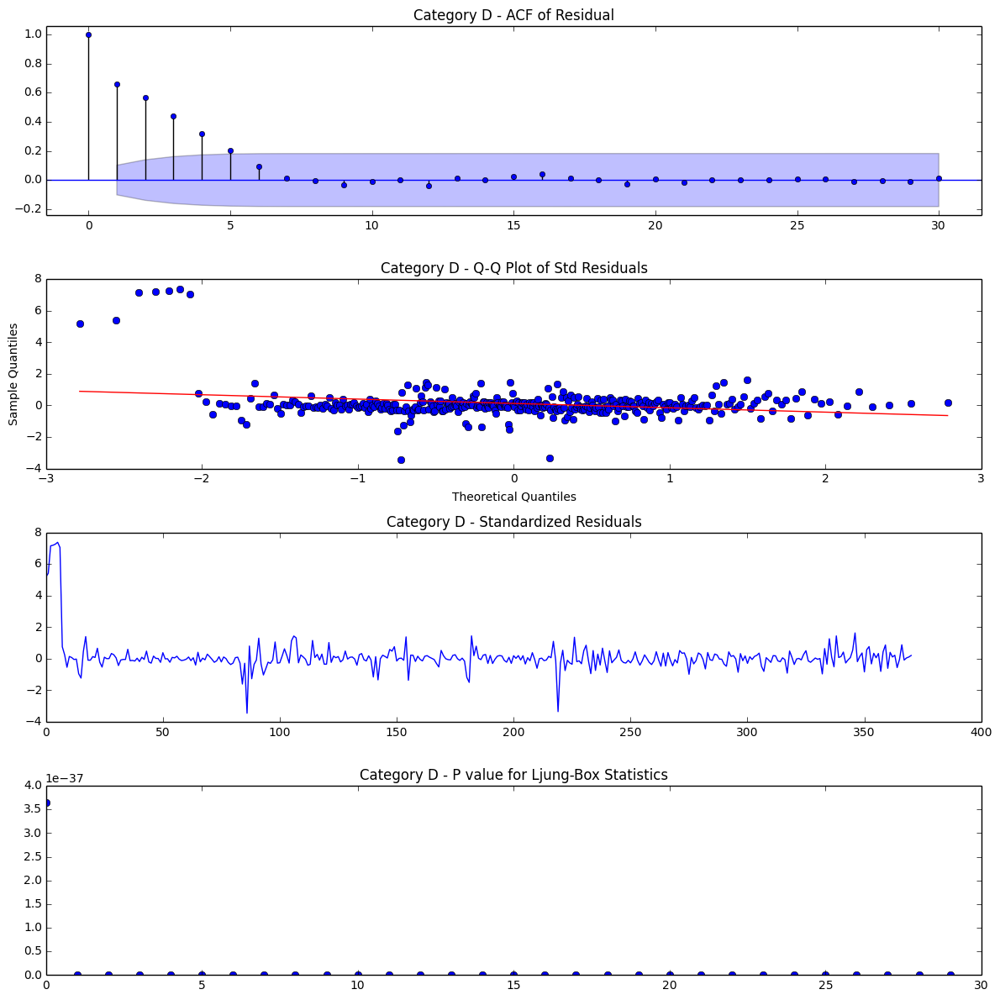

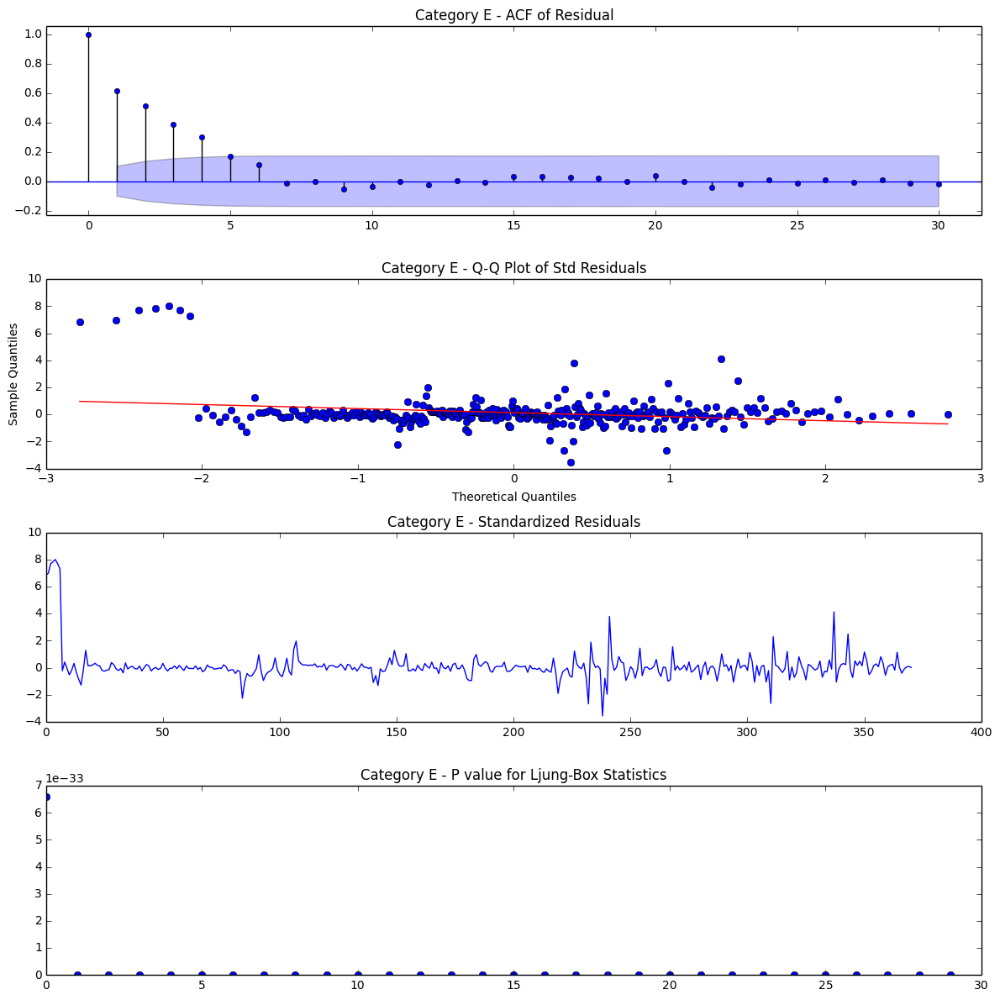

...

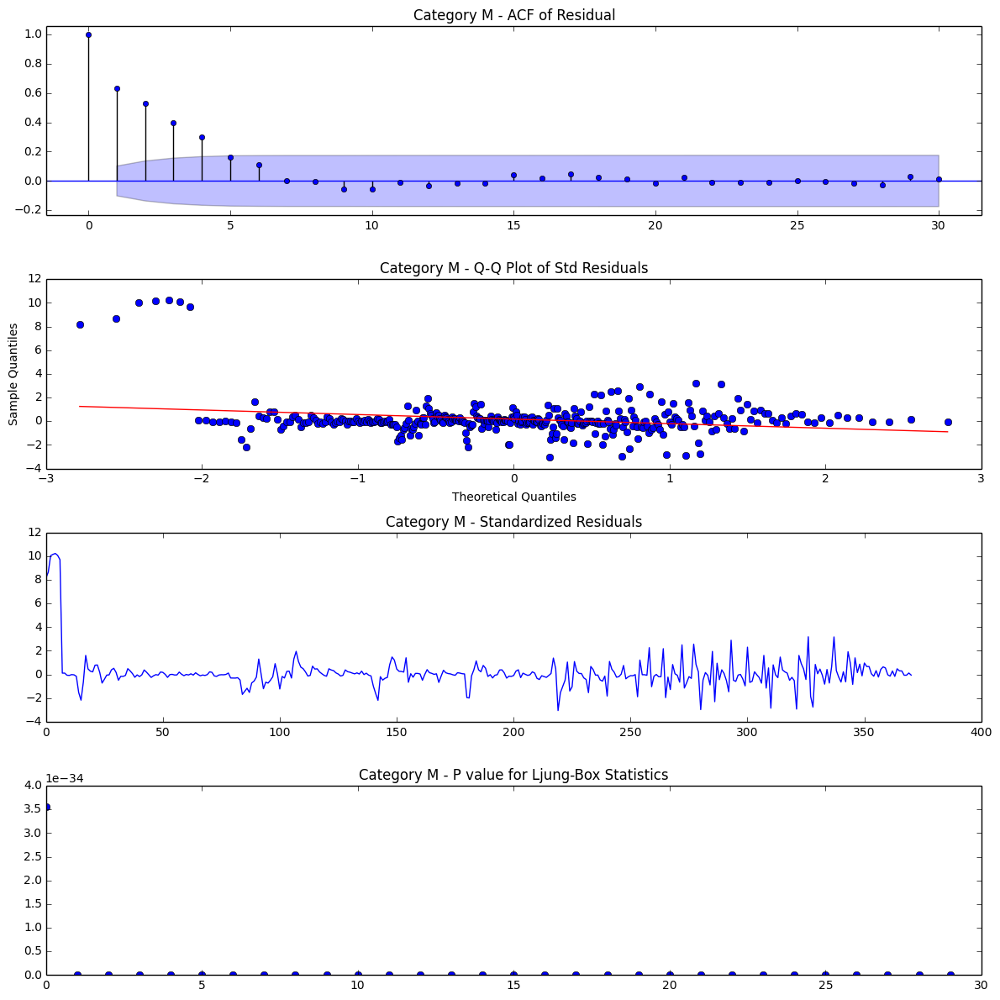

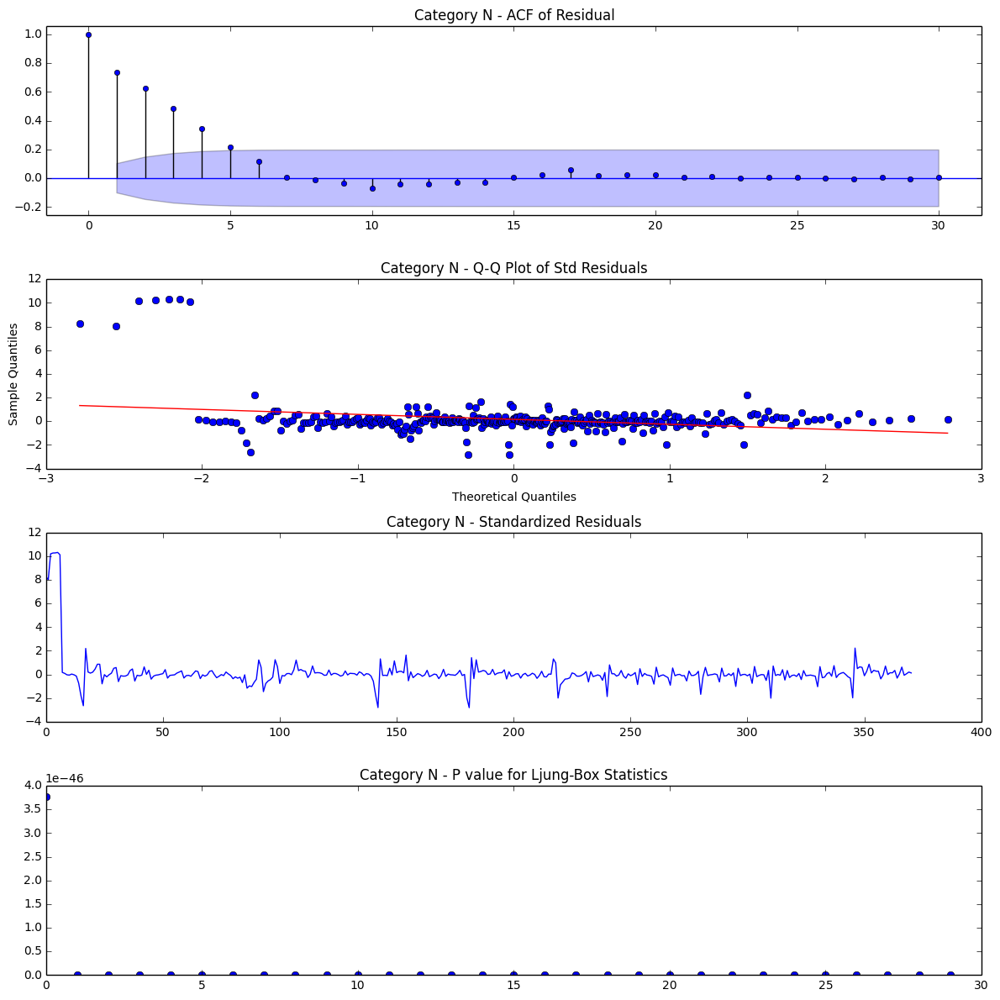

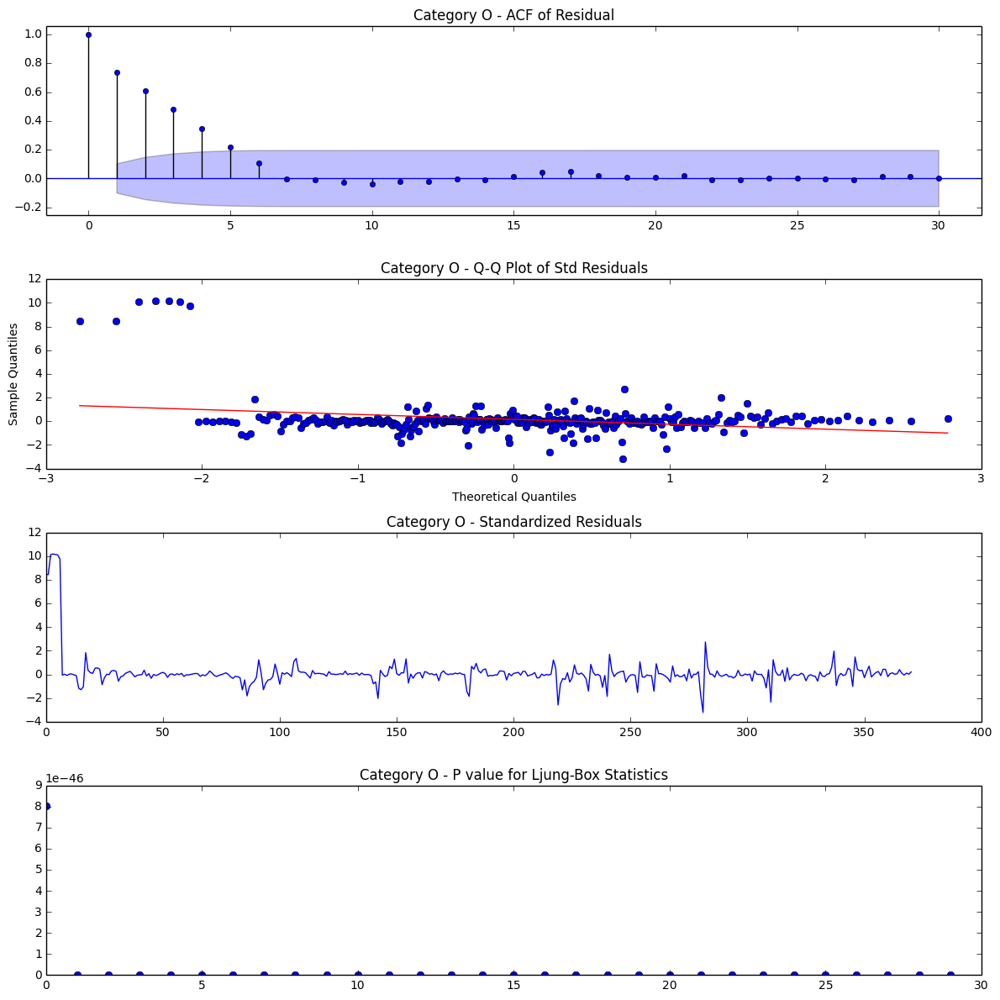

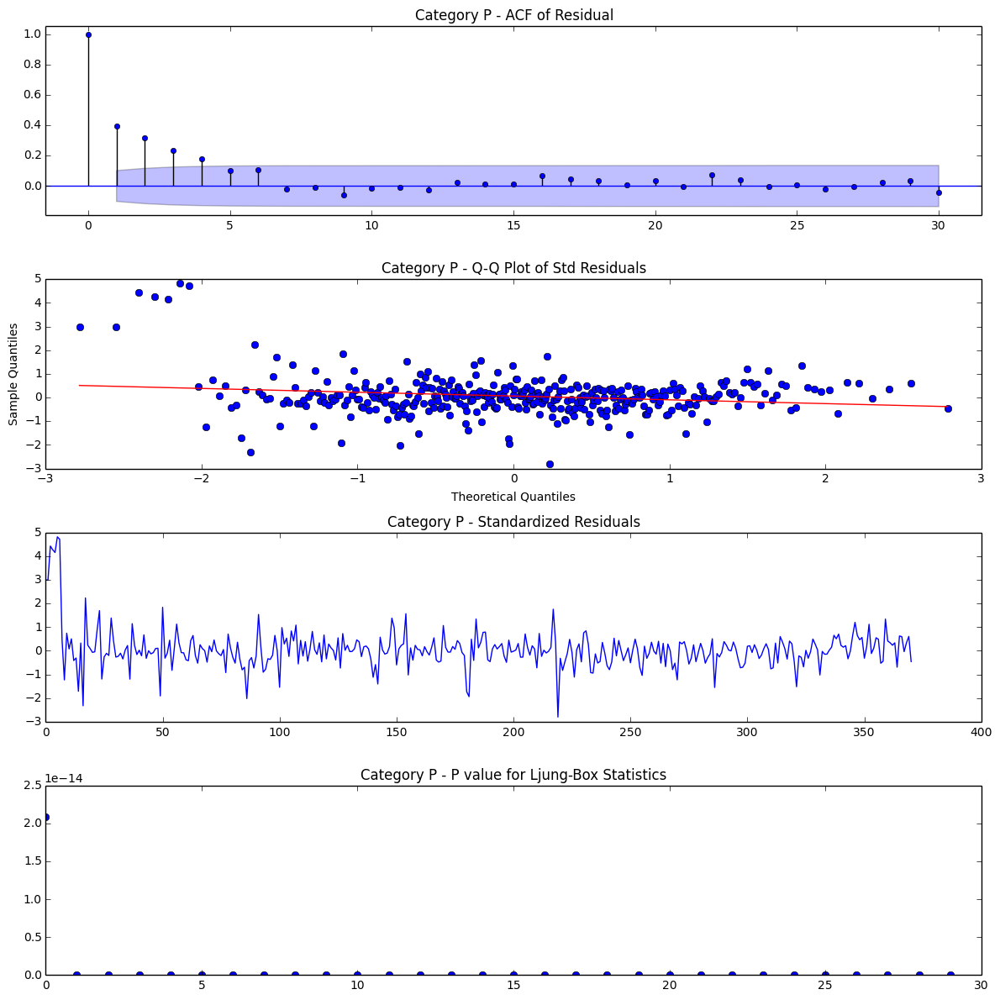

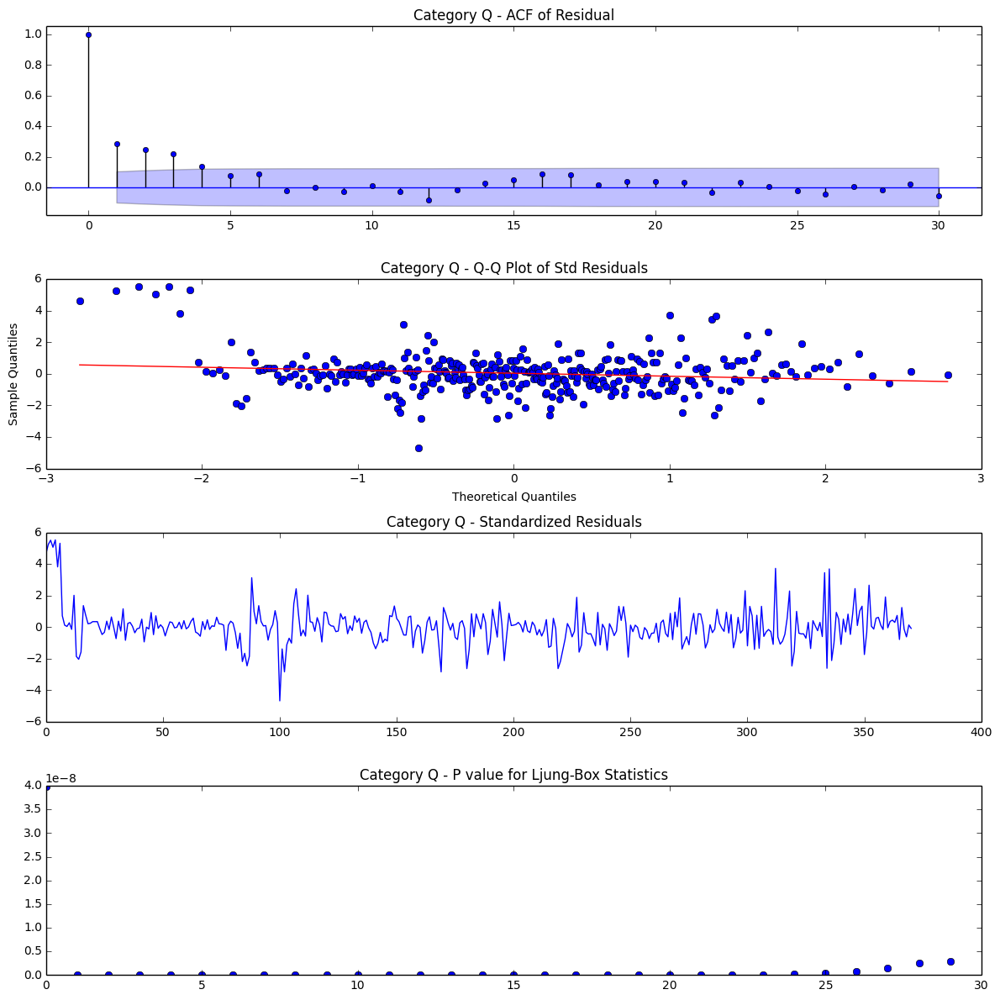

In [67]:
_ = map(residual_analysis, residuals_inv, temp_list)

# Step 5) Prediction In Sample, and 90 Days Ahead
### - We will plot the forecast for each category
### - Plot the relative contribution from each category
### - Add them up and plot the total forecast
### - Measure the RMSE
### - We will also build a separate model and forecast using top-down approach for comparison (what we did so far is bottom up)

In [82]:
def plot_forecast(results, timeseries, item):
#     pred = np.exp(results.predict())
#     forecast_90 = np.exp(results.forecast(steps=90))

    pred = np.sinh(results.predict())
    forecast_90 = np.sinh(results.forecast(steps=90))

#     pred = (results.predict())
#     forecast_90 = (results.forecast(steps=90))

    pred.plot(label='predict')
    forecast_90.plot(label='forecast')
    timeseries.plot(label='original')
    plt.title(' Category {} Forecast '.format(item))
    plt.legend()
    plt.show(block=False)
    
    return pred

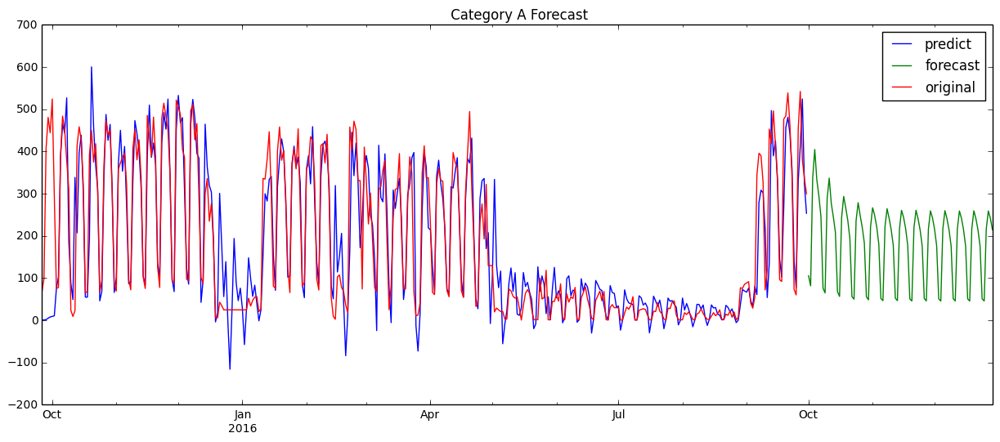

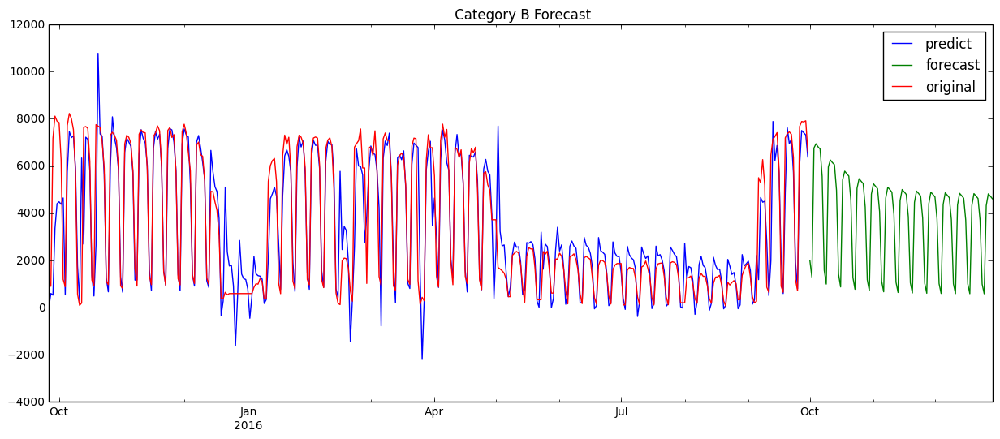

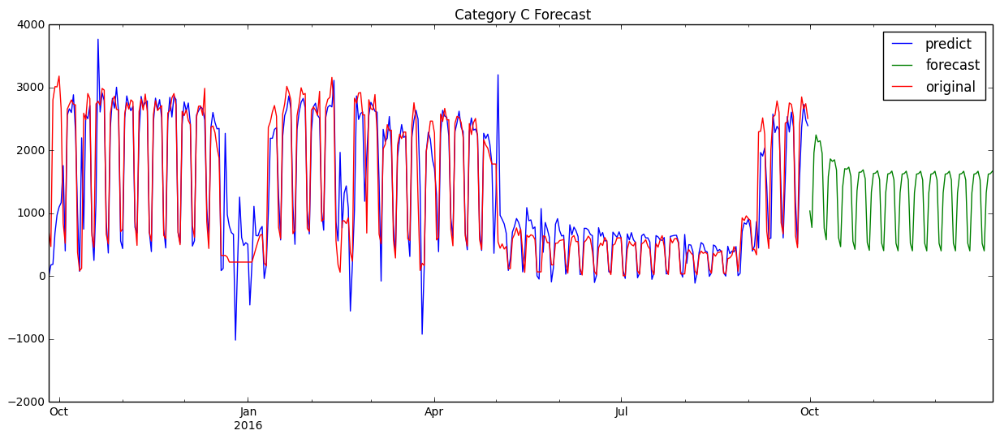

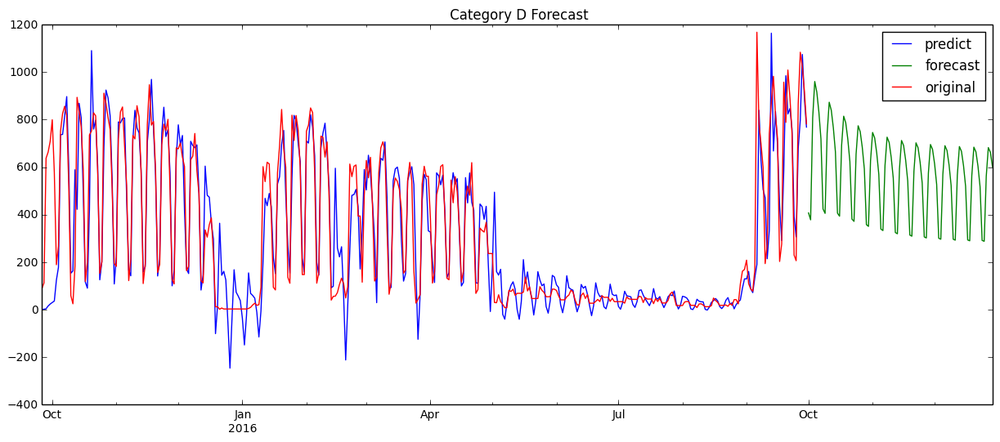

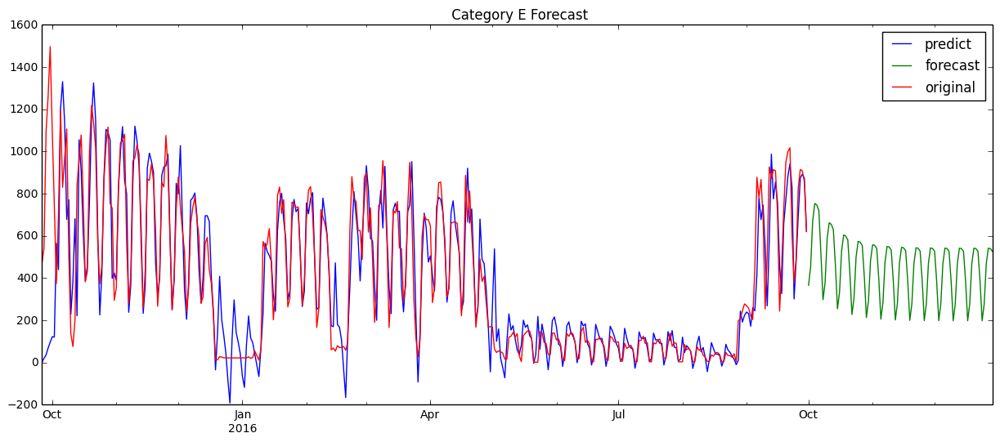

...

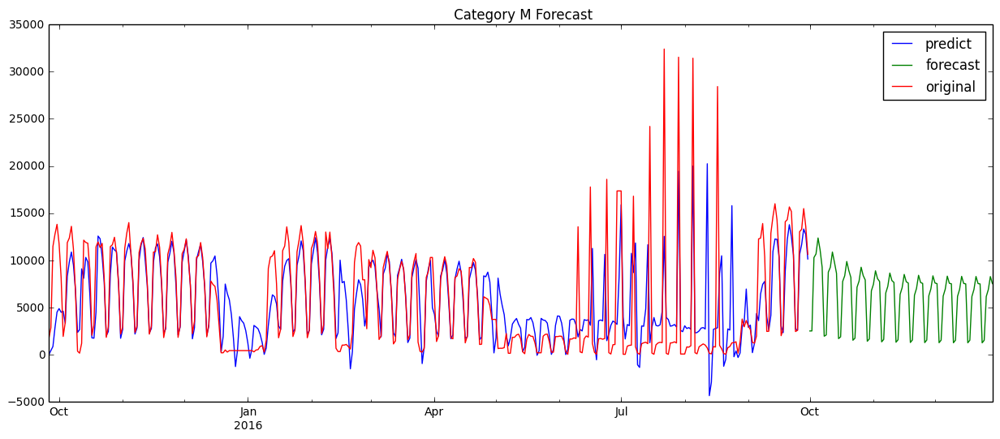

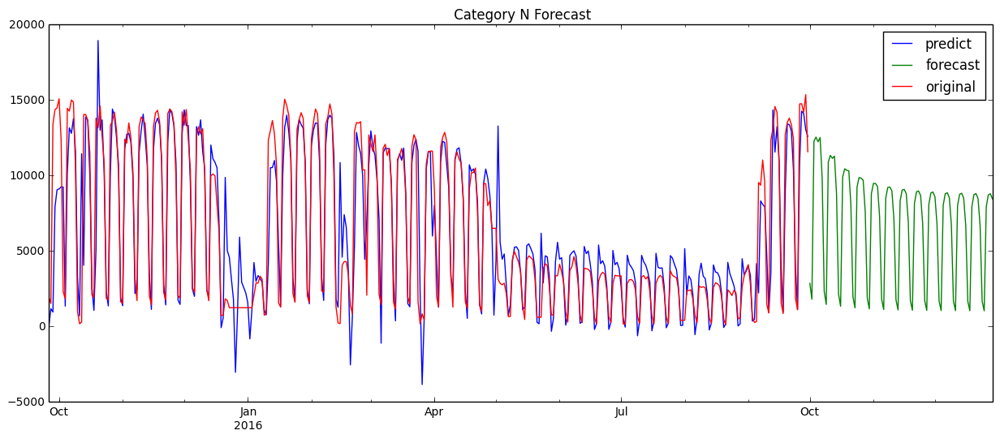

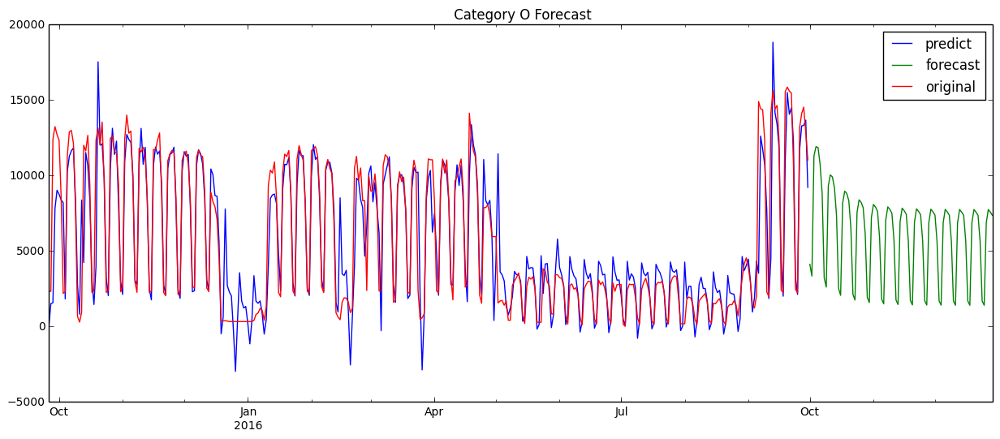

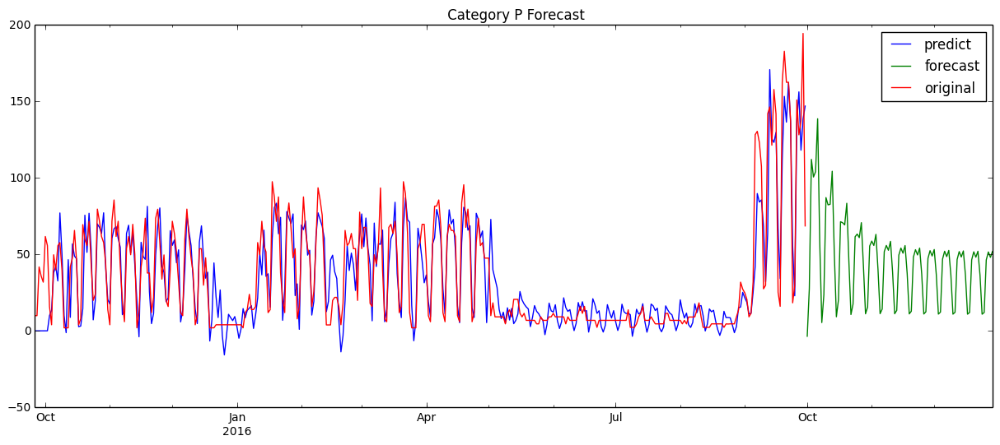

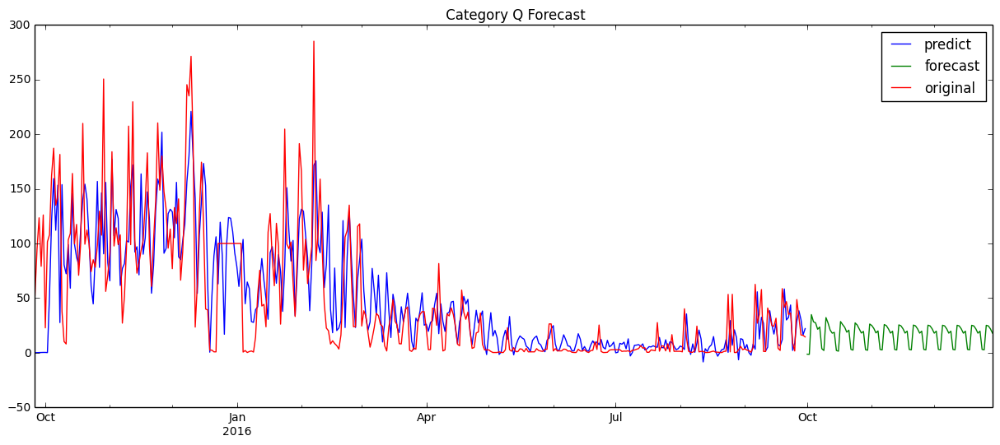

In [70]:
pred_obs = map(plot_forecast, results_obs, splitted_data, temp_list)

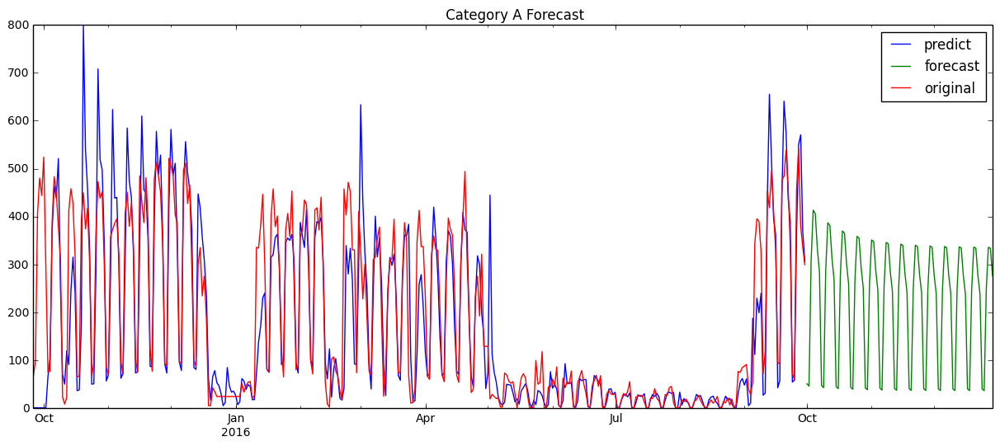

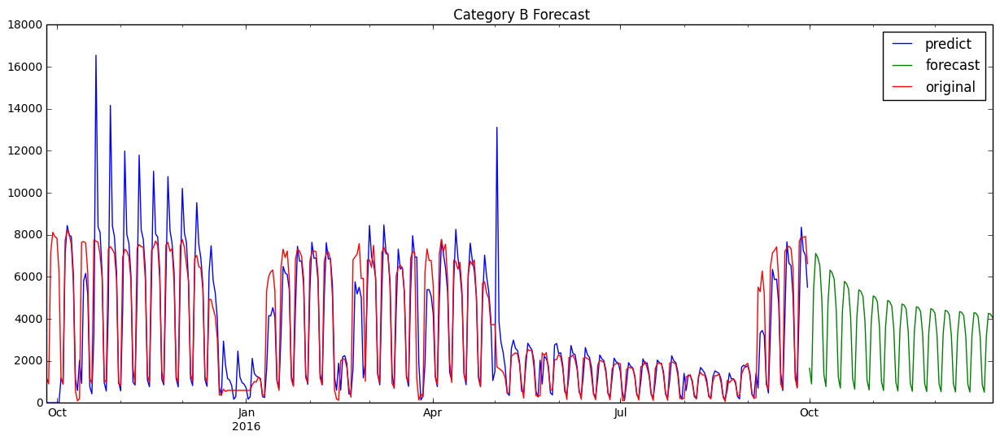

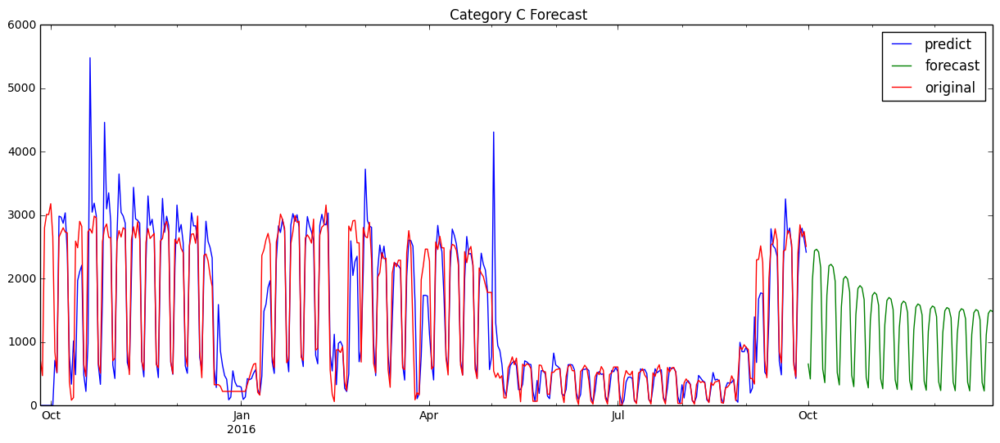

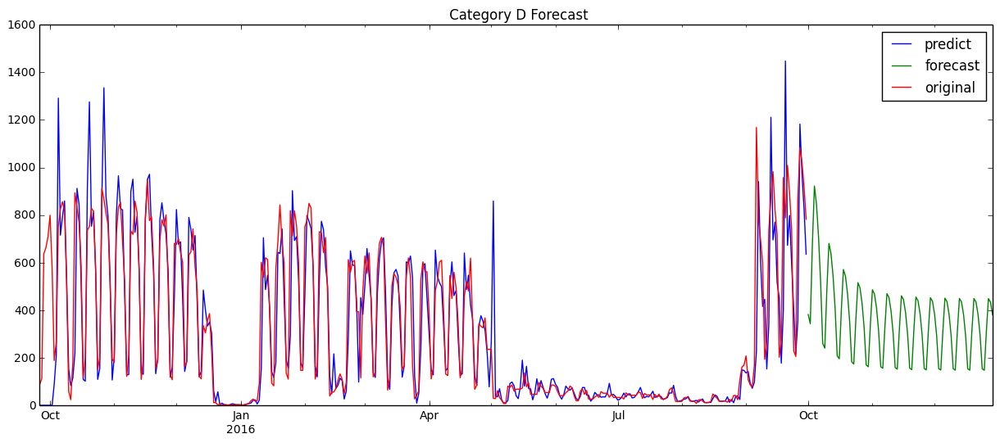

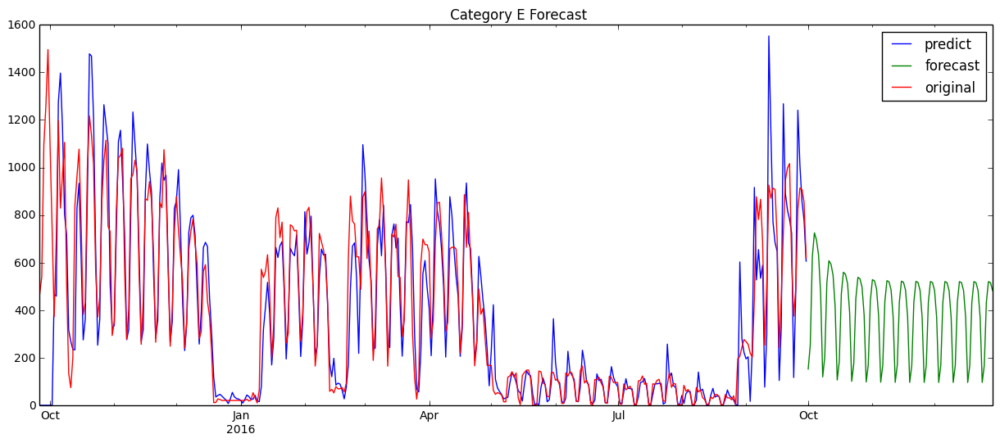

...

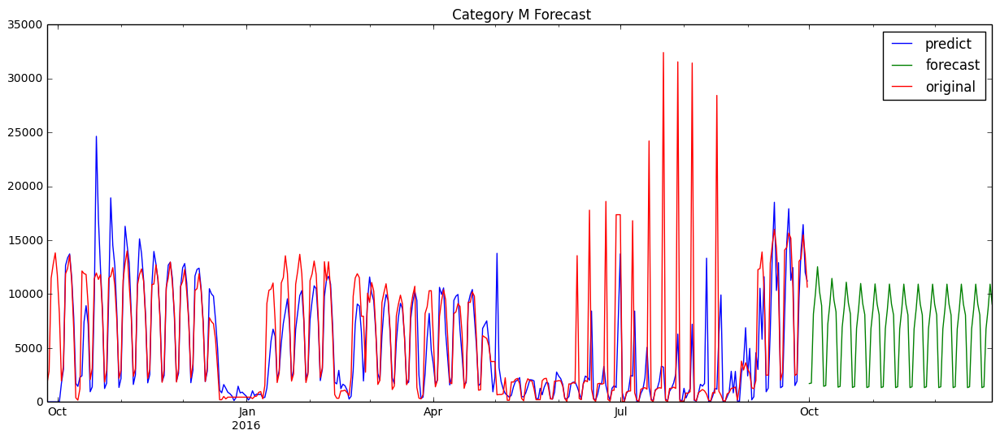

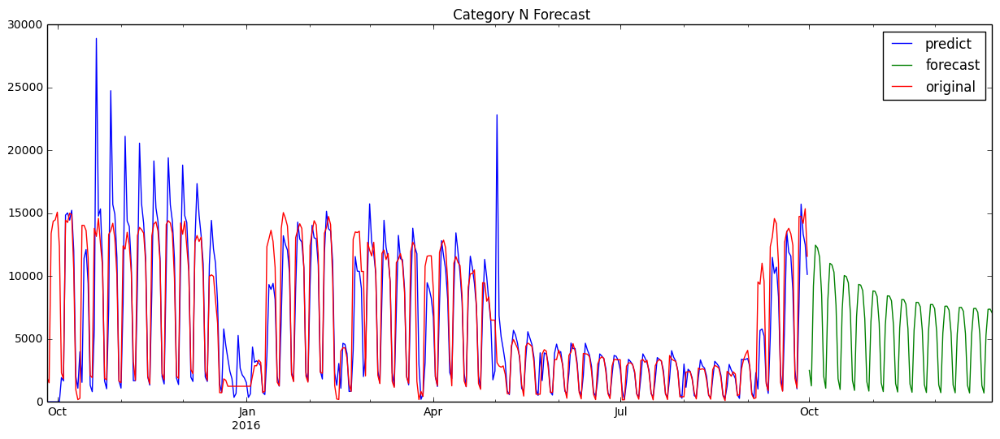

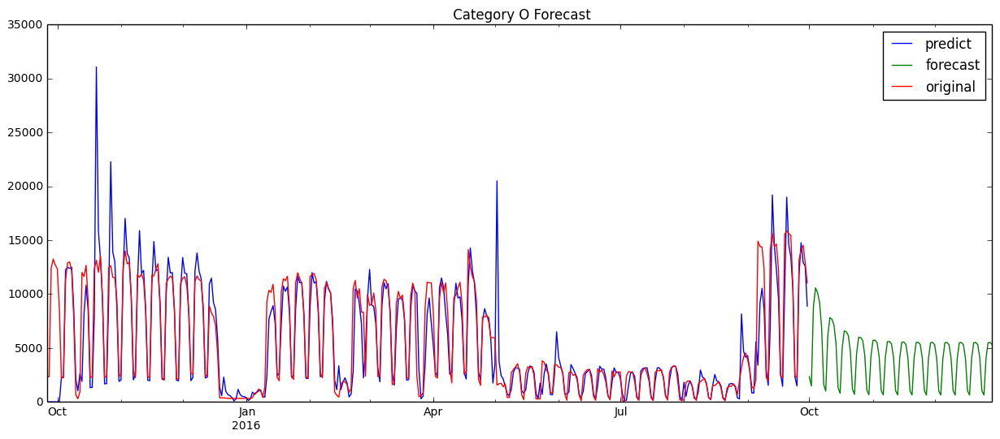

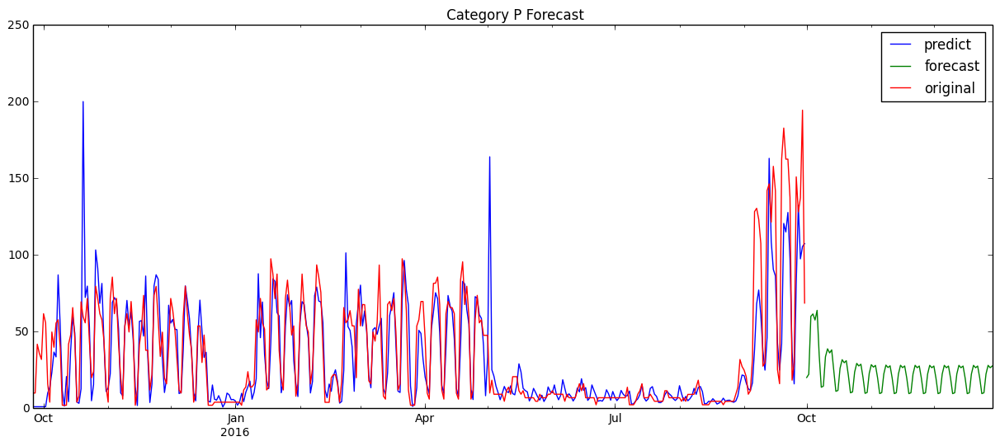

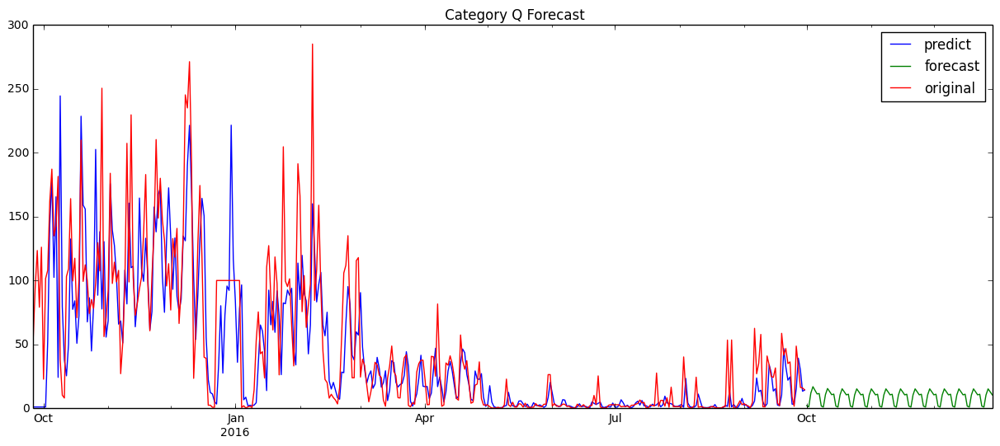

In [81]:
pred_log = map(plot_forecast, result_log, splitted_data, temp_list)

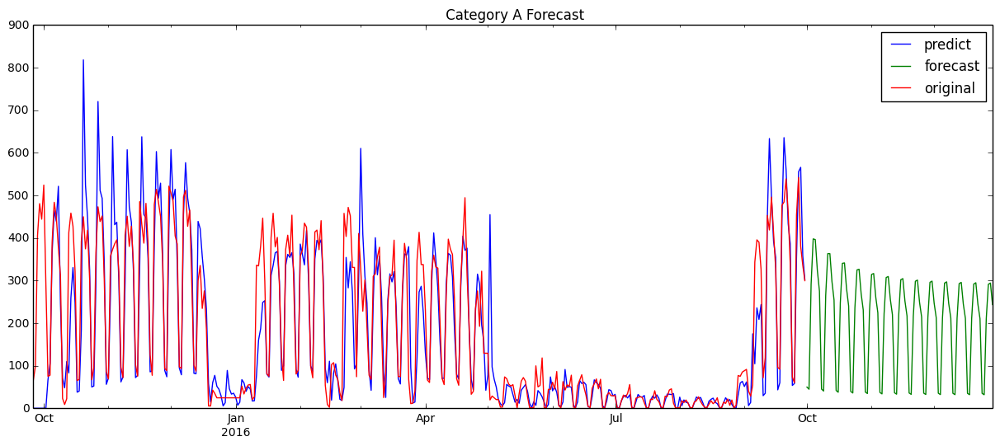

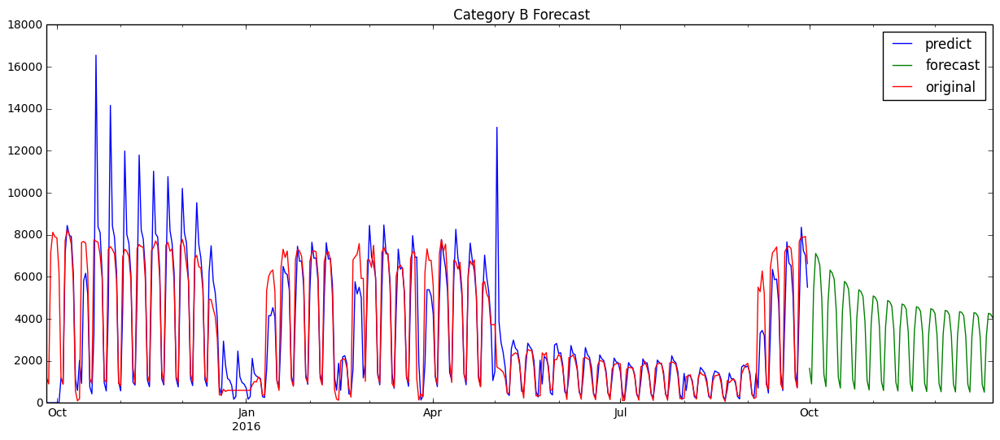

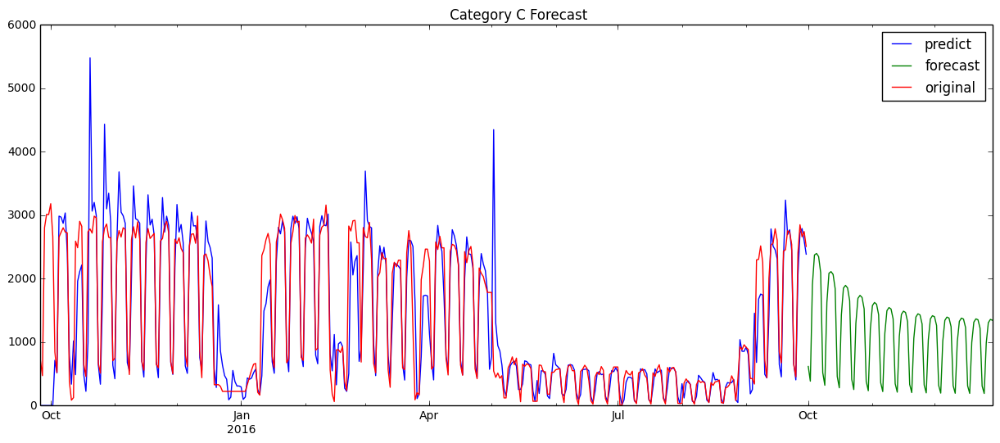

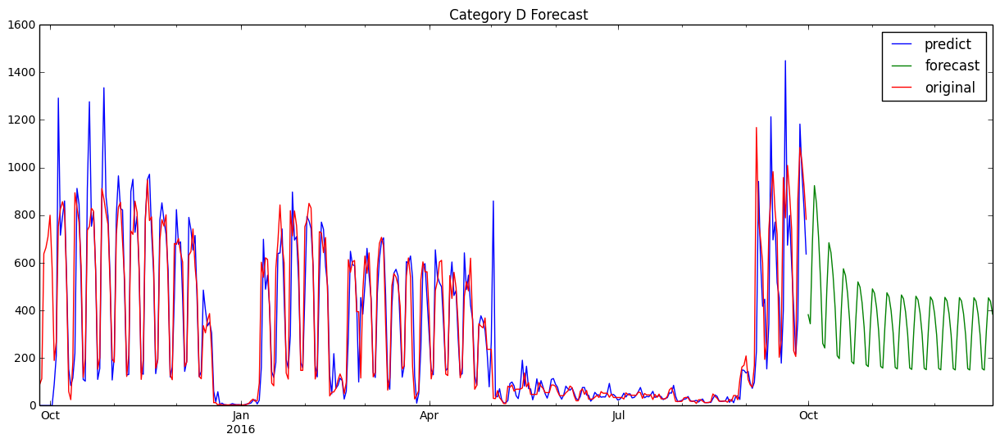

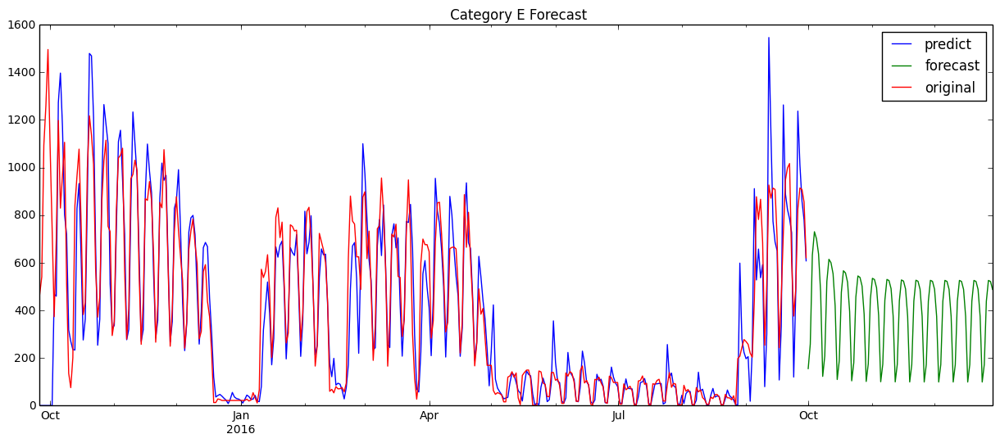

...

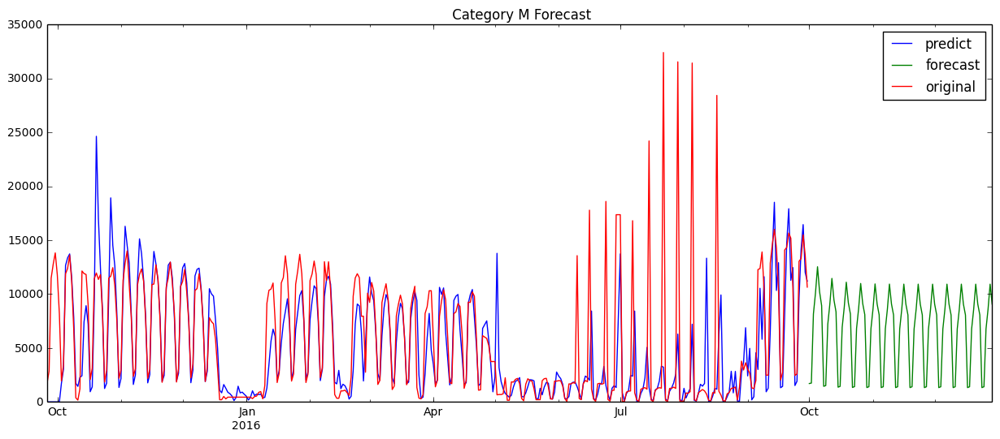

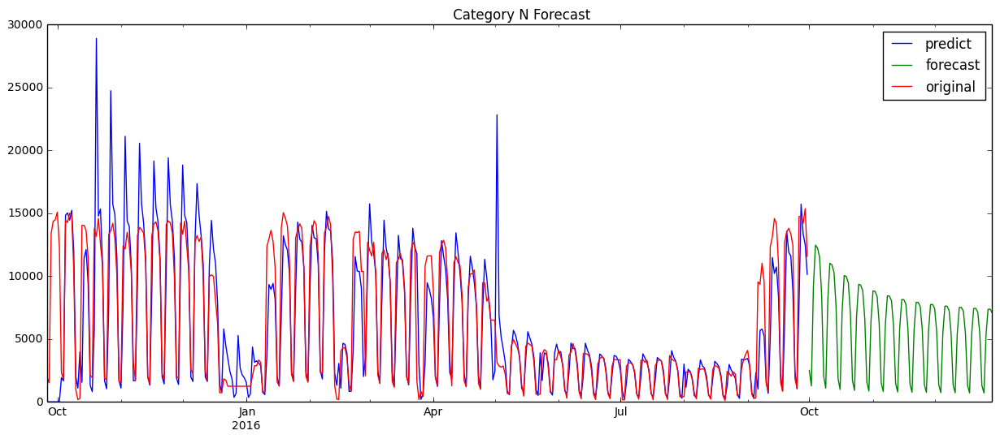

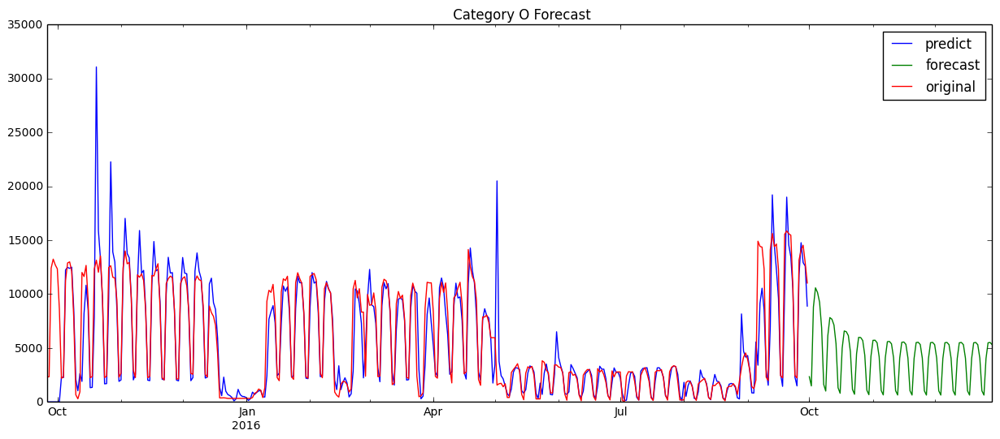

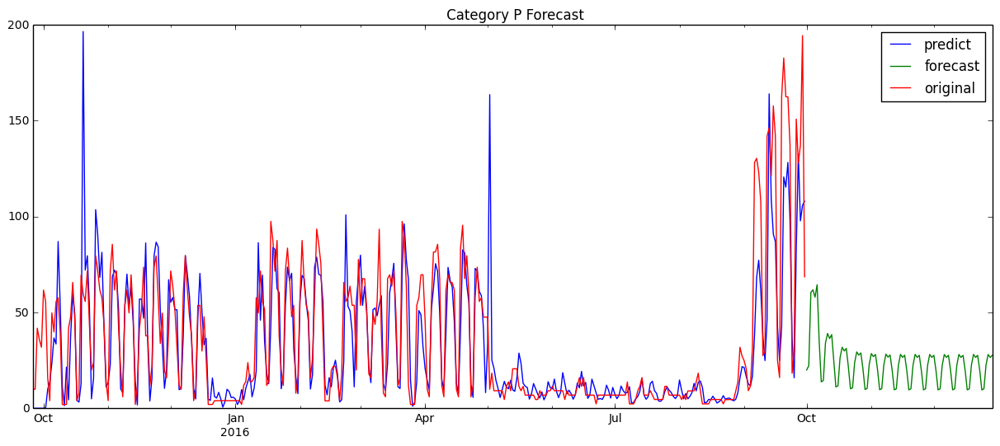

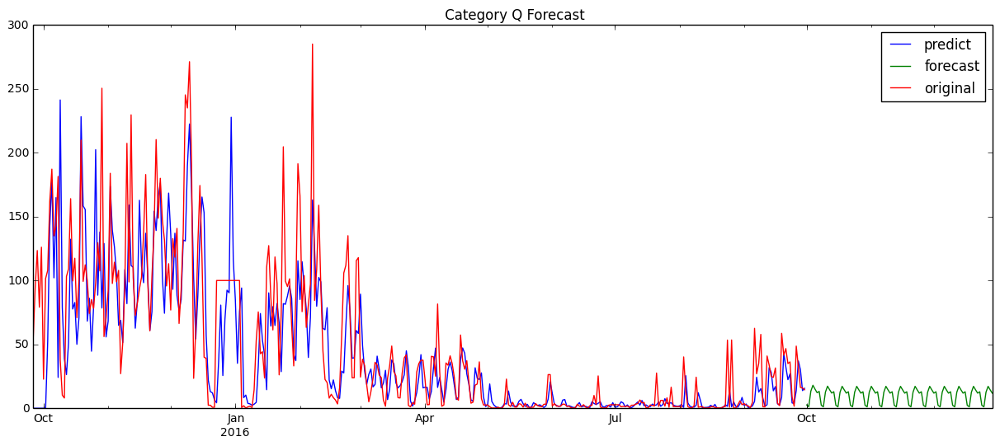

In [83]:
pred_inv = map(plot_forecast, results_inv, splitted_data, temp_list)

In [87]:
# Report performance
def rmse_measurement(timeseries, pred, item):
    mse = mean_squared_error(timeseries, pred)
    rmse = sqrt(mse)
#     print('Category {} - RMSE: %.3f'.format(item) % rmse)
    return rmse

In [88]:
rmse_total_obs = map(rmse_measurement, splitted_data, pred_obs, temp_list)
rmse_total_log = map(rmse_measurement, splitted_data, pred_log, temp_list)
rmse_total_inv = map(rmse_measurement, splitted_data, pred_inv, temp_list)

In [89]:
print 'Total RMSE Obs: ', np.sum(rmse_total_obs)
print 'Total RMSE Log: ', np.sum(rmse_total_inv)
print 'Total RMSE Inv: ', np.sum(rmse_total_inv)

Total RMSE Obs:  16890.4494283
Total RMSE Log:  21425.9535846
Total RMSE Inv:  21425.9535846


# Total Forecast

In [98]:
forecast_obs = map(lambda x: x.forecast(steps=90), results_obs)
forecast_log = map(lambda x: np.exp(x.forecast(steps=90)), results_log)
forecast_inv = map(lambda x: np.sinh(x.forecast(steps=90)), results_inv)

In [92]:
def total_forecast(forecast_90):
    total_forecast = pd.Series()
    original_sales = pd.Series()
    for i, df in enumerate(forecast_90):
        if i == 0:
            total_forecast = df
            original_sales = splitted_data[i]
        else:
            total_forecast = total_forecast + df
            original_sales = original_sales + splitted_data[i]

    plt.plot(original_sales.index, original_sales, '-o')
    plt.plot(total_forecast.index, total_forecast, '-o')

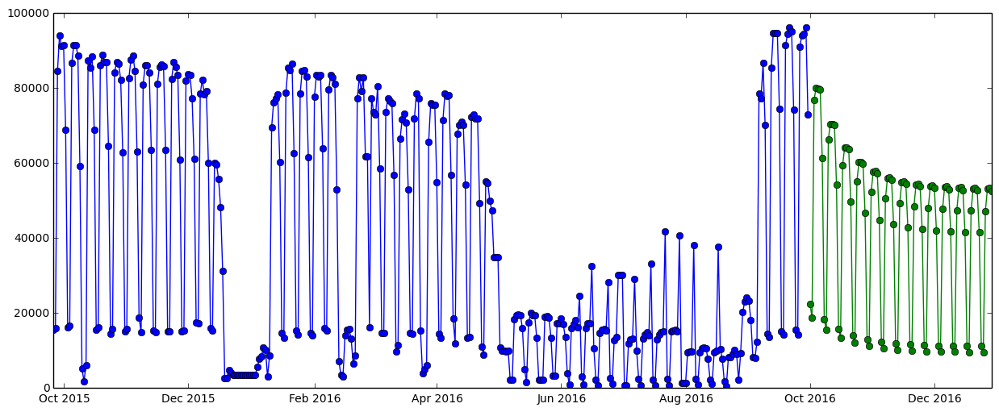

In [95]:
total_forecast(forecast_obs)

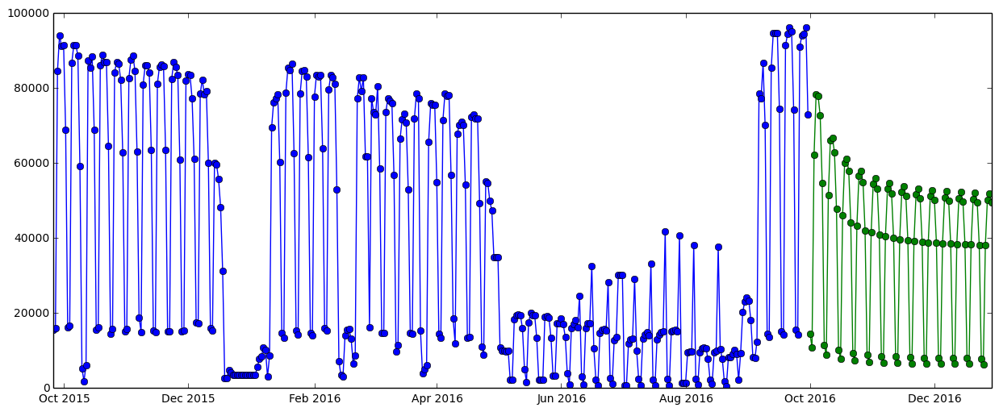

In [99]:
total_forecast(forecast_log)

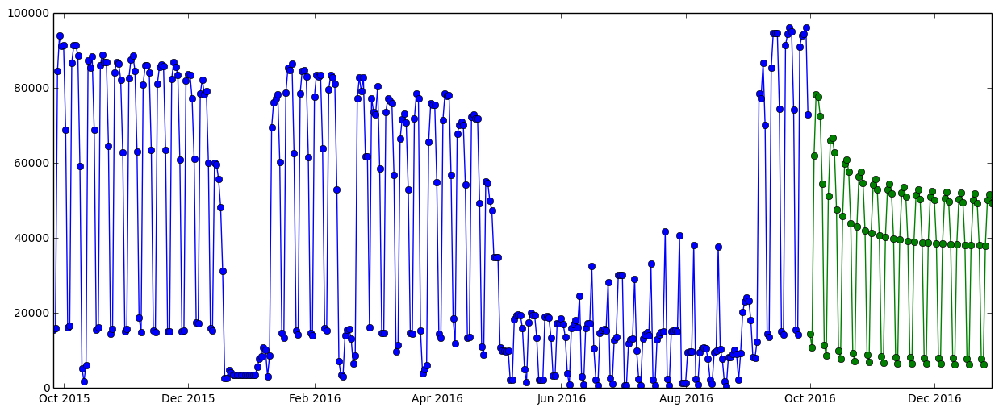

In [100]:
total_forecast(forecast_inv)

In [ ]:
def relative_cont_plot(forecast_90, item):
    category = forecast_90 / total_forecast
#     print 'Category {}: '.format(item), category.mean()
    if category.mean() >= 0.08:
        print 'Category {} Sales Contribution: '.format(item), category.mean()
    _ = plt.plot(category.index, category, '-o', label=item)
    _ = plt.legend(loc='right')
    _ = plt.title('Relative Contribution from Each Category')

print 'Top contributors are...'
_ = map(relative_cont_plot, forecast_90, temp_list)

# Top Down Approach - Build Model and Forecast on All Categories.

In [102]:
original_sales = pd.Series()
for i, df in enumerate(splitted_data):
    if i == 0:
        original_sales = splitted_data[i]
    else:
        original_sales = original_sales + splitted_data[i]

In [103]:
print original_sales.head()
idx = pd.date_range('09-26-2015', '09-30-2016')    

original_sales.index = pd.DatetimeIndex(original_sales.index)
original_sales = original_sales.reindex(idx, fill_value=0)
print original_sales.shape, '-', original_sales.index

print '\n', original_sales.head()

2015-09-26    15537.95
2015-09-27    16093.33
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64
(371,) - DatetimeIndex(['2015-09-26', '2015-09-27', '2015-09-28', '2015-09-29',
               '2015-09-30', '2015-10-01', '2015-10-02', '2015-10-03',
               '2015-10-04', '2015-10-05',
               ...
               '2016-09-21', '2016-09-22', '2016-09-23', '2016-09-24',
               '2016-09-25', '2016-09-26', '2016-09-27', '2016-09-28',
               '2016-09-29', '2016-09-30'],
              dtype='datetime64[ns]', length=371, freq='D')

2015-09-26    15537.95
2015-09-27    16093.33
2015-09-28    84535.83
2015-09-29    94145.18
2015-09-30    91173.07
Freq: D, Name: sales, dtype: float64


In [119]:
inversed_sales = np.arcsinh(original_sales)

In [120]:
total_forecast_inversed = model_building(inversed_sales, 'Total')

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=904.619
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=898.663
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=910.275
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=881.862


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=883.234
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=908.716
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=882.027


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=882.056
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=814.994
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=760.583
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=750.012
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=782.678
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=742.665


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=743.931
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=769.861
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=742.851


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=744.918
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=777.618
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=696.931
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=692.867
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=728.561
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=688.875
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=689.666
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=712.367
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=686.191


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=688.208
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=751.552
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=618.504
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=616.357
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=688.195
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=615.893


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=617.729
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=651.321
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=617.238


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=619.173
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=749.136
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=606.832
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=605.755
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=678.919
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=605.243


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=606.991
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=641.461
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=606.020


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=608.446
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=750.171
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=606.898
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=605.846
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=680.442
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=605.492


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=607.430
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=643.441
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=606.706


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=609.083
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=748.607
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=609.163
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=608.024
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=678.315
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=607.448


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=609.152
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=641.689
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=608.051


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=609.925
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=750.558
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=605.690
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=604.512
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=680.315
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=604.179


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=606.146
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=643.432


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=605.526


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=607.544
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=748.557
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=607.626


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=606.331
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=682.617


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=605.947


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=607.996


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=645.434


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=607.213


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=609.288
Best SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=604.179
Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(2, 0, 1)x(1, 1, 1, 7)   Log Likelihood                -296.090
Date:                           Sun, 26 Feb 2017   AIC                            604.179
Time:                                   23:00:24   BIC                            627.677
Sample:                               09-26-2015   HQIC                           613.512
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.3

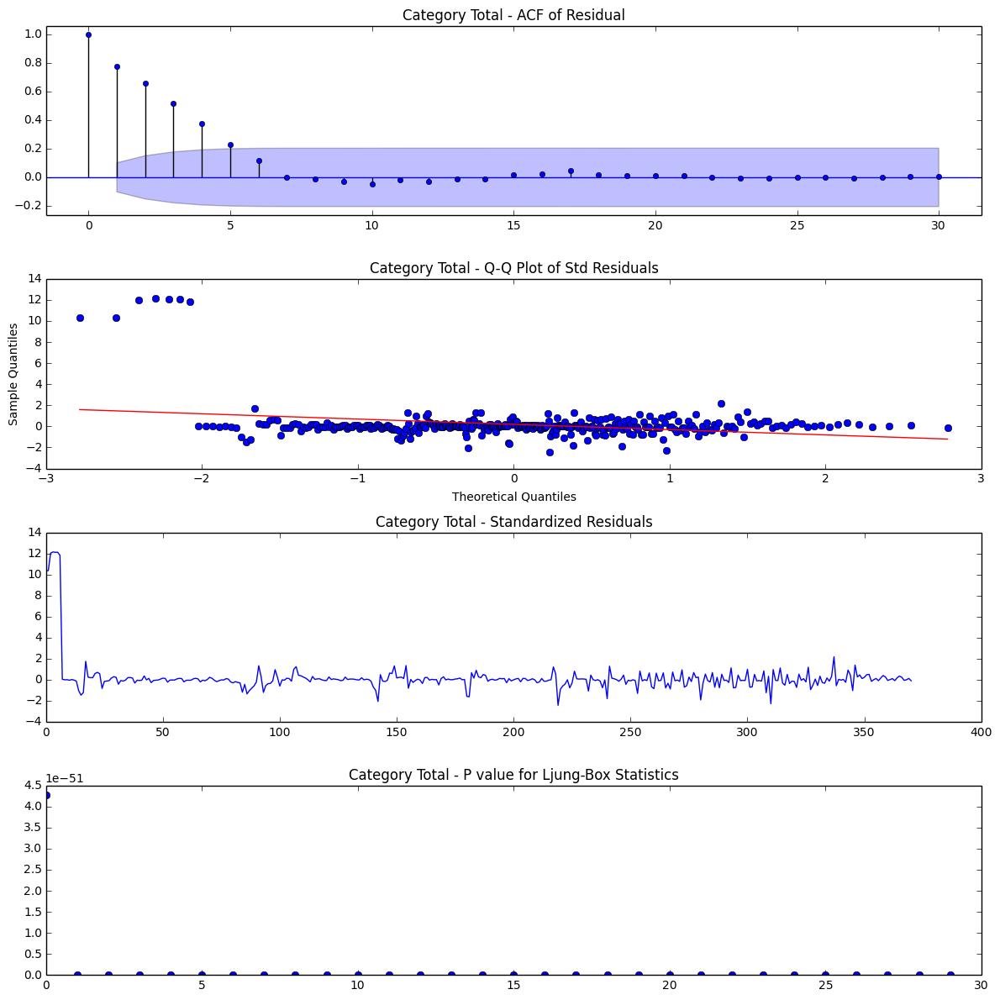

In [121]:
residual_analysis(get_residuals(total_forecast_inversed), 'Total')

In [ ]:
total_forecast(forecast_inv)

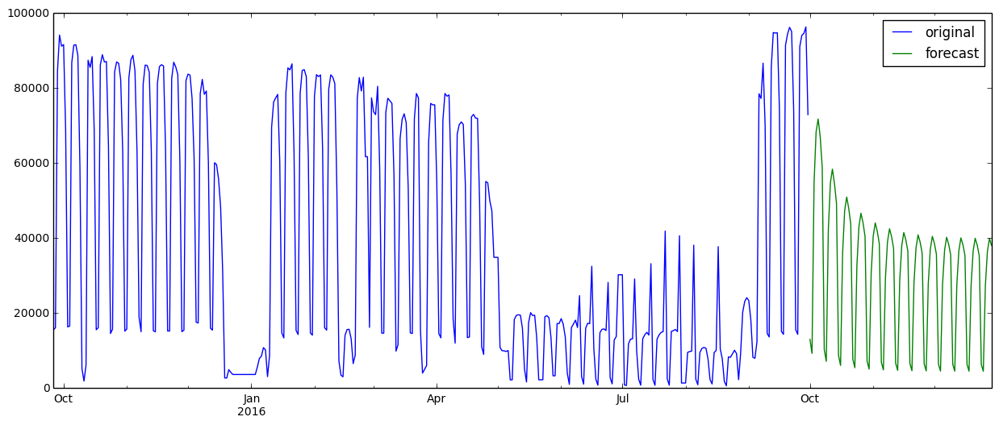

In [123]:
total_pred_inversed = np.sinh(total_forecast_inversed.predict())
forecast_90_inversed = np.sinh(total_forecast_inversed.forecast(steps=90))

# total_pred_inversed.plot(label='pred')
original_sales.plot(label='original')
forecast_90_inversed.plot(label='forecast')
plt.legend()

In [124]:
total_forecast = model_building(original_sales, 'Total')

could not broadcast input array from shape (0,0) into shape (7,7)
SARIMA(0, 0, 0) (0, 1, 1, 7) AIC=8249.187
SARIMA(0, 0, 0) (0, 1, 2, 7) AIC=8247.955
SARIMA(0, 0, 0) (1, 1, 0, 7) AIC=8250.681
SARIMA(0, 0, 0) (1, 1, 1, 7) AIC=8224.328


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 0) (1, 1, 2, 7) AIC=8226.814
SARIMA(0, 0, 0) (2, 1, 0, 7) AIC=8250.249
SARIMA(0, 0, 0) (2, 1, 1, 7) AIC=8226.111
SARIMA(0, 0, 0) (2, 1, 2, 7) AIC=8230.485
SARIMA(0, 0, 1) (0, 1, 0, 7) AIC=8118.410
SARIMA(0, 0, 1) (0, 1, 1, 7) AIC=8098.650
SARIMA(0, 0, 1) (0, 1, 2, 7) AIC=8093.874
SARIMA(0, 0, 1) (1, 1, 0, 7) AIC=8104.347
SARIMA(0, 0, 1) (1, 1, 1, 7) AIC=8082.794


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (1, 1, 2, 7) AIC=8080.657
SARIMA(0, 0, 1) (2, 1, 0, 7) AIC=8099.485
SARIMA(0, 0, 1) (2, 1, 1, 7) AIC=8083.586


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(0, 0, 1) (2, 1, 2, 7) AIC=8085.694
SARIMA(0, 0, 2) (0, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (0, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (1, 1, 2, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 0, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 1, 7) AIC=nan
SARIMA(0, 0, 2) (2, 1, 2, 7) AIC=nan
SARIMA(1, 0, 0) (0, 1, 0, 7) AIC=8044.044
SARIMA(1, 0, 0) (0, 1, 1, 7) AIC=7998.646
SARIMA(1, 0, 0) (0, 1, 2, 7) AIC=7990.101
SARIMA(1, 0, 0) (1, 1, 0, 7) AIC=8014.026
SARIMA(1, 0, 0) (1, 1, 1, 7) AIC=7980.194


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=7978.096
SARIMA(1, 0, 0) (2, 1, 0, 7) AIC=8004.402
SARIMA(1, 0, 0) (2, 1, 1, 7) AIC=7980.114


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 0) (2, 1, 2, 7) AIC=7982.179
SARIMA(1, 0, 1) (0, 1, 0, 7) AIC=8045.661
SARIMA(1, 0, 1) (0, 1, 1, 7) AIC=8000.828
SARIMA(1, 0, 1) (0, 1, 2, 7) AIC=7992.335
SARIMA(1, 0, 1) (1, 1, 0, 7) AIC=8015.877
SARIMA(1, 0, 1) (1, 1, 1, 7) AIC=7982.503


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (1, 1, 2, 7) AIC=7983.171
SARIMA(1, 0, 1) (2, 1, 0, 7) AIC=8006.560
SARIMA(1, 0, 1) (2, 1, 1, 7) AIC=7982.418


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 1) (2, 1, 2, 7) AIC=7984.463
SARIMA(1, 0, 2) (0, 1, 0, 7) AIC=8046.992
SARIMA(1, 0, 2) (0, 1, 1, 7) AIC=8002.854
SARIMA(1, 0, 2) (0, 1, 2, 7) AIC=7994.332
SARIMA(1, 0, 2) (1, 1, 0, 7) AIC=8018.057
SARIMA(1, 0, 2) (1, 1, 1, 7) AIC=7985.035


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (1, 1, 2, 7) AIC=7986.491
SARIMA(1, 0, 2) (2, 1, 0, 7) AIC=8008.767
SARIMA(1, 0, 2) (2, 1, 1, 7) AIC=7984.975


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(1, 0, 2) (2, 1, 2, 7) AIC=7987.010
SARIMA(2, 0, 0) (0, 1, 0, 7) AIC=8045.658
SARIMA(2, 0, 0) (0, 1, 1, 7) AIC=8000.607
SARIMA(2, 0, 0) (0, 1, 2, 7) AIC=7992.047
SARIMA(2, 0, 0) (1, 1, 0, 7) AIC=8015.734
SARIMA(2, 0, 0) (1, 1, 1, 7) AIC=7982.129


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (1, 1, 2, 7) AIC=7983.565
SARIMA(2, 0, 0) (2, 1, 0, 7) AIC=8006.360
SARIMA(2, 0, 0) (2, 1, 1, 7) AIC=7982.026


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 0) (2, 1, 2, 7) AIC=7984.096
SARIMA(2, 0, 1) (0, 1, 0, 7) AIC=8047.579
SARIMA(2, 0, 1) (0, 1, 1, 7) AIC=8002.783
SARIMA(2, 0, 1) (0, 1, 2, 7) AIC=7994.131
SARIMA(2, 0, 1) (1, 1, 0, 7) AIC=8017.854
SARIMA(2, 0, 1) (1, 1, 1, 7) AIC=7984.482
SARIMA(2, 0, 1) (1, 1, 2, 7) AIC=7985.836
SARIMA(2, 0, 1) (2, 1, 0, 7) AIC=8008.531
SARIMA(2, 0, 1) (2, 1, 1, 7) AIC=7984.418


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 1) (2, 1, 2, 7) AIC=7986.484
SARIMA(2, 0, 2) (0, 1, 0, 7) AIC=8043.380
SARIMA(2, 0, 2) (0, 1, 1, 7) AIC=8003.072
SARIMA(2, 0, 2) (0, 1, 2, 7) AIC=7991.925
SARIMA(2, 0, 2) (1, 1, 0, 7) AIC=8019.808


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 1, 7) AIC=7983.954


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (1, 1, 2, 7) AIC=7985.595
SARIMA(2, 0, 2) (2, 1, 0, 7) AIC=8010.399


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 1, 7) AIC=7984.693


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


SARIMA(2, 0, 2) (2, 1, 2, 7) AIC=7986.752
Best SARIMA(1, 0, 0) (1, 1, 2, 7) AIC=7978.096


/Library/Python/2.7/site-packages/statsmodels/base/model.py:496: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


Category Total:                                   Statespace Model Results                                
Dep. Variable:                             sales   No. Observations:                  371
Model:             SARIMAX(1, 0, 0)x(1, 1, 2, 7)   Log Likelihood               -3984.048
Date:                           Sun, 26 Feb 2017   AIC                           7978.096
Time:                                   23:03:23   BIC                           7997.677
Sample:                               09-26-2015   HQIC                          7985.873
                                    - 09-30-2016                                         
Covariance Type:                             opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.7781      0.028     27.654      0.000       0.723       0.833
ar.S.L7        0.5383     

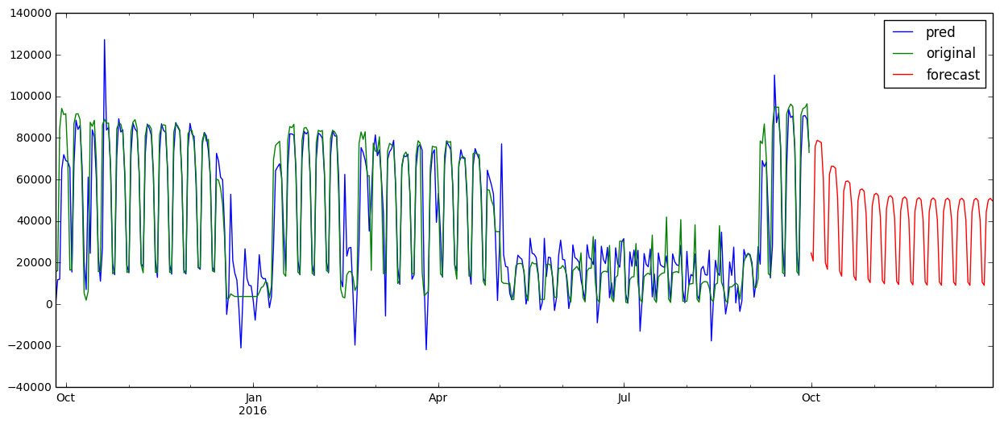

In [125]:
total_pred = total_forecast.predict()
forecast_90 = total_forecast.forecast(steps=90)

total_pred.plot(label='pred')
original_sales.plot(label='original')
forecast_90.plot(label='forecast')
plt.legend()

In [127]:
print 'Observed: ', rmse_measurement(original_sales, total_pred, 'Total')
print 'Inversed: ', rmse_measurement(original_sales, total_pred_inversed, 'Total')

Observed:  14352.9738171
Inversed:  17804.5435246


# Summary
## 1) Statistical tests suggest
### - We have lags and seasonal effects in the data
### - So we need to use seasonal ARIMA model as opposed to regular ARIMA model
### - The SARIMA models for each category will be slightly different, but shouldn't deviate too much from order 1
## 2) SARIMA models were used for forecasting each category
### - Category E: (1, 1, 1)x(0, 1, 1, 7)
### - Category M: (0, 1, 1)x(1, 1, 1, 7)
### - All other categories: (1, 1, 1)x(1, 1, 1, 7)
## 3) We also used a top down approach (directly forecast without breaking down the categories)
### - Top down approach (RMSE=14,958)
### - Bottom up approach (RMSE=17,118)
### - Seems like top down was able to generalize the time series better, it's interesting because one would expect the opposite
### - But it could be the top down method is overfitting, so further validation is needed.
## 4) What could be improved?
### - More data: if we have 5 years of data, we can definitely build more accurate models.
### - More features: we could use weather data to see how climate affects sales in diff categories
### - More features: also features like promotion or not, number of competitors nearby would also help
### - Diff models: we could try xgboost